In [13]:
from pathlib import Path
from os import listdir
from os.path import isfile, join
from pybeerxml import Parser
import sys
import pandas as pd
import numpy as np
import re
from matplotlib import pyplot as plt
sys.path.append('../')
from brewgen.backend.models import grain

In [45]:
rewrites = [
    {
        'name': 'Goldpils Vienna Malt',
        'match': "^.*(Goldpils|Vienna.*US|US.*Vienna|Briess.*Vienna|Vienna.*Briess).*$",
        'max_color': 6
    },
    # Weyermann as the catchall for Vienna
    {
        'name': 'Weyermann Vienna Malt',
        'match': '^.*Vienna.*$',
        'max_color': 6
    }, {
        'name': 'Weyermann Munich Malt I',
        "match": '^.*Munich.*$',
        'max_color': 7
    },
    {
        'name': 'Weyermann Munich Malt II',
        "match": '^.*Munich.*$',
        'max_color': 9.9
    },
    {
        'name': 'Munich Malt 10L',
        "match": '^.*Munich.*$',
        'max_color': 11
    },
    {
        'name': 'Munich Malt 20L',
        "match": '^.*Munich.*$',
        'max_color': 21
    },
    {
        'name': "Brewer's Malt",
        'match': '^.*(2|Two)(-| )Row.*$',
        'max_color': 2
    },
    # No sensory available for Maris Otter so lumping that in with Pale Ale Malt
    {
        'name': "Pale Ale Malt",
        'match': '^.(Pale Ale|Maris)*$',
        'max_color': 5
    },
    {
        'name': "Carapils Malt",
        'match': '^.*(US.*Carapils|Carapils.*US|Carapils.*Briess|Briess.*Carapils).*$',
        'max_color': 5
    },
    # Weyermann as the catchall for Carapils
    {
        'name': "Weyermann Carapils",
        'match': '^.*(Carapils).*$',
        'max_color': 5
    },
    {
        'name': "Pilsen Malt",
        'match': '^.*(Pilsen|US.*Pilsner|Pilsner.*US).*$',
        'max_color': 3
    },
    # Weyermann as the catchall for Pilsner
    {
        'name': "Weyermann Pilsner Malt",
        'match': '^.*Pilsner.*$',
        'max_color': 3
    }
]

# Add rewrites for each Crystal malt
for lov in [10, 20, 30, 40, 60, 80, 90, 120]:
    rewrites.append({
        'name': 'Caramel Malt {}L'.format(lov),
        'match': '^.*(Caramel|Crystal).*{}.*$'.format(lov)
    })

In [46]:
# Get all recipe paths
beerxml_list = list(Path("./brewtoad_scrape").rglob("*.xml"))

In [47]:
parser = Parser()
recipe_db = []

In [44]:
# Create a list of all fermentables in all recipes
fermentables = []
for beerxml_file in beerxml_list:
    try:
        recipes = parser.parse('./{}'.format(str(beerxml_file)))
    except:
        print("Failed to parse ./{}".format(str(beerxml_file)))
        recipes = []
    
    for recipe in recipes:
        try:  
            total_amount = sum(
                fermentable.amount for fermentable in recipe.fermentables)
            for fermentable in recipe.fermentables:
                fermentable_name = fermentable.name
                # Remove all LME/DME
                extract = re.match("^.*(DME|LME|Extract).*$", fermentable_name)
                if extract:
                    print('Skipping extract: {}'.format(fermentable_name))
                    continue
                
                for rule in rewrites:
                    match = re.match(rule['match'], fermentable.name)
                    if match and fermentable.color <= rule.get('max_color', 100):
                        print('Rewriting {} -> {}'.format(fermentable_name, rule['name']))
                        fermentable_name = rule['name']
                        break
                
                fermentables.append({
                    'name': fermentable_name,
                    'percent': fermentable.amount / total_amount * 100,
                    'color': fermentable.color,
                    'ppg': fermentable.ppg,
                    'addition': fermentable.addition,
                })
        except:
            print("Failed to parse recipe in ./{}".format(str(beerxml_file)))

Failed to parse recipe in ./brewtoad_scrape/recipes/english-dark-mild/recipe.xml
Skipping extract: Dry Malt Extract - Pale	
Skipping extract: Liquid Malt Extract - Rye
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/apple-rye-ale-65c61d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/duchesse-elizabeth/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-patricks-milk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/erics-tico-cerveza/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wa-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/doc-browns-ale-ment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/britanis-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munchen-grobes-helles-lager-from-brewing-classic-styles-4/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/alex-and-ani/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-baltic-porter-2/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/why-pa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cleveland-brown-2/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sunset-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-pale-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-double-ipa-clone-kern-river-brewing-company-cybi-podcast-version-38b131/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mean-field-maibock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-hoppy-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-belgia

Failed to parse recipe in ./brewtoad_scrape/recipes/c-bomb-2-0-new-england-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/butterbeer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-irish-stout-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/m-rzenbier/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-barrel-af160d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gem-tlichkeit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hop-nugget-pale-ale-eb76fb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/injection-brown-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lawnmower-beer-v1-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-gf-ale-b1ed45/recipe.xml
Fail

Skipping extract: Northern Brewer Rye LME
Failed to parse recipe in ./brewtoad_scrape/recipes/roggenrauch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-wheat-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-mambo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doppelg-nger-hopfen/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/adnams-bitter-dave-line-2011-03-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/protein-orange-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/marbury-ipa-spring15/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jerome-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farnshaus-1/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light 

Failed to parse recipe in ./brewtoad_scrape/recipes/enjoy-by-triple-clone/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-bastard-2008-10-15-version-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gila-monster/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-pale-ale-5g-extract-0227e2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-is-coming-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-2-honey-voss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krabbekoker-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/june2015hefeweizen10gl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stella-claus-porter-b902b3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/love

Failed to parse recipe in ./brewtoad_scrape/recipes/whos-your-taddy-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tongue-twister-english-strong-bit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sn-celeb-clone/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/resiny-hip-hop-bomb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vesuvius-v02-dead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alyona-l/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/college/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wolves-ginger-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-eye-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-pale-ale-10/recipe.xml
Failed to parse recipe in ./brewtoad_scr

Skipping extract: Extra Light Malt Extract
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-2013/recipe.xml
Skipping extract: Amber DME
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-4/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/punch-you-in-the-eye-pa-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-ipa-actual/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-blonde-xxx-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-v-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarzbier-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/broken-glass-belgian-blonde-sept-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lag-sucks-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xmas-6/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/angkur-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winterfell-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jax-s-honey-small/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/early-winter-summer-revival/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2012-scottish-ale-bourbond/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krampus-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-blonde-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barley-wine-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fakedra-phaedra-belgian-rye-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-mean-galene-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-cat-double-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/just-ipa/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/0014-grapefruit-bomb-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ilmarisen-ohra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/south-of-the-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-potato-quinoa-ale/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-along-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/springtime-pale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tiger-ginger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apophis/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-galaxy-standard/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snow-shovel-6c1a37/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/club-wheat-tea-experiment/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dead-ringer-ipa-6e3a7b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-bipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-stout-35/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alinga/recipe.xml
Skipping extract: Breiss Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-coffee-stout-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mana-potion-ipa-ver4/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Light Dry Malt Extract
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-2-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juicebox-ipa-30-galaxy-simcoe-nelson-sauvin/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/sorachi-ace-ipa-23c253/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-saison-3/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cap-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/h-and-w-smoked-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/delicia-cremosa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deschutes-red-chair/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yard-work-ipa/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/222-irish-ale/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/turbinado-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beezles-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/exodus-amber-ale/recipe.xml
Failed to par

Failed to parse recipe in ./brewtoad_scrape/recipes/colonial-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7-am-kickoff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-on-pop-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-stout-1/recipe.xml
Skipping extract: Dry Extra Malt Light Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/odie-odie-drinkin-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pierre-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-f07cd5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/75-belgian-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-v1-a1527f/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sheldon-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-15/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/dogfish-head-palo-santo-clone-attempt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beebops-sockhop-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marrick-milk-stout/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/first-draft-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-huh-weit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hog-wild-batch-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/columbus-lite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/forest-king-iiba/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Dark
Failed to par

Failed to parse recipe in ./brewtoad_scrape/recipes/cway-mild-temperament/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pkb/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Pilsen Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-honey-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boundary-creek-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-ale-141/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/f-ltchen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-wookey-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-flama-negra-all-grain-2d41c0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcs-cream-ale-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bacon-maple-ale-1/recipe.xml
Skipping extract: Golden Li

Failed to parse recipe in ./brewtoad_scrape/recipes/alaskan-amber-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/copper-ale-mini/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-mango-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wild-willy-ale/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-2010-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/son-that-dogd-bite-you/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-c-session-ipa-25db72/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/troisieme-pumpkin-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/van-dammeii-strg-dk-belgian-1-18/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/ypres/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-17-at-20-13-20-utc/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-summer-ale-7a5a95/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wlp644-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmer-saison-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-your-father-s-sumac-ade-2-5g-all-grain/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Breiss Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sp-brewery-ssos-imperial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-cream-ale-173626/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brooklyn-bourbon-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ww

Failed to parse recipe in ./brewtoad_scrape/recipes/full-moon-071214/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-fangle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wheat-cascade-single-hop/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/full-moon-1gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-lite-lager-50l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-hearted-clone-ish/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-rye-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-english-barleywine-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nutella-stout-5c4adc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-ipa-ii-d134ea/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Plain Dark DME
Failed to p

Failed to parse recipe in ./brewtoad_scrape/recipes/lager-black/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cottontown-brown-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-10-22-at-10-53-54-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-basil-saison-688dc3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-hops-and-no-malt-make-beer-a-dull-drink/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-spicy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jens-brickhouse-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-06a253/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dreaded-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/back-breaker-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-breakfast-sto

Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-d1c704/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gentlemen-s-series-oak-aged-russian-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bw-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/laurel-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/manook/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-bourbon-barrel-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-for-club-barrel-spring-2016-676732/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cucurbito-pepo-pumpkin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/espresso-browned-stout-754c38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-97cf0b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/founders-centennial-ipa-clone-1/recipe.xml
Failed to parse recipe in ./brew

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-307/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mini-batch-robust-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-barrel-stout-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dubbel-byo-com-converted-to-3-gallon-ef3baa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/get-funked/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/atlambic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-porter-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/halfcock-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopshed-cask-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/k-lsch-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/feb-2018-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pie-crust-2ae3fa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/post-op-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citrapamarillo/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-zuckle-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ill-be-bock-8/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-big-red-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2014-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/c-r-e-a-m/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-dune-blonde-ale/recipe.xml
Skipping extract: Li

Failed to parse recipe in ./brewtoad_scrape/recipes/b-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-cream-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eye-pee-yay-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stevens-brewing-company-the-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fugginay-ipa-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sage-and-juniper-smoked/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/babos-ipa-2/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-red-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jack-r-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/portaberry-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-quick-one/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/generic-belgian-blond/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/no5-53/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-maris-otter-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-watch-comp-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/franz-beligian-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-du-bonnibel/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/lme-apa-02/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-potato-ale-3b1c6a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/comet-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/texas-rangers-world-series-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yippie-i-oh-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dipa-7e4438/recipe.xml
Failed to parse recipe in 

Failed to parse recipe in ./brewtoad_scrape/recipes/porter-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-magic-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wylde-codswallop-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-ipa-8bb231/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kbs-clone-6a310a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wild-boys-brewery-azacca-centenntial-ipa/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-ale-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-is-winter-still-here-0c4812/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-brown-1gallon-a02a29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-kolsch-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apricot-wheat-26/recipe.xml
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/bandito-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tankhouse-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-118/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7-8-13-smash-pale-centennial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-kern-river-cybi-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgy-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-ipa-47/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/joe-monroe-oatmeal-milk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/condorman/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/standard-saison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leisure-suit-larry-braggot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2

Failed to parse recipe in ./brewtoad_scrape/recipes/ubermensch-wheat-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/das-septemberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wit-ea275d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kevins-longshot/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Skipping extract: Sparkling Amber DME
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/brewcifer-barleywine/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/relic-ipa-2bcda4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sn-ruthless-rye-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-saison-ii-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/little-brother-ipa2/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/platinum-blonde-lemondrop-ipa/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/i-haas-the-fair-fever/recipe.xml
Skipping extract: Gold LME
Skipping extract: Weizen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ted-193f82/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rasputin-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/traditional-ipa-dos/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-447351/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/big-smile-ipa-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/coop-crisp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/acorn-squash-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saint-stephen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-sour/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eggys-session-pale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-w-left-over-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconers-revenge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rca-variant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10-gallon-belgian-pair-8ab792/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tree-house-julius-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gunterbrau-hops-to-knock-your-boc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/daz-bog-latte-imperial-stout/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/the-friendship-laser/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/phetchaburi-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/portland-brewers-origanal-ipa/recipe.xml
Skipping extract: Plain Extra Light DME
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-172974/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-summer-saison-f31c3b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/w6-dr3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mead-1-3d09d6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-51ae51/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1gal-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanport-city-brewings-new-columbi/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/sabrinas-raspberry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wrightwain/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-682/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-darkness-2018-och/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deschutes-jubelale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/michigan-cascade-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-boyz-brew-1559c3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/drool-in-the-crown-mark-2/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/totem-pole-ipa/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-stout/recipe.xml
Skipping ext

Failed to parse recipe in ./brewtoad_scrape/recipes/flanders-ned-kettle-soured-rodenbach-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-45l-op-dec-2012/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/heavy-handed-ipa-39b1eb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/superior-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frodiben-brud/recipe.xml
Skipping extract: Wheat DME
Skipping extract: Dry Rice Extract
Skipping extract: Bavarian Wheat DME
Skipping extract: Briess Pilsen DME
Failed to parse recipe in ./brewtoad_scrape/recipes/southern-brown-1/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hegaarden-witerbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-pale-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweisse/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/daves-coffee-stout-4-26-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sorachi-saison-4/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/15-minute-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-de-noel-nb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-apa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-porter-nhc-2012-winner-combined-w-suggestions-from-hbt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-goose-island-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/og-fg-eficcience-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-f7bad0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/forefathers-spruce-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/machismo-big-batch-0c4535/recipe.xml
Faile

Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/18-amberdextrous-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bud-right/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-eriks-demise/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-pale-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/time-of-the-saison-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-malts-one-hop/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/book-honey-porter-1-627dc9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/benchmark-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-09-at-20-00-20-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-2015-ipa/recipe.xml
Fail

Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/plain-n-simple/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lord-crouchbacks-speical-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/small-batch-scharzbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-saison-dry-hopped/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/theyre-made-out-of-buck-wheat/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/blossom-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-beast-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-double-small-batch-a7be41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/howl-yeaster/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dog-light/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/brubrew/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/october-sky-fresh-hop-brown-ale-0fee2a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/r-and-d-vin-de-kamut/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-threat-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xmas-ale-2-gallon/recipe.xml
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-27-at-20-25-21-utc/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-pie-8bd1f3/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/amerikansk/recipe.xml
Failed to par

Skipping extract: Pale Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/all-day-apa/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-belgian-strong/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apfelwein-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snow-donkey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-112/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-whiskey-oak-porter/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rocket-amber-ale-1/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Bavarian Wheat DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bucks-red/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./

Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-671197/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-37/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-of-pa-2011-12-11-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-dunkel-version-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-simcoe-smash-biab-1-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-28-at-18-06-14-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snow-day-stout-2/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/johnny-lite-lager-ex-25gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whiskey-drye-stout-6c35ba/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-ala-edmund-fitzgera

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-166767/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wort-share-2016-ca3828/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-day-ipa-clone/recipe.xml
Skipping extract: Hopped Light Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-english-brown-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-free-graff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1822-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-734624/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-christmas-winter-specialty-spiced-beer-17/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes

Failed to parse recipe in ./brewtoad_scrape/recipes/rye-wine-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sanin-weizen-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-decoction/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-extra-special-strong-bitter-english-pale-ale-146254/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xxx-reference-apa-v-2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-bee-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-ya-later/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zythos-barley-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/royal-monkey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tis-the-winter-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dennys-wry-smile-2/recipe.xml
Failed to parse recipe in ./brewtoa

Failed to parse recipe in ./brewtoad_scrape/recipes/just-sounds-nasty-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/little-black-bear/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-professor-the-madman/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wake-n-bake-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rakham/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-belgian-golden-strong-ale-176980/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-ale-gahr-edition-a774ee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frank-and-robs-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-sour-sept-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/norma-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-stout-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/piny-mosaic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doppleweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-oak/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-spice-herb-or-vegetable-beer-54/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-ipa-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-nugget/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-1-6/recipe.xml
Skipping extract: Maris Otter Malt Extract
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/just-a-wee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b-loki-the-rhine/recipe.xml
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/mel-s-next-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/east-coast-blonde-round-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/armadilly-willy-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jai-alai-clone-b3417d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-georges-golden-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/nuff-said-red-ale/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bock-a-doodle-do/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/wunder-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mid-summer-wit-2/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipe

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-experiment-summit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-3b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maltie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/polish-pale-ale-88f573/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-bock/recipe.xml
Skipping extract: Northern Brewer Rye LME
Skipping extract: Northern Brewer Rye LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-10325e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grissaison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pineapple-wheat-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-heather-ale-6351b7/recipe.xml
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/little-river-pale-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hilarryous-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-maris-centennial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wind-up-beer-chronicle/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/yum/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/furious-bunny-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/songkick-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pils-ag-608c1e/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-pumpkin-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat-ag-metric/recipe.xml
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/saison-5f5fa9/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-190/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brb-my-schwarz-is-bigger-than-you/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-beer-xiaoping-2016-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cask-of-falcons/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/mirage-3gal/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-samurai-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beer-beer-cream-ale/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-madres/recipe.xml
Failed to parse recipe in ./brewtoad_sc

Failed to parse recipe in ./brewtoad_scrape/recipes/dragonfly-baltic-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-distance-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-40l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grimmbrau-altbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-beer-50l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-2-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-mild-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/keep-talking-neipa-scale-up/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/csb-throwdown-2014-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/large-super-ape/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipa-104/recipe.xml
Failed to parse recipe in

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/turkey-creek-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/last-light-marzen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombocalypse-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgiany-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wj-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/late-harvest-festbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/angry-pirate/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/el-hefe-39/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/chincade-continuously-hopped-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Amber Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/s

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cane-and-able/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-244/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wit-10g/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/9-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-coffee-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jerrys-nut-brown-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bavarian-hefeweizen-c88f5f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hand-plane/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-hoptimator/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-1-chriss-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-2/recipe.xml
Failed to parse recipe 

Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-551/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-trouble-with-tripels/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-211/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/columbus-sh-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/another-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ashburton-session-ipa-asipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-thee-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hot-house-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/woodys-weizenbock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-rr/recipe.xml
Skipping extract: Golden

Failed to parse recipe in ./brewtoad_scrape/recipes/ryepa-128/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cask-ale-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-15-at-16-49-29-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-session-ale-ii/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-lime/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-747/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mein-heffe-isnt-weizen-2012-02-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/als-belles/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-26-at-18-3-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jaguars-rugby-

Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-oatmeal-stout-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lanterne-rouge-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-bootleg/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weissbeer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sugar-wash-2539c9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/verily/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/resolution-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thorazine-shuffle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-brown-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/emergency-variant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/o-keefe-irish-red-81e3a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashed-n-co/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-cannabis-stout-d-absinthe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-20l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-dubbel-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-pale-ale-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-shining-star-25-gal/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-brewer-emmas-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/korova-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/extreme-brewing-licorice-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/azacca-pale-ale-2db374/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-yelper/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/smash-columbus-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marzen-panzer-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/warzyth-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darby/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-la-mesa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/secret-panties/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ham-br-e-wedding-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-goodliness-b5a4aa/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mayday-maibock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cs-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bastardized-tmave-pivo/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-pie-spice-chocolate-coffe-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-minds-imperial-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mein-vitus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-01-b43338/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-30-at-21-23-18-utc/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-79/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-belgian-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-oktoberfest-m-rzen-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-2/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/bobs-pale-face-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-peach-1a-good-news-gueuze/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-sour-256fcb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-boss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kveik-sauna-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-ale-25/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/as-and-8s-citrus-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0103-the-grinch-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-vanilla-imperial-porter-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-town-common-lager-55-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-day-walker-red-ipa-4d8a40/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-28-at-14-37-02-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spotted-farmhouse/recipe.xml
Skipping extract: Dry Malt Extract - Dark
Skipping extract: Dry Malt Extract - Pale	
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-chocolate-porter-00d025/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-little-less-motley-ipa/recipe.xml
Skipping extract: Pilsner DME
Failed to parse recipe in ./brewtoad_scrape/recipes/good-times-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-hole-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jakes-cda-nb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/john-q-adams-marblehead-lager-6/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/whale-of-a-pale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light

Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-blonde-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dac-drifter-clone-1/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-brown-ale-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-10-27-at-14-52-23-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/partimild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/indian-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plunky-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/germanic-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poolwater-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/octoberfest-34/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/pseudo-t-rex/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/antonia/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/watermelon-orange-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sin-of-the-father/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-58-12-12-12-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/40-gallon-green-tea-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bgs-porter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-134/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-imp-31818a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/charlie-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oaked-aged-black-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-

Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-ii-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zero-barrier-ipa-zb-ba2015-v01/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zythos-ipa-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/semi-imperial-ipa-v7-final-versio/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/fathead-ipa-simple-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-12-southern-english-br/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a20-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-orange-zest-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jack-in-the-kitchen-sink/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bmc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the

Failed to parse recipe in ./brewtoad_scrape/recipes/wenlocks-edge-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-special-best-premium-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-ab9f91/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/present-tense-citra-tripel-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemongrass-kumquat-wheat-03-2014/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/luristan-newt-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amercian-brown-ale-system-wars/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-57a99f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ale-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-34/recipe.xml
Failed to parse recipe in

Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dale-s-light-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-black-monk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2014sn/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-10gal/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/cocoa-ryver-77bdc8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sola-hop-too-it-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beast-of-bourbon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-and-citra-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/syd-s-baby-beer-3-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/dunwich-dunkel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-wookie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/markd-new-zea-red-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tom-hog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-plato-czech-lager-ed462f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cape-fear-amber-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-owl-bitter/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Dry Malt Extract - Rye
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-sipper-d7ee03/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/north-coast-common-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eye-of-the-hog-5b4725/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-batch-1-b82f93/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/barely-an-amber-alert/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-58/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dawn/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/test5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-ale-150/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-beer-71/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-smash-collaborative/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-rye-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-citra-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-4e1885/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/surly-furious-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ol/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/all-the-rye-26df67/recipe.xml
Skipping extract: Dark Liquid Extract
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/wtf-pumpkin-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-porter-24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hops-and-chips/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/midwinter-rosemary-ipa-66e798/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppey-joey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lakeside-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/just-needed-something-to-start-with-096e28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/puckered-balloon-knot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/114-big-red/recipe.xml
Failed to parse recipe in

Skipping extract: Rice Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/gf-choc-orange-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-amber-1/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/2009-pumpkin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-c-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hellebock2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easter-monday-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-cold-fangs-of-autumn/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/passionfruit-mango-wildfire-wheat-extract-4e5b0d/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-amber-2g/recipe.xml
Failed to pa

Failed to parse recipe in ./brewtoad_scrape/recipes/whiskey-tango-an-imperial-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-cascade-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beecave-ipa-4gal-1/recipe.xml
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pb-and-j-brown-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/east-washington-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/manhattan-strong-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stihl-cloudy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obstruction-of-justice-10g-brewed-july-2017-bjcp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-amber-w-magnum-and-dry-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sterling-vic-secret-exp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/gold-ipa-9aad9f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-mild-af1818/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-careless/recipe.xml
Skipping extract: Munton's Amber Malt Extract
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/tizzles-oatmeal-stout-2011-12-23-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steamarzen/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-46/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-imperial-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-friday/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/19-fatamustigaregana/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/an-ink-nvenient-k-lsch/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/waterloo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsener-el-salvador/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/run-to-redden-s-vintage-keith-s-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coppersmiths-ale/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/homemade-ent-draught/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breadpudding/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/1914-land-grant-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-ass-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-jz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-girl

Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thundermalt-long-drop-ipa-2016-02-05-01f41e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-note-4/recipe.xml
Skipping extract: Coopers Wheat Extract, liquid
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bobs-hefe-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-with-brett-b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/insanity-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bs-pale-ale-d5471c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-brew-bpa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crystal-wheat-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tknd-iii/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/brett-belgian-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/founders-all-day-ipa-clone-d0e20e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-ale-40/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/piatz-lambic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/waspberry-wheat-for-wauwen/recipe.xml
Skipping extract: Bavarian Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hippy-hair-honey-heffe/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-stout-vol-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tom-test-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apollyon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-porter-8-29-2012/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/iron-american-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/vsoh-roebuck-ripa/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/murican-lager/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/yuengling-lager-imitation-ale/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-trouble-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-barrel-ale-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rebel-brewer-mosaic-pale-ale-kit-modified-2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/powerline-altbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-331/recipe.xml
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/amber-red-ale-1/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/muddy-porter/recipe.xml
Skipping extract: Liquid Extra Malt Light Extract
Skipping extract: Dry Extra Malt Light Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/california-steamer-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base-milk-stout-for-coffee-stout/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/freezer-ipa-3/recipe.xml
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-05-at-23-21-05-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-tire-clone-81/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lee-wheat-ale-002-2017-11-24/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recip

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/small-beer-e33e78/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/schok-stout/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-1-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blanche-oreiller-by-jamil-zainasheff-288cd2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maryanns-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b-m-neipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shattered-wings-caa4b4/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/dortmunder-export-5g-extract/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoa

Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Golden Light DME
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_scrape/recipes/olde-fashioned-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-pale-ale-2012-03-18-version-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/useup/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-redux/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-1-rakau/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-03-02-at-16-21-06-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/patersbeir-783b23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-pale-ale-big-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-of-doom-2010-10-17-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7-cs-ipa-anniversary-ipa-1/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/punkin-ale-caad06/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ringwood-maris-otter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-ale-mark-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/independence-noel-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-165883/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kiss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilgrim-ipa-6ea6ec/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/27-lambic-split/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/good-life-pale-ale-3/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-2010-11-24-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/euro-american-ipa/recipe.xml
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/left-hand-milk-stout-clone-7c2588/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/100-brett-mead-6414bb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bj-rker-kt-l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mango-habanero-citra-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-wheat-bear/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hot-chocolate-stout/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/weizenbock-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-wheat-expt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gsb/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-whit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dead-lion-porter/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sekhmet-imperial-red-20aug10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-172794/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/josephines-oatmeal-stout/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/canoe-kolsch/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-happy-mangler/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Pilsen DME
Failed to parse recipe in ./brewtoad_scrape/recipes/uncommon-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-vanilla-coffee-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-honey-ale-2017/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-light-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-nanamoussecoco/recipe.xml
Skipping extract: Dry Malt Extract - Pale	
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hop-cascade-apa-partial-mash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-pumpkin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solstice-oat-stout-02367b/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/puddle-jumper-super-saison/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/patience-prince-zuko/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-braggot-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-currant-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-porter-76/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-30-2012-02-10/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-brown-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-6/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-425/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipah/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gandalf-the-wit-84d10b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yuengling-clone-8/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/snix911-hefe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-after-dark-mk2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/randy-imperial-stout/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/caramel-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-mild/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/homer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-scratcher/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/1554-clone-2012-12-28/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/th

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-bear-ale-1/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/simply-american-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cosmic-thunderbolt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-95/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cyzer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quotidian-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-brown-friend/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-brown/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Munich Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-tire-8/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-crea

Failed to parse recipe in ./brewtoad_scrape/recipes/redale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-1-gal-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-medley-ipa/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/quicksilver/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-robust-porter-24/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-19-at-07-02-49-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-hop-mess/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/09m-lite-american-piss-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-montmorency/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/yippie-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/057-brrl-prj

Failed to parse recipe in ./brewtoad_scrape/recipes/malt-liquor-7d9772/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-reefnet/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thank-you-cayennely/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hope-parade-ruby-pa-ffe4dd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/daisy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-belgium-clutch-dark-sour-ale-20-sour-section-new-belgium-la-folie-clone-176363/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-red-dragon-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-hefe-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-amber-ale-144951/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nightcap-coffee-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/isotopic-imperial-stout/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/kashmir-5f7d8a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/olwoody-sawdust-city/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arbor-hill-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tvaer-stjornur-m6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mojave-toxin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bort-8e397e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-pale-262849/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mango-ipa-6d1328/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/march-2017-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-american-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/off-the-topper-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2012-06-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes

Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shwarzenlager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mole-stout-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-stout-2012-06-14-v/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/phantom-lord-russian-imperial-stout-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/42-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porco-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quick-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bewitched-red-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-steamin-v2-54f3a2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mac-attack-1/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: X-Light Dry Malt Extra

Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-226/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-chinook-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ipa-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-heart-gruit-c4c2fa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beat-my-wheat/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-oktoberfest-2012-06-23-/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-celebration-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-patch-kid-sour-cherry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dan-adams-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-cascae-ipa/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/maxin-chocolate-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/who-puts-oats-in-a-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-ale-2-0-bde3df/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-smash-ipa-ag-cascade-partigyle-eds-red-w-s-04-success/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ras-ankh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eat-a-peach/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clonedonian-deuchars-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ice-cox/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-620770/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-belgian-pale-ale-159932/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pompo

Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-76ae01/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bird-and-bear-porter-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-01-at-18-08-25-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/andys-maibock-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/horseshoe-skrati/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/palindrome-dunkelweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-man-weizen/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/kls-grapefruit-ipa-01/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-for-smash-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tophead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motueka-

Failed to parse recipe in ./brewtoad_scrape/recipes/sunset-lager-10-gal-prima-pils-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/m-s/recipe.xml
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/warbler-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-21/recipe.xml
Skipping extract: Light Dry Extract
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/big-boy-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-10-5/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-amarillo-autocrat-tpk-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tesb-ab9886/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/firestone-dba-clone/recipe.xml
Skipping extract: Light LME
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/peru-just-got-color/recipe

Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/portly-and-unkempt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iwanabrewciderbeer/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-double/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ba-hopbug-winter-warmer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sainthill-blonde-fp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-del-la-mesa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tkc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-a-brazil/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bs-bavarian-wheat/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/rennerred/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/peach-wheat-21/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/plain-o-light-beer/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/underhill-porter-april-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steak-and-potato-029994/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wild-hop-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-108175/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lost-in-leuven/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/desperate-for-cerveza-kolsch/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/april-ale/recipe.xml
Failed to parse r

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-a-with-lime-peel/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Extra Light Malt Extract
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bbb-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/highland-surprise-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-raisin-stout-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/daft-git-pumpkin-ale/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-96/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blood-in-blood-out/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/probable-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-bastard-ale-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a

Failed to parse recipe in ./brewtoad_scrape/recipes/high-gravity-89e577/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-mosaic-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-2-58a339/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nasdrovia/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trilium-melcher-street-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bolo-hoppy-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guinness-extra-stout-clone-e87b04/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-bastard-3/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wit-12/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/little-red-sports-car-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-english-barleywine-rye-whiskey-ba/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-11-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centenial-smash-2/recipe.xml
Skipping extract: Amber LME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/shiner-bock-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-i-xvii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ac-pale-ale-cc124f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-metal-ris-not-brewed/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ipa-126/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/liz-mikes-single-hop-treat-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hip-hop-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wintersun-saison/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Pilsen Light DME
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/northern-kingdom-ipa-take-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stelgian-bout/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/hamner-tower-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cacipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/laurelin/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/seeing-dubbel-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-cream-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/slam-dunkel-472717/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-5-chocolate-roggenbier/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Lig

Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/canuckwolf-red-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paledale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/would-be-mugger/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/our-first-time/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/victory-lager-j-gers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blah-b-ah/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-spring/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/octoberfest-2016-f56d94/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/salted-cr-me-caramel-for-bhs-event-biergarden/recipe.xml
Failed to parse reci

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-160235/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/remainder-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cm044-quaffy-golden-may-19-brew-june-28-bottle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shallow-grave-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-take-1-92fcab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-test-w-german-malz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-another-imperial-stout-2d1c16/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/9-st-erke-the-oaked/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-stout-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-garde-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Ligh

Failed to parse recipe in ./brewtoad_scrape/recipes/apricot-esb-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/throw-together-ipa/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/cherokee-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-stout-2014/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/gorrilla-ipa-016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bohemian-catsody/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2017-west-coast-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/07-01-17/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-hops-shadow-of-the-elf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pb-chocolate-milk-stout-5cb099/recipe.xml
Skipping extract: Pilsen

Failed to parse recipe in ./brewtoad_scrape/recipes/weebly/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-double-hopster/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ordinary-bitter-47/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopback-amber/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/317-citra-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-cherry-stout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-irish-red-ale-168757/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-series-belgian-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rauchbier-a74e59/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solera-saison-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-porter-v2-33df5a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Skipping extract: Extra Light Malt Extract
Skipping extract: Bavarian Wheat DME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/chubby-scottish-dude/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-island-clone-v1/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/turkey-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alpine-delerium-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-34/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nutty-nottingham/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-lager-c8fb41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-5-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/303-new-america-h2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anniversary-pa/recipe.xml


Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/005-inventions-a-plenty/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/skull-brewery-chocolate-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-christmas-gift-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hardywood-gingerbread-stout-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-brown-ale-dab975/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barley-legal-apfelwein/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peanutbutter-and-jelly-on-a-biscu/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chameleo-vulgaris/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/lazy-saturday-saison/recipe.xml
Skipp

Skipping extract: Northern Brewer Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-spruce-ale/recipe.xml
Skipping extract: Munich Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/yorkenbock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-68/recipe.xml
Skipping extract: Coopers Light LME
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/little-paulys-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-alchemy-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westbrooker-weisse/recipe.xml
Skipping extract: LME
Skipping extract: Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/2014-11-23-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamaican-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marden-creek-smoky-maple-rye-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/witches-ripe-pumpkin/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/back-from-the-dead-pumpkin-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-27-at-21-54-57-utc/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/thornfisch-all-cascade/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kats-sleep-all-day-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/canderous-ordo-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ms-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-alert-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-someones/recipe.xml
Failed to parse recip

Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-scottish-export-80-shillin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bryans-amber-red-ale/recipe.xml
Skipping extract: Sorghum Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/sorghum-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Failed to parse recipe in ./brewtoad_scrape/recipes/nuggetnectar-16976c/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sf-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-and-blue-stout/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/holiday-celebration/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-187/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sorachi-ace-ipa-f694f3/recipe.xml
Skipping extract: Dark Dry Malt Extract
Ski

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-splash-15ed37/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-latest-2011-08-29-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/5-gallon-blonde-ale/recipe.xml
Skipping extract: Amber Extract
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/everyones-favorite-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/electric-game-night/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creamy-goodness-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ott/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paradise-circus-980fc7/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ryenado-pa/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/pre-pro

Failed to parse recipe in ./brewtoad_scrape/recipes/cashmere-blonde-9ce758/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-chocolate-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-9285a4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wits-end-belgian/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/9-galaxy-mango-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4-gal-vienna-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-bitter-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-trial-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-pale-ale-32/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brunettes-are-better/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-prince/recipe.xml
Failed to pa

Failed to parse recipe in ./brewtoad_scrape/recipes/the-hef-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-matter-princess-og/recipe.xml
Skipping extract: Maris Otter LME
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-25-at-16-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/handschoen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoking-aces-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweeter-stuff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-city/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-brew-day-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-whiskey-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipcollabora/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jack-o-lantern-pumpkin-ale/recipe.xml
Skipping extract: Dry Malt Extract

Failed to parse recipe in ./brewtoad_scrape/recipes/trump-sucks/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-e2bbc4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quickie-on-the-table/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-spice-herb-or-vegetable-beer-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-ipa-108/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ceatach-1/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-3-gal/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-87/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doggy-bastard-3-0-057b68/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gm-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4-ss/recipe.xml
Failed to pa

Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mish-mash-dark-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-i-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiwi-pils-1/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/homebrewers-ipa-5-18-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/november-blue/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-09-at-17-34-02-utc/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/miner-s-golden-grisette/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doppelbock-66/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-rye-1/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/wheats-up/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trippin-ain-t-easy-10-17-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tuna-s-brown-nut-american-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mint-chocolate-porter-7c4f4a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/woodsman-ipa-24c9ee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-ale-9d66e3/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-2-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gmo-coffee-stout/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/freya-freyr-mintweizen/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/it-s-gonna-be-a-lonnnggg-winter-warmer/recipe.xml
Skippi

Skipping extract: Breiss Golden Light LME
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-warmer-54/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ak-ipa-13-2012-07-12-version-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ned-ryerson-5gals/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-empire/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/over-hopped-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/traquair-house-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/09-09-09-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-touch-of-evil/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/nugget/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orangegasm/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/blondie-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bee-cave-porter-3-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-15g-lower-abv/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-black-ipa-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wintertijd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/taylors-tavern-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-free-stouty-2e1f63/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dogfish-head-iba-scaled-down/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-india-pale-ale-30finais-ehb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1-7967b8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peachpricot-wheat-ale/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-123/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/kangaroo-dynamite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/erics-sugar-momma/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/perry-jack-with-wlp001-369f67/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-light-stalker/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marlowe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zytho-single-hop-american-pale-wh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kwak-esque-altered/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-56/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harvest-red-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-stout/recipe.xml
Failed to p

Failed to parse recipe in ./brewtoad_scrape/recipes/brulosophy-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scratch-my-nuts-at-midnight-a-fur/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Brewer's Best Light Spray DME
Failed to parse recipe in ./brewtoad_scrape/recipes/snpa-extract-clone-v10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oregon-winter-ipa-2011-01-19-vers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-70f4b7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/estate-ale-thanksgiving-edition/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hey-who-put-maple-in-the-nut-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-162/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sgma-partial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thunderstruck-pumpkin-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Failed to parse recipe in ./brewtoad_scrape/recipes/o2-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-pale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoky-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-strong-ale-5ba906/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-best-rye-pale-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-county-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-belgian-beer-30d6b8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-perle/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/joe-pa/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/sheaf-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-tangerine-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/portly/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-with-less-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kveik-2-lemon-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-brettwaizen/recipe.xml
Skipping extract: Wheat LME
Skipping extract: Dry Rice Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/modern-us-porter-v-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/min-ipa-c4aec1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brour/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-blonde-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weihnachtsbier-1cd953/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/braggots-rights/recipe.xml
Failed to parse reci

Failed to parse recipe in ./brewtoad_scrape/recipes/first-time-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-01-stella-artois/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-ish-ale-8e849f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chimay-like-12l-8c9732/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deschutes-red-chair-clone-3-gal/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-06-at-16-15-06-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alaskan-smoked-porter-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rogue-dead-guy/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/left-over-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toasted-coconut-vanilla-porter-dr

Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/old-school-belgian-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/almostsmashipa/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-jack/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/tinsel-tea-christmas-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bipa-7-24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-usual-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/liniment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kazbek-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/llama-rye

Failed to parse recipe in ./brewtoad_scrape/recipes/mack-truck-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-133/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/59-kitchen-sink-59d553/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-125-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hey-porter-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/late-hop-ipa-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roan-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heydon-s-devils-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoplucination-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-premium-lager-999a97/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belma-blond/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cavemans-ret

Failed to parse recipe in ./brewtoad_scrape/recipes/marzen-madness-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-ipa-60b19a/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cen-am-ro-ale-2011-10-23-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steam-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-golden-strong-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-dunkelweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chrimes-choco-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-weizen-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pb-honey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-2011-09-24-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-citra-ipa-8ca8fb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-219/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/puckerface-ipa-2011-06-17-version/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ridleys-coffee-stout/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/upgrade-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-2-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wlp644-x-ipa/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/outstanding-achievment-wit/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Pilsner DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoegaarden-clone-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nog-your-average-stout/recipe.xml
Failed to parse rec

Failed to parse recipe in ./brewtoad_scrape/recipes/gaius-plinius-secundus-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-dwarf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/autumn-hop-india-red/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/brick-shithouse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mirror-image-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boheme-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/phoenix-ipa-3/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/oct-2012-ginger-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/21-nz-fruitcake-ipa-grote-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/efter-v-rmen/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/c

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/harvest-time/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ruskee-juoma/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/there-she-gose/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-32b548/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cape-cod-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/15w40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jessers-pumpkin-coffee-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pipa-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/special-b-tettnang-perle-ardenne/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gar

Failed to parse recipe in ./brewtoad_scrape/recipes/h-rhveiti/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-freefall/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-apa-14/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dlk-to-ol-4-liter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/r-yslimoen-hvit-jul/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amplified-c-m-pale-ale/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/elipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/almtaler-hefeweisse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-75/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/rec

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ale-33/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-red-04-27-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-42-brown-ale-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tis-the-saison-to-dad-joke/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-28-at-20-28-06-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/merican-simcoe-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schofferhofer-hefeweizen-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/borealis-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/l15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-the-heck/recipe.xml
Skipping extract: Light LME
Skipping

Skipping extract: Golden Light LME
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ts-ten-cent-kick/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2012-oktober-v20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juice-head/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-8-fall-in-a-glass/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-berliner/recipe.xml
Skipping extract: Light LME
Skipping extract: Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-scourge-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loral-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-experiment-2-0654d6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-beer-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/david-wedding-pils-golden-promise-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-dan/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biramisu-special/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-135/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/docs-rye-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-2-38/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-weizen-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hop-black-ipa-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-summer-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dave-s-amber-ale-2-5g-all-grain-bd3ae7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/molasses-graff-1/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-clone-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-red-test-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tres-amigotinos/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-malt-gold/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thats-no-moon-imperial-ipa/recipe.xml
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lucians-bakayaro/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/couch-dog-stout/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/5-cocoa-coffee-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hay-bale-pumpkin-ale-2013/recipe.xml
Skipping extract: Munton's Dark LME
Skipping extract: Plain Dark DME
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/an-ipa-ac190c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascent-blonde/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-maybe/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-extra-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mirror-of-expansion/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hopulence-1/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pimp-hand-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/traditional-kolsch-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0006-simcoe-pale-a

Failed to parse recipe in ./brewtoad_scrape/recipes/say-what-joe-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-tyler-scraps/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apelsinvete/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-raz-lime/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-butte-porter-clone-25-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crazy-dubble/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-06-11-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dubbel-134/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anais-and-juan/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ipa-9/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-176/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Golden Light DME

Failed to parse recipe in ./brewtoad_scrape/recipes/baxs-sunshine-wheat/recipe.xml
Skipping extract: Pilsner Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/orval-clone-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jim-nielson-s-hop-mothra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flanders-red-ale-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-next-level/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/driftwood-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wildcat-half-batch-double-ipa-e3116c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-s-hoppy-wheat-40ebc8/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pilsner-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-307/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/alpha-

Failed to parse recipe in ./brewtoad_scrape/recipes/spotted-cow-clone-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-acc275/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leffe-brune-clone-3/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citraceratops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-idea-ipa-10b047/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-kick/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kunda-dawn/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-pistola/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-brown-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/minuano/recipe.xml
Skipping extract: Traditional Dark DME
Skipping extract: Traditional Dark DME
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/ris-100/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strawbeery-hefe-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-sipper-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-p-a-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-11-24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unspiced-pumpkin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-years-beer-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-72/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/speckled-heifer-partial-mash-kit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ipa-3bc67a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-40l-35l-finais-emporio-homebrew/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skippi

Skipping extract: Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-black-ale-5/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/raizmans-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-7-honey-porter/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/goat-poo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-extra-bitter-pale-ale/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-104/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mama-smoke-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-2010/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-kamut-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milkshake-ipa-d232d7/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-free-peach-lambic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oct-ipa-769826/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-ag-10-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monkey-brains-v20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solar-eclipse-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-imperial-stout/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/biggest-yet-2d4aa2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lactose-imperialism/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/emu-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/newbrew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppin/recipe.xml
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-6-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dd-dbfe50/recipe.xml
Skipping extract: Bavarian Wheat LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/beach-house-heffy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-rye-pa-11gal/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/middleton-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sidewalk-tom/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easter-farms-kiss-me-twice-ipa/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pauls-peanutbutter-chocolate-port-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pong-dang-pale-ale-019-dry-hopped-galaxy-citra-simcoe-5-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cinnamon-roll-d5ae2a/

Failed to parse recipe in ./brewtoad_scrape/recipes/september-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/rushmore-ipa-2-5g-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saint-nicholas-jubelbier-ag/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-dough-se-gose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/so-sue-me/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/duchess-anastasia/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Sparkling Amber DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/j-ger-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-ale-54/recipe.xml
Skipping extract: Golden Lig

Failed to parse recipe in ./brewtoad_scrape/recipes/nwpa-d-ctch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-nima/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bud-likes-key-lime/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-saison-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberale-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robert-todd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-98ba63/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/double-thunder-bourbon-pecan-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gampp-s-citrus-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-js-hog-bottom-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-frozen-hop-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kitchen-sink-pal

Failed to parse recipe in ./brewtoad_scrape/recipes/summertime-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/light-strawberry-ale-2010-06-12-version-alt/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-the-first/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashtersbier-2013-02-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-176499/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yb-cream-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tettnangerbrau/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/andys-jennifers-belgovete-mosaic-ipa-1f75c3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dogfish-90/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aussie-spa

Failed to parse recipe in ./brewtoad_scrape/recipes/batch-2a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-matter-10g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-twerk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/papas-bier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-with-citrus-zest-and-grains-of-paradise/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/meibok-decoct/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Breiss Golden Light LME
Skipping extract: Golden Light DME
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ring-my-bell/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-trippel-ca28d6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/surly-cynic-clone-4c5b6e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cooking-with-barleywine/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/monkey-paw-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brunch-stout-15/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-basil-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconer-s-flight-ipa-167189/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roadhouse-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-harvester/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/67-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-99/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-saison-433945/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/make-cleopatra-wet-imperial-wet-hop-ipa-2016-harvest/recipe.xml
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/an-american-hophead-in-belgium/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cookie-70bec2/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/ez-organic-california-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/minkus-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obsidian-85a822/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guyo-cajones/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-smash-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ip-hefe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/staci-favorite-pale-ale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-moon-clone-6-gallon-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mmmdliipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/re

Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-johnny/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/joint-brew-day-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-93202d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/humulus-maximus-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/john-hopkins-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/come-to-mexico-cerveza/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/how-to-cook-a-scotsman-v2/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/super-honey-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-189/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hausbrau-test-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Pilsen
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/10-gallon-chocolate-love/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fruit-punch-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-dry-stout/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pissed-as-all-hell-elf/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-170524/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pistachio-1-gal-trial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/superb-owl-schwarz/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/karlottas-amber-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cross-faded-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/67-brunette

Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-of-3-crops-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/averagely-perfect-american-ipa-project/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/experimental-esb-8273b9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/machete-chocolate-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/industrious-b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-rye-grapefruit-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/digital-ipa-clone-001/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sangrenta-porter-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unspeakable-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jersey-city-edelweiss/reci

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/tks-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-porter-387faf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bodacious-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-warrior/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-2013-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-rabbit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citrus-buzz-13-5-gal-0511f6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deception-cream-stout-6/recipe.xml
Skipping extract: Dry Malt Extract - Dark
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/6-7-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/rec

Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hombres-3-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/58-pale-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/otter-spit-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/perle-smash-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kitchen-sink-kristmas/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/waiting-for-harper-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-mosaic-ipa-b6e31b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-stout-93/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-special-bitter-7d0199/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-raspbe

Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/imperialish-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-dry-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-may-9th-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weissbier-0906fd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-green-tea-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funky-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-syrup-mocha/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blondish-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stella-claus-porter-iv/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bilbo-baggins-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/oblates-of-blues-berry-ale/recipe.xml
Skipping extract: Maris Otter Malt Extract
Skipping extract: Rye Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/dads-amarillo-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/british-bitter-2012-11-30-at-15-47-29-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motherland-old-ale/recipe.xml
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/spokanian-dark-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/autumn-scotch-ale-1/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-21-at-23-20-13-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/willbeck-mild/recipe.xml
Skipping extract: Munton Amber LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/yorkshire-pale-ale-fa

Failed to parse recipe in ./brewtoad_scrape/recipes/strong-er-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/minder-nat-draak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ag-questionable-coming-oatmeal-stout-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dubbel-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/justifiably-bitter-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jason-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-54/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/califermentation-ipa-working-title-variant-of-califermentation-pa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bigger-jamils-apa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/julstout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nova

Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-apollo-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/light-and-fresh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-19-at-03-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/common-sense-by-thomas-paine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/warrior-pilsner/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-porter-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-4-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-christmas-ale-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/s-a-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/m-80-ipa-morebeer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-high-gravity-no-boil/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/420-polly-olly/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pseudambic-de-cam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beas-ipa-belgian-english-american-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hophaze-a6e295/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/me-irish-ale/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ryepa-66/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northwest2-c926fd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-cream-ale-1/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-blonde-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/md-house/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/brasserie-st-louis-grisette/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-brown-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/station-street-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/humility-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tap-room-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-fly-rye-ipa-365b3d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rassilon-gallifrye/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/adam-s-gpi-bavarian-honey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-110/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-lavender-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nocturnal-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/original-porter-all-grain-version-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-243/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/complex-citrus-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/idle-rpmish-denali-azacca/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/el-chupanibre-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ub-golden/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaico-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-double-ipa-with-pacific-jade/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spencers-special-bitter-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-db6fae/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-holiday-ale-2-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/avery-ellie-s-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thaddius-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bricqueville-ipa-8d4a63/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/impipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beerco-siberian-tiger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bog-standard-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10ten-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwartz-force/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-hopped-red-ale/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-playland-double-ipa/recipe.xml
Failed to parse recipe in ./

Failed to parse recipe in ./brewtoad_scrape/recipes/53-snaggletooth-malt-liquor/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ipa-136/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-ipa-zildus-reserve/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hops-in-bruges/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-dock-pale-colette/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/manas-lament/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-brother-ipa-demo-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-90-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-with-centennial-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/young-geeks-world-domination-coconut-ipa-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-surly-bender/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saiso

Failed to parse recipe in ./brewtoad_scrape/recipes/desert-dead-guy-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brother-hogan-s-fieldwork-6a1d17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/voss-apa/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Liquid Malt Extract - Maris Otter
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-pulpin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bc-noble-pils-12-29-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-weissbier-2/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Golden Light DME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-after-dark/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-ol-9-percenter-5e8185/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-nebulus/recipe.xml
Skipping extract: Dark Malt Ext

Failed to parse recipe in ./brewtoad_scrape/recipes/th-3-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-munich-dunkel-166537/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/few-spirits-barrel-triple-bock/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-20-may-014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lil-sumpin-wild-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-saison-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-simcoe-imperial-ipa/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-single-hop-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oaked-whiskey-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-stout-13/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-conspiracy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pecheweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweisen-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-on-black-0816d2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-moon-dd4528/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-2015-light-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-pale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-drunken-frenchman/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buzzkill-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clark-kent-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-maibock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-saison-4/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/woodstove-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mykonos/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ranger-ipa-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-gale-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crashing-creams/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/n-and-ps-college-street-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-first-running/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solstice-2-d92e7c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-kolsch-26bc74/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-bomber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/part-3/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewto

Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/the-flowery-keister-india-pale-ale-by-the-boes-noes-brewing-compa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-ale-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weeping-willow/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1gal-ag-bock/recipe.xml
Skipping extract: Wheat LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-18-at-03-47-06-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snow-bunny-ipa/recipe.xml
Skipping extract: Light Dry Extract
Skipping extract: Amber Dry Extract
Skipping extract: Dark Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-belgian-dubbel-wyeast-1762/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sam-adams-rebel-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/okt

Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/gnome-piss-black-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nice-melons-wheat-2ced3c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rocktoberfest-425381/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spotted-cow-clone-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/j-s-brown-ale-4c1eb3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-25-at-17-40-02-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/puppy-pale-ale-1/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/tcep-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nightcap-stout-314622/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apricot-wheat-32/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopsecution

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/my-pa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-v10-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grinness/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cs-chingy-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/byeongan-ccb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rubiconation-take-on-ruination/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motor-oil-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/9-oi-ooook9/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/square-knot/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/breakwater-pale-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryenot-9853bc

Failed to parse recipe in ./brewtoad_scrape/recipes/il/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mabel-sweat-b5120e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-range-ale-7036cc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-challenge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-174548/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rebel-rye-porter-nb-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/adirondack-steam/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-rye-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-lager/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/ne-40/recipe.xml
Failed to parse recipe in

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-toddler-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-timer-all-grainer/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/prb-fp-extract/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rat-bastard-redux-an-irish-porter/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-609/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-simsner-0da2f0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/holy-brew-session-esb-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aha-arrogant-bastard-clone-1-gallon/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-line-ale/recipe.xml
Fai

Skipping extract: Extra Light Malt Extract
Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/seven/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-wee-heavy-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/queen-pinch-s-royal-rye-saison-013039/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/california-girl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/how-now-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-bomb-shell/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/blackrazz-blender-style/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/texas-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/westvleteren-12-clone-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tafelbier-088b9b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ppa-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tonys-baltic-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spitfire-781532/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/horizennial-witbier/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/kolob-yarrow-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ghandi-clone/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lynchpin-steamer-2012/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/1-scottish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1-1a28b8/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/wee-too-tipsy-for-randi-f153eb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grants-perfect-porter-clone-2011-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-edd279/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/danielle-and-jesse/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dennys-ish-rye-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sunny-girl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ale-28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/experimental-12-12-jpm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/newtons-fig-saison/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/altbier-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/busche-boys-imp-ipa-13-02-23/recipe.xml
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/rush-sean-impy-real-stout/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/obrien-pale/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-imperial-ipa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-summer-child/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-97/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roll-cast-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/madeline-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pink-fluffy-monster-raspberry-whe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-a5a5fc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/czarna-kuna-6d8a54/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/sickboy-irish-red-ale-e1b110/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-saison-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mel-s-short-imp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-kolsch-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ipa-73/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-pale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-harvest-33-chinook-wet-hopped/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/all-american-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munkees-ipa-for-may/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweizen-aea351/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/pokes-hoppy-oktober-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-c931fc/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ahtanum-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-ipa-24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarzbier-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-well-trodden-soil/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mattgarden/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-steak-lhms-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1892-whitbread-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/front-porch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-bros-cane-and-ebel-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scr

Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-123/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mulders-peanut-cup/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mouth-favorz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-gourd-on-harvest-american-yeastie-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-imperial-black/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/exodus-50l-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-frostnip/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/perfect-10-deb16b/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/delirium-tremens-clone-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-75/recipe.xml
Skipping 

Failed to parse recipe in ./brewtoad_scrape/recipes/genesse-light/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mini-keg-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-transatlantic-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-rye-ipa-scale/recipe.xml
Skipping extract: Maris Otter LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/springtime-ale-mkii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jon-snow-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/atomic-raspberry-wheat/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bri-smashes-garretts-berries/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northerners-india-rye-ale/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/gbs-al-ira/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/i-pee-eh-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nathans-trappist/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-39/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fingerprint/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-red-rye-1/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: DME Gold
Failed to parse recipe in ./brewtoad_scrape/recipes/scotts-ipa/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/szilvialaurent-porter/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/hopscottish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/low-efficiency-harveys/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dopplebock-2/recipe.xml
Skipping extract: Liquid Malt Extra

Failed to parse recipe in ./brewtoad_scrape/recipes/wet-hop-the-third/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/libre-stout-d54eaf/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-ipa-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frank-insense-and-blurr/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-girl-wasted-milk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hydra-saison-5g-all-grain-fde30f/recipe.xml
Skipping extract: Sorghum Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-wheat-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sunrise-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-house-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base-10-gallon-apa-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spiced-porter-2/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/panty-droppin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/g-free-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-170410/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-red-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peasent-bread/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-bear-berry-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/5-yr-strong-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gose-16-78d7f6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heir-to-the-empire-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2018-10-26-old-ale-actual/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ag-shentennial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/that-ll-do-wit-539dc1/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/brew-24-imp-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-lager-kit-by-midwest-supplies/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-car-bomb-beer/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-rye-pa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orfys-hobgoblin-clone-metric/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-simcoe-columbus-cascade-centennial/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-stout-b744f0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/6-5-scottish-wee-heavy-w-caramel-malt-f9b5c2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrap

Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/foggy-bridge-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2011-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/adelbert-the-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aranycs-pp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ipa-27/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/elbro-nerkte-cjhb-p196/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dapraia-strong-english-pale-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-test-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hodad-coconut-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-w-house-ale-yeast/recipe.xml
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/who-farted-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/griffin-s-birthday/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-sweet-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/15-simcade-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-deutsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-light-country-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swarmed-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bee-cave-haus-pale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hallelujah-ipa/recipe.xml
Skipping extract: Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sex-on-the-reg/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-2-e95ee1/recipe.xml
Failed to parse reci

Failed to parse recipe in ./brewtoad_scrape/recipes/mikado-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leibnecht/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-adjustment-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pyle-s-belgian-style-lambic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-tickle-biscuit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiwi-pale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-on-pop-eringe-v/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-amarillo-and-warrior/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bog-juice-yelruh00s-modified/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-81/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/english-mild-extract-10-gal/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-lite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/piloncillo-nugget-neck-tar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-chocolate-oatmeal-stout-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hell-or-high-gravity/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/commonwealth-common/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calicious/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-20140601/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/damon-brygg-ol/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-amarillo-red-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-marys-stout/recipe.xml
Failed to parse recipe in ./brewtoad_s

Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/spontaneous/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cracker-jack/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-batch-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-pale-ale-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-strong-ale-fef9c4/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Munich Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-1-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/richmond-1895/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmhouse-26/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bag-of-smashed-assholes/recipe.xml
Skipping e

Failed to parse recipe in ./brewtoad_scrape/recipes/iipa_20160722/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-hooks/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/haar-white-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-brownie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/it-is-what-it-is/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-ford-cascadian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-recipe-timestamped-1345246194/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-rye-guy-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yokley-pale-warrior-ipa-pw/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fake-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-all-grain/recipe.xml
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-dry-hopped-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-rye-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rushed-party-ale-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-donkey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-1-76e4b5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/g-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10-gallon-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2014-holiday-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcbc-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/haymaker-ipa-fbca89/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/barrel-aged-english-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/joes-coffee-cognac-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hp-pumpkin-wheat/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/border-collie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokey-wheat/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-blackest-sea-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-want-candi-belgian-strong-ale/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/red-hail-red-ale/recipe.xml
Skipping extract: Dark DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/freight-train-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10g-falconers-haus-pale-7-25-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/omnipotent-worm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alohops-1g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arbor-gold/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-grain-easy-saison/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/st-patricks-day-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison2-2ac8f8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/russian-imperial-stout-5/recipe.xml
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/punchshot-porter/

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/house-apa-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/argilla-english-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dicks-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/what-can-brown-do-for-you-176eae/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/h3-ipa-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewteeth-ale-crusher-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brownie-brown-ale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-100-barley-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dark-strong-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/9-month-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chucks-2-below-clone/recipe.xml
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-243/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-cream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/classic-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-wit-bier-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-belgian-pale-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wood-pile-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/horus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pyms-tiger/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pale-ale-bda18c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-167288/recipe.xml
Skipping extract: X-Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/over-and-ou

Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-for-blend-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1st-ipa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rumpy-pumpy-ii/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/caf-au-lait-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-replicator/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewchata/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hobgoblin-extract-clone-10litres/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nvpa-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-gcm-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obc-harvest-ale-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-3b5b38/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jeremys-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hellers-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-lazy-dogs-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-blonde-bitch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-ipa-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/another-imperial-stout-2011-12-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leverkusen-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-liver-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/india-session-ale-1a9b3e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-cascade-american-pale-ale-pm/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-crea

Failed to parse recipe in ./brewtoad_scrape/recipes/french-farmhouse-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-vanilla-bean-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/romance-is-in-the-ale/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-porter-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-ipa-135/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/october-fest-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-porter-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2018-dry-stout/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/strathcona-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-red-25/recipe.xml
Skipping e

Failed to parse recipe in ./brewtoad_scrape/recipes/ipl-c6d86b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokey-the-beer-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-everyday-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-class-continuous-hop/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/liam-earl-grey-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-irs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-hoppy-8-8-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-fin-absolue-du-monde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-82/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-honey-ipa-6e591c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kitchen-sink-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/haymaker-o

Skipping extract: Amber Dry Extract
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/messing-around-with-another-recipie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tocogaba-red-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-juicy-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-202/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twinsies-iiipa/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-stout-for-stout-americans/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-37f577/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-dicks-breakfast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/highway-to-hop-406761/recipe.xml
Skipping extract: Golden Light LME
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/the-great-pumpkin-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mansfield-brown/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kitchen-sink-ipa-3/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-aroma/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ride-the-line-sb-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/best-bitter-49/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/albino-tree-frog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/british-bitter-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-brown-2-0-1f6576/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/bohemian-cry-havoc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sticky-snout-stout/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/august-12th-daywalker-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barrel-sour-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bla/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ketura-birthday-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-texas-intermediate-special-amber-275gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-amarillo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/standard-saison-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-day-ipa-1-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rabid-rabbit-quad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grind-n-hoes-5cf9b2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ex-girlfriend/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-dubble/recipe.xml
Skipping extract:

Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-hibiscus-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-blonde-ale/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-brown-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-better-bitter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/society-and-how-it-ruined-hallowe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-1-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/john-muir-tribute/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-bad-santa/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/js-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-cream-of-thre

Failed to parse recipe in ./brewtoad_scrape/recipes/rush-job-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-brown-ale-2-393a85/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-warm-and-fuzzies/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-pale-ale-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sab-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-93/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hannah/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thames-valley-ii-galaxy-esb-10-ga/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-p-a57b8f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/genes-hot-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rainyday/recipe.xml
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/grapenuts/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/best-bttter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/davis-american-rye-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheatstick-4e2aa5/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/the-lab-coco-nut-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kbs-clone-32325e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dussel-alt-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bavarian-wheat-920506/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simtra-lite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/festivus-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/garage-band-heavy-metal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-159/

Failed to parse recipe in ./brewtoad_scrape/recipes/modified-pale-2011-02-24-version-/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/comp-schwarz-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-5c7aa5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-almond-blonde-ale-exported-from-brewgrcom-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/first-esb-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darkwood-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-snow-day/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-07-at-11-01-32-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mexican-cervesa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harris-ais-on/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/almost-all-shes-got/recipe.xml
Skipping extract: Dark Dry Malt Extract
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-bastard-1/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/everything-burrito/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-promise-pale-all-grain-nug/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zythos-pale-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/liberation-cda/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-hop-wheatery/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcook-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/earthy-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bipa-39/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/heilmans-hoppy-day-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darths-imperial-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aloha-pale-ale/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/abbey-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-sauvignon-blanc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-brew-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cremesipacle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsen-55l-ehb-charles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/top-pale-ale-13-10-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-alt-scotch-yeast-cake/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/old-peculiar-clone/recipe.xml
Skipping

Failed to parse recipe in ./brewtoad_scrape/recipes/camberley-brown-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/albuquerque-green-chile-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/club-competition-bock/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/tricerahop-rex/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fantasia-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-hop-black/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-3-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-dawn-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mango-pale-ale-6/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bbd13-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/molasses-peanut-butter-oatmeal-porter-302d09/recipe.xml
Skipping ex

Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/1991-120-shilling-wee-heavy-noona/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/back-breaker-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dipa-iii-tropics/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/goodnight/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/c3c-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-promise-mosaic-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/palatewrecker-nzipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joes-apa-3gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-god/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Failed to parse recipe in ./brewtoad_scrape/recipes/strong-ale-arrogant-bastard-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smithwicks-clone-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darker/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/freezerspace/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-dry-stout-marynka-1/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-fever-mosaic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rojo-rogue-imperial-india-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-vienna-calypso/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-cent/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-american-brown-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Rye
Failed to parse recipe i

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-fizzy-ninja-stuff-2012-07-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/torker-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mini-emperor-10g-10-25-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brians-black-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-4-bf97af/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gourd-geous-georges-punk/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/liquid-swords-checkmate-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-christmas-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-hip-priests-hell-yea-i-m-pissed-shitty-pub-ale/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes

Failed to parse recipe in ./brewtoad_scrape/recipes/citra-summer-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-tex-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/happy-days/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ruth-s-ripa-gluten-free-rhubarb/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-time-dry-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aroma-coma-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-imperial-ipa-inspired-by-risse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gigantic-brewing-co-gigantic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arkins-red-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-pm-1/recipe.xml
Failed to parse recipe in ./brewtoad_

Failed to parse recipe in ./brewtoad_scrape/recipes/the-rock-to-the-west-of-the-river/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ale-oct13/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/mock-toberfest-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-cardamon-all-grain-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-coming-down-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/we-love-you/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/king-of-the-mountain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-2011-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-abbey-ale-28ec69/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopsplosion-black-ipa/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/wgd-light/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/speedy-brown-ale/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-pearl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/browntown-junior/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honigweizenbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/samuel-smith-oatmeal-stout-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1422-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falling-leaf-ipa-1407cb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zona-oeste-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-stout-102/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-summer-pale/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/maple-bacon-coffee-porter-aka-breakfast-in-bed-f7910f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-scotch-ale-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-ale-52/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homeslurrycarldog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit10gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motueka-ipa-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dreampillow-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mother-pucker/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wellington-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/decimation-3/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-1-46/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Li

Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/little-black-bear-3c4164/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sob-ae1ea6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-ale-71/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dank-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-brown-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-rakau-ipa-test-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aug-4-2018-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/bone-dry-irish-stout-6274a9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ipa-7e71cc/recipe.xml
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/wweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-268/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsh-concurs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dads-dunkle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/altbier-62/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/funky-saison-320872/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bad-mother-fruitcake-393f71/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cool-calm-and-collected-black-ipa/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-and-sandy-rye-2012-10-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/60-min-ipa-5/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/cpa-v4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thug-life-lime/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/widmer-bros-drifter-pale-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/putin-partigyle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/noels-premiere-noel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-potater-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/whimsical-witbier-1bfe6b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fes-english-ale-yeast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/proto-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-wheat-1a7ca5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-strong-dark-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/big-saison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/icp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-1-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hand-shandy-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-chocolate-coconut-stout-d0b419/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/h3-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/partigyle-strong-blonde-and-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anzac-beerscuit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-hoppy-hefe/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-s-wi

Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-smash-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-ginger-saison/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/spruce-springsteen-small-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/short-bus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-dunkelweizen-cybi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trip-to-my-lou/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/eurotrash-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/foreign-extra-stout-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascadian-white-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-_/recipe.xml
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/blue-moon-clone-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shiner-cheer-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pm-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-pale-with-no-name/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/skirt-lifter-jennings/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashing-pumpkin-ale-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sanctuary-dfac79/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/02-citra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nitro-strong-bitter/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/take-two-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yooper-common/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/bb-british-brown-oak-butt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/savage-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2009-vienna/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ishhhh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sippah-10-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-laddie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/upside-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-ladies-man/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-nov-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-sickness-ipa/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/celebration-stone-hybrid-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_sc

Failed to parse recipe in ./brewtoad_scrape/recipes/ris-10-gall/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/independence-cara-autumn-edccd1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bhangra-imperial-stout/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/brass-hammer-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/franken-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bigfoot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/freborg-freshop/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/four-legged-friend/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harvester-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-dautomne-3/recipe.xml
Failed to parse recipe in ./brewtoad_

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarbed-wire/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Dark Extract
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/fake-tan-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marzen-ii-ea5e4e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-graduate-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-ipa-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-115/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/citracited/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lincolns-summer-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-627/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-bitte/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/olde-luddite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-grape-wit-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leahs-star-anise-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rule-all-the-things-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackwater-ipa-201e6b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cooley-belgian-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat-split-plain-and-peach-at-2nd-fermenter-30f65a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chile-pale-ale/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Pilsner DME
Skipping extract: Dry Rice Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-662/recipe.xml
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/nutella-cream-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tomahawk-version-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-ipa-94/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lambic-1-4/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/alpha-omega-alpha/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/last-ride/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maria-huera-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemon-thyme-ale-1/recipe.xml
Skipping extract: Dry Malt Extract - D

Failed to parse recipe in ./brewtoad_scrape/recipes/spring-graisin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maris-hallertau-smash-apa/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-70/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/good-clean-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/odells-90-shilling-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/planbalt/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-bb-update/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-oatmeal-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/about-town-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-1-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baby-pale-blonde-ale/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/hoptimum-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/67-ginger-saison-session-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-ipa-pm-15-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dipa-second-floor-developmental-920544/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-6-brevity/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cilantro-ginger-peppercorn-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-lite-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-orange-juniper-ale/recipe.xml
Skipping extract: Coopers Wheat Extract, liquid
Failed to parse recipe in ./brewtoad_scrape/recipes/new-zealand-hoppy-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tri-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-orbit-sin

Failed to parse recipe in ./brewtoad_scrape/recipes/german-honey-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-5-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clint-s-ale-873c0b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ctz-simcoe-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-21-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/do-you-like-pina-coladas-270c61/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bo-and-jules-first/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/goose-island-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bemb-mai-001/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-moon-grapefruit-hefeweizen/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/515/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-old-brown-2010-11-02-version/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/modified-midwest-snpa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-cream-grain-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/carson-american-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/more-beer-american-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/5400-second-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-235/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bipa-e968c7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-to-it-3/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/lpa-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-144666/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/drunk-drink-drink/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maigoat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-comfort/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blonde-74/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/big-ole-ipa/recipe.xml
Skipping extract: Pilsener LME
Failed to parse recipe in ./brewtoad_scrape/recipes/isa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mc-bens/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/15-moseley-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-sunshine-3/recipe.xml
Skipping extract: Coopers Wheat Extract, liquid
Skipping extract: Light Liquid Malt

Failed to parse recipe in ./brewtoad_scrape/recipes/reciprocal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-3-966a92/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/culturally-indian-englishman-in-new-york/recipe.xml
Skipping extract: Northern Brewer Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-kraken-rum-barrel-porter-ii/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpskins/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/le-forcat-du-pave/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/point-source-porter/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chinooker-cacf45/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2020-saison-de-la-warr-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-citra-smash-1/re

Failed to parse recipe in ./brewtoad_scrape/recipes/1st-timer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chateu-de-lours/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-porter-21oct11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simhwa-1-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wip-witbier-2/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/lagunitas-ipa-clone-new-brew-set-up-first-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sleeping-bear-ipa-0bb602/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-velvet-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sbc-oatmeal-citra-pale-ale-1-883b6c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewberry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gimpyimpy/recipe.xml

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pilsner-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monsignor-dhoublon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/floral-saison/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-sap-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sandy-s-family-beer/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rosemary-ipa-10/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hopslinger-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryes-up-spring-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-pale-ale-13/recipe.xml
Fai

Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/91st-and-grand-15-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sams-vanilla-pumpkin-lat-stout/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Plain Extra Dark DME
Skipping extract: Plain Extra Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-sheep-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-19-at-21-17-39-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/southie-idea-stage/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pacific-saison/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/10g-b1dc44/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/it-s-all-kolscher/recipe.xml
Skipping extract: Liquid Mal

Failed to parse recipe in ./brewtoad_scrape/recipes/motherlode-gold/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/byo-hoegaarden-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jubelale-clone-7/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-ginger-brown-1a0177/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boston-lager-3-gal-my-version/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/muddled-pup-ryepa/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pa-brodda-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-2009-09-25-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rauch-porter-d37e6b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/say-son-dats-funky/recipe.xml
Ski

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/11-brehm-house-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/east-vs-west/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-3-ff6801/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dfg-pa-63ab43/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/denny-conns-bvip/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-62/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-o-the-irish-10gal-2011/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rocker-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-ale-64/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-lime-lager-wannabe-pm1/recipe.xml
Skipping extract: Dry Malt Extract - Extra 

Failed to parse recipe in ./brewtoad_scrape/recipes/north-coast-old-rasputin-russian-imperial-stout-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oe-amber-lager/recipe.xml
Skipping extract: Medium Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/indies-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pj-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-haze-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/super-citra-ipa-the-syndicate-ada/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-revised-b51b9c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brezzy-belgian-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/possible-up-north-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-gallon-zombie-dust-87f27c/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/80-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hot-chocolate-stout-1/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/peace-coffee-2nd-crack-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/murica-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-45/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kols/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/expressway-mild/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/less-is-more-ipa-b9423a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joshs-sweet-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weiss-ipa/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/daisy-pale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/black-mans-cape-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grist-gone-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deck-head-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-553/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-milk-machine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-hopped-weisse-by-zenith-kleine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-162942/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obc-experimental-session-ipa-rezinator/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-35/recip

Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/2014-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-brown-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/abbigael/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/admiral-ushakov/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-session-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mister-wonderful/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/champagne-ae9bec/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toffee-apple/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/focal-the-younger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-4aa6ed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3tp-saison-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wipeout-ipa-clone-1/recipe.xml
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/altbier-88ccd1/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/farmhouse-ale-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/018-apple-pie-pants/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/011-zombie-lust/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yummy-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mind-blownt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-marris-otter-citra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-moon-sugar-bush/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipa-147/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-harvest-ale-7cad24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/housemalt-porter/recipe.xml
Failed to parse recipe i

Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-tourbee/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/nivlac-black-hole-imperial-coffee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-lion/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/martian-mango-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-hardney-death/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-promise-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mappel-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryepa-2692d1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-fresh-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/russian-river-temptation-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-session-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-badgers-bite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cinamon-coffee-brown-delight/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/finnmap-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mad-hops-ipa-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doppelbock-55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/some-kinda-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-ale-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/le-petite-orange-blanche/recipe.xml
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/robin-cherry-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ape-recaught/

Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ryans-black-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coco-monkey-mickey-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buck-black-2012-05-26-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-porter-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dogfish-head-60-minute-ipa-clone-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/due-date-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ceres/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/heavy-wheat-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gryt-ya-pale-ale-v60/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ot

Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/105-minute-ipa/recipe.xml
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/magnum-cascade-red-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b3n/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-30-kenny-mystery-variant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/charlie-brown-256399/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/damn-good-scottish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-to-try/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peppercorn-rye-1-gallon-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brb-cl-a-p/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/herms-l-fall-evenings/r

Failed to parse recipe in ./brewtoad_scrape/recipes/founders-breakfast-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-porter-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweizen-2010-06-03-version/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-simcoe-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-john-s-wort-revelator/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-blonde-4fff2b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-head-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flanagans-irish-red/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: DME Gold
Failed to parse recipe in ./brewtoad_scrape/recipes/bluebell-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-wheat-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/su

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/taste-the-taste/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hughes-haus-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sohosol/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleybomb/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Skipping extract: Bavarian Wheat DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/project-x-brewing-adoxaceae-saison-dc98a9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-belgian-blonde-3-gallon-6239fc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smitbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grodziskie-b0cce6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fijne-goser/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fauxtoberfest-ecd251/recipe.xml

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-of-emerson/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/original-chapel-rock-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maris-otter-northern-brewer-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-2-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/35-ipka/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-from-the-vault-5-gal-batch-ce9af2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/soul-sista-brown-suga/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-noir-e9e92f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belly-sweater/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blonde-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/five-pillars-yuzu-0069cd/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/aztec-devil/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/s02/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/you-dont-know-jack-olantern/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/something-mosaic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatis-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cb-fullers-esb-ag-25-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/allochthonous-belgian-dubbel-8c221b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tamarindo-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-df-2b6b7f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wheat-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toffee-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/herms-l-the-short-quake

Failed to parse recipe in ./brewtoad_scrape/recipes/honey-blonde-553674/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-ipa-95ff7d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-god-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tex-mex-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-town/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiss-of-yesterday/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-136/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ich-bin-ein-witbier-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-session-50g-07-28-16/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/funky-monky-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gone-awry-pa/recipe.xml
Failed to parse recipe in ./brewtoad_

Failed to parse recipe in ./brewtoad_scrape/recipes/a-tiny-peice-of-burnt-toast-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/442-honey-light/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sawtooth-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-summer-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sam-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-harvest-ale-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-belgian-2/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Amber Unhopped LME
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/first-wheat-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/editing/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belg-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-4c97f0/recipe.xml
Fail

Skipping extract: Maris Otter LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-15-at-23-44-41-utc/recipe.xml
Skipping extract: Pilsen DME
Failed to parse recipe in ./brewtoad_scrape/recipes/groaning-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-two/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/32-d5ff1e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/14-09-06-brown-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-kriek/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spiced-cider/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/unkel-dunkel-881eff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-hoppin-oats-0fd202/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-vanilla-2015-c08b38/recipe.xml
Failed to parse recipe in ./brewtoad_

Failed to parse recipe in ./brewtoad_scrape/recipes/giossa-pogla/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-belgian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shadow-big-batch/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/port-a-cherry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/animal-instinct/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-caribou-slobber-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cant-catch-me-winter-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/izza-s-red-pillz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-coffee-stout-18/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/long-trail-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-juniper-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-ipa-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilot-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-ripa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/in-theory-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-saison-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/royal-session-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jai-alai-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-cycle-pale-wheat-ale-bf2271/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/white-dog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/limitles

Failed to parse recipe in ./brewtoad_scrape/recipes/pilot-batch-2-299abd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-session-ipa-ii/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-saison-d819a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-3edce7/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-823/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nonameapa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-hearted-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/front-yard-america-pale-ale/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/canvasback-amber/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/simple-brown-2011-2011-09-11-vers/recipe.xml
Skipping extract: Coopers Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-23-at-07-17-23-utc/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/toms-pale-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1933-whitbread-db/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/son-df0a99/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oat-funk-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bubbles-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/003-coffee-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/als-abastard/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-80/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gjerdbakken-pils-15/recipe.xml
Failed to parse recipe in ./

Failed to parse recipe in ./brewtoad_scrape/recipes/2012-christmas-party-brown-ale/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-basil-ale-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/destruction/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-dubbel-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-whiny-schwartz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brb-tripel-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-zal-ik-jou-eens-even-weizen/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/red-coat-ale-0a3ae6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-landlord-2011-04-09-version/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/hokey-pokey-milk-stout-v2/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-a350b9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/okeefe-vs-guinness/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumprince/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sockdolager-imperial-black-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-ipa-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/party-pale-eaaa93/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/home-brew-04-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/underhill-bo-pils-feb-2016-b77ce6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb3-2/recipe.xml
Skipping extract: Gold

Failed to parse recipe in ./brewtoad_scrape/recipes/aa-clone/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-dubbel-toil-and-trouble-2d838a/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-dark-belgian/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-style-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-malt-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/india-pale-ale-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juju-s-milk-stout-0147cd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iipa-v2-lower-imperial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-clara-xtra-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trivial-red-ale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Ski

Failed to parse recipe in ./brewtoad_scrape/recipes/more-fun-blonde-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-blonde-ale-5/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grano-e-fragoline-di-bosco-una-prova-41f2d7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/karls-ninety-90-4/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hopnog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-homo-bro-brew/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-bitter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/100-wheat-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/macgreggor-s-brew-pale-ale/recipe.xml
Failed to parse recipe

Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-dog-take-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nit-wit-vii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hunter-grays-moderation-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/san-francisco-dreamin-5-16-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ipa-clone-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-geocentric/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hinoki-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/splendid-isolation/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/pockys-party-punch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/menos-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-imperial-ipa-1/recipe.xml
Failed to parse recipe

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/turn-of-the-century/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/agave-honey-amber-6-26-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ales-ale-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jades-of-glory/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-kupla/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cia-attempt-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-rye-beer/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-irish-red-ale-43f374/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/enkoping-amber-2-0-138f63/recipe.xml
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-waves-of-grain-7/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wheat-34/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-golden-strong-ale-w-rum-soaked-raisins/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-tire-clone-2-1/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-amber-ale-171167/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aussie-hop-banga/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-10-29-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hb-dry-stout/recipe.xml
Failed to parse recipe in .

Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-power-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/panacea-9d7464/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-peasy-lemon-hazy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jacked-white/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jbs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tastys-session-pale-2/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/harvest-spice-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-blonde-f04fba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dave-s-coffee-chocolate-stout-e1068c/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bloody-moose/recipe.xml
Failed to parse recipe

Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-252/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-bomb-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-11-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/potion-1/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Golden Light DME
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-smash-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-stout-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/melon-5b9df0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/magically-delicious/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poppa-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wet-hopped-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-commercial-bee

Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-cake/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/fast-black-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitchin-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-ale-1-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jeb-black-belgium/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/morebeer-renegade-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-rauch-me-gently/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heather-hare-828a6d/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/joes-tunnel-vision/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pops-porter/recipe.xml
Failed to parse 

Failed to parse recipe in ./brewtoad_scrape/recipes/dandy-lion/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wills-black-baby/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/immingham-dock/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/typical-sackett-behaviour/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cadfaels-last-stand/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/trippel-dubbel-coupon-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-brown-ale-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weary-arms-extra-terrestrial-1e60f6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yfg2-yeti-fidy-gonz-c75cde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maibock-107/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/kbs-b1f25e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dark-strong-quad-10g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lubber-pale-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-stout-high-gravity-2012-0-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/english-doormat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/haze-of-glory/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/waters-edge-dunkelweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sorry-joe-070b97/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-362/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Light L

Failed to parse recipe in ./brewtoad_scrape/recipes/honey-bunches-of-oatmeal-stout-2-faed32/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/n-57e73f/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-ipa-64/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-quad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/med-braggot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citrus-session-71d522/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/conans-centennial-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pipa-7-ead4ad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilot-kolsch-hybrid/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joe-and-dj-ipa/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-dank-mocha-latte-

Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/explausive-belgian-blond-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-aaa/recipe.xml
Skipping extract: Amber DME
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-oatmeal-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-smashing-pumpkin-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-42/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swamplawn-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-ipa-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/park-ridge-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fallback/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lagunitas-ipa-clone-19/recipe.xml
Ski

Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-ipa-mk-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ilk-dry-stout-82b71e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-121/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/igopogo-smash-5l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/olde-ale-46-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swheat-cheeba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-clone-66/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/festbier-18/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Bavarian Wheat DME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/wonderland-ale/recipe.xml
Skipping extract: Plain Amber DME
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hopple-cider/recipe.xml

Failed to parse recipe in ./brewtoad_scrape/recipes/small-beer-ed5543/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-d82a2c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apple-esb-mk-2-2012-03-12-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gannons-double-chocolate-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bucklebury-ale-v20/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-ale-2-gallons/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-white-wheat-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/olouskovo-elf/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/medusa-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2018_03-elvis-try/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/citra-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-lights-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-01-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/royale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-1-8ffbf7/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ollirama-clone-dark-horse-single-/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-eye-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/empire-builder/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-rue/recipe.xml
Failed to parse r

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sanborn-browns-ginger-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tickled-tart/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-cascade-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/qs-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-black-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruit-bomb-3/recipe.xml
Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/victory-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-ipa-9adace/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deer-camp-fresh-hopped-ale/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bare-ly-wine/recipe.xml
Skipping extract: Wheat Extract
Failed to parse rec

Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-wheat-0fbe43/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/halloween-stout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/secret-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinooked-on-phonics-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/-2f4ca0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ale-wolf-in-london/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-brett-pale/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dewando-rypa-1/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/shake-your-tree-peach-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-10-at-00-5/recipe.xml
Failed to pa

Failed to parse recipe in ./brewtoad_scrape/recipes/hellbilly-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lunch-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sabotage-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beerus-brit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-black-bock-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sunny-citra-saison/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-142/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-house-imperial-brown-ale-2/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/epa-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ale-smith-speedway-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-7cf17f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-baby-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tiger-jizz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-imperial-blond/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mgd64/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2017-pumpkin/recipe.xml
Skipping extract: Liquid Extra Malt Light Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/return-to-the-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/concoction/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/52-take-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pong-dang-berliner-weisse-001-4-3-4e0ab3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/we-are-1038/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-04-13-at-06-2/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/karenina-sour-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citracoe-lite/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wet-hop-ale-3/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sanfa-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-pale-ale-7/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/queen-luckys-imperial-ipa-2010-10-25-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-take-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chai-spice-brown-ale-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pan-out-gold-nugget/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-11-11-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irresistible-grace-ipa

Failed to parse recipe in ./brewtoad_scrape/recipes/hra-california-common/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bbb-house-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarzbier-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zeuss-experiment/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/white-wash-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruit-shake/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/horchata-f97df6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cheap-old-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/otter-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/5g-peach-cobbler-ale/recipe.xml
Skipping extract: Munton's Wheat Liquid Malt Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-174372/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-leftovers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-carll/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/petite-bourgeoisie-saison/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/john-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yokley-irish-red-fall-2015/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/swank-honey-porter-dd/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/article-viii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chicago-red-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bent-imperial-2011-05-30-version/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/warm-cockles-v/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toil-and-trouble-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/estaleiro-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/naughty-american-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-evi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/electrocution-5/recipe.xml
Skipping extract: Plain Light DME
Skipping extract: Light Dry Malt Extract
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/schiermeisters-american-blonde-al/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/150920-revolution-red-skull-imperial-red-ale-764b2b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/reunion-dark/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_s

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-jasmine-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/argilla-dark-strong/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Munich Liquid Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-vanilla-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/teste-robobrew/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/what-me-worry-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-chap/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-head-ccd971/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/festivus-winter-ale-2/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/revision-red/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bruins-blood-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/re-use-ag-dunkelweiss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-barley-wine-18g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-mint/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-perle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-7566bd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-nov-13-broken-toe-belgian-sugar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/07-07-07/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sugar-cane/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wheat-ae89ec/recipe.xml
Skipping extract: Golden Light LME
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-ipa-defalco-s-all-grain-b771e1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clarkson-x-1-2011-12-07-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-ale-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wakatu-whackadoo-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-03-30-at-19-29-45-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dexterous-pilgrim-grapefruit-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-17-at-18-36-17-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-saison-19/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kurts-good-ol-pumpkin-ale/recipe.xml
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/hebrew-lennys-ripa-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-gold/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-fall-of-icarus-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-menaced-assassin/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/wiggity-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/james-blonde-oo7/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/rrbw-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-3a2e6d/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/spontaneous-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-blonde-ale-177129/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to par

Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sams-first-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gp-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-northdown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-ipa-1/recipe.xml
Skipping extract: Pale Export Unhopped Malt Extract (UME)
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-clone-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-whiskey-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryepa-simcoe-single-hop-3gal-vers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nyby-lambic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-cherry-saison-779799/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frosty-mountain-mint-chocolate-stout-10gal-b04290/re

Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-for-wedding/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/connecticut-pale-ale/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-ginger-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/actual-bitter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/madisons-smiling-pale-ale/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hazy-dayz-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-squeal-hoppier-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bw-19/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-strawberry-wit/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fortitude/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/major-cooper-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocopump-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gumballhead-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-attempt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cold-rainy-day-esb/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/australian-tropical-pale-1/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dueling-heelers-brewery-mitchs-t-boned-truck-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-springs-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1st-apa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-archs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/union-buster-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/perry-s-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/downsized-merica/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beaver-creek-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-porter-4b3a3e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-march-2017/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nashbash-largemouth-bass/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-248/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oaked-maple-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/31st-delight-of-celepha-s/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-304/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Ba

Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/overwhelmed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/delisd-green-tea-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-style-nut-brown/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-36f637/recipe.xml
Skipping extract: Muntons Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/go-big-irish-red-3/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/spiced-black-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa2-2012-04-08-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-beer-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kangaroo/recipe.xml
Skipping extract: Brupaks Amber Malt Extract syrup
Failed to parse 

Failed to parse recipe in ./brewtoad_scrape/recipes/aaa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frank-and-kevin-s-coffee-stout-9e8fa2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ne-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ale-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/46-grimbergen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grisette-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leffe-brune-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mega-powers-bpa/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/tailgate-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-porter-amarillo-us-safale-us-05/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chalkbreaker-coconut-oatmeal-stou/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/easy-chugger-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4-rye-bread-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/memorial-pale-ale/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-porter-152/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/present-tense-oatmeal-stout-30/recipe.xml
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-20-at-02-46-39-utc/recipe.xml
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_scrape/recipes/always-rushin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipa-a7d894/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/gingerbread-porter-90751a/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/r

Skipping extract: Light Dry Malt Extract
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/expired-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/say-son-give-me-that-funk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/comp-trip/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/face-plant-2/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/maybe-ill-do-a-honey-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sapper/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/zythos-kiwi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/helles-pun/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-chocolat-a-lorange/recipe.xml
Failed to parse recipe in ./brewtoad_scrape

Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dampfbier-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brynna-s-21st-fallout-scorch-ale-4951a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/newcastle-clone-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whole-cone-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oats-in-my-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/philanthrope-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bolian-bitter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brindle-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/mexican-lager-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/midnight-ryder/recipe.xml
Skipping extract: Dry Malt Extrac

Failed to parse recipe in ./brewtoad_scrape/recipes/billy-s-citra-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raider-nation/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/columbus-ipa-32/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/garden-gose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wip-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quadinaros-power-coupling-sb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-darkness-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/may-the-schwarzbier-with-you-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-273/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chemist-dopplebock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amedaiou-chan/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-15-

Failed to parse recipe in ./brewtoad_scrape/recipes/fiscal-cliff-robust-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-snake/recipe.xml
Skipping extract: Black Rock Light LME (NZ)
Skipping extract: Coopers Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-syrup-dark-ale-first-try-9ae616/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-honey-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-ea95a9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wheat-067a81/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-sheep-ale-clone-2f96c1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westmalle-dubbel-2016/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Northern Brewer Pilsen LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/liquid-crack-imp

Skipping extract: Extra Light Malt Extract
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/unstuck-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-northern-english-brown-ale-175326/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kladzivar-brown-ale-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-wedding-wheat-db65de/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/destructivator-doppelbock-86a664/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weed-wacker-wheat-v2-cascade/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/left-handed-left-overs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-i-have-to-use-some-of-t/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-13/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
F

Failed to parse recipe in ./brewtoad_scrape/recipes/dfgdgh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/byo-dipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-antifreeze/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bovine-and-serpentine-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/best-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/colorado-common-0afad3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-113/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/australsk-saison/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-18-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-quik-meth/recipe.xml
Skipping extract: Traditional D

Failed to parse recipe in ./brewtoad_scrape/recipes/bramling-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sw-rye-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dont-rye-about-it-chestersbrew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zentropic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokin-kiwi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-walnut-brown-1968/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-lambic-parti/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2018-e-major/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/boilover-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frogob-1f9be9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-red-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/draught-ale/recipe.xml
Skipping extract: G

Failed to parse recipe in ./brewtoad_scrape/recipes/triple-c-ipa-995ef9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ice-cyser/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-rosemary-saison/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Coopers Light LME
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/night-man-cometh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/huckins-dark-of-the-night/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wild-bigger-badder-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hull-breach-pale-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-128/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nba-smash-experiment/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to pa

Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cuvee-de-troll-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-ipa-220/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-beer-96ff8e/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/the-japanese-buzz-bullets-offensive-strategy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lancaster-esb/recipe.xml
Skipping extract: Dark Dry Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/poor-mans-bitter-end/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-5/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/zachs-black-snow-ipa/recipe.xml
Skipping extract: Maris Otter LME
F

Failed to parse recipe in ./brewtoad_scrape/recipes/slack-jaw-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cranberry-ipa-03c197/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/rookie-mistake/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/semi-sweet-dry-apple-macintosh-ci/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/carlos-regina/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/family-reunion-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-american-pale-ale-capa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-saison-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aipa-001-rev-02/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-hefewiezen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/61-f

Failed to parse recipe in ./brewtoad_scrape/recipes/rose-city-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/malt-liquor-a761db/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joshs-smoked-porter/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lme-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fucking-delicious-aba726/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/foreign-birthday-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-ipa-28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tonton-c37493/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b-s-amber-ale-6d7774/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thanksgiving-porter-1ef67e/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/imperi

Failed to parse recipe in ./brewtoad_scrape/recipes/citra-simcoe-apa-89374c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/psy-tea/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-ale-2009-11-14-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-go-to-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/running-of-the-buts/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-strout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/texas-brown-ale-v2-3-13-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3cs-american-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/november-dipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-christmas-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1868-younger-no-3-export-3/recipe.xml
Skipping extract: Pilsen DME
Failed to parse recipe in ./brewtoad_scrape/recip

Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ipa-56/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-and-cream-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-nota-bene-leaf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scout-russian-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/soulless-ginger-irish-red-020dd4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/andy-miller-torpedo-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-red-ale-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jcvd/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/uncommon-rye-ipl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokey-wee-heavy/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/3rd-edition-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stupnik-chocolate-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/original-dnk-part-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kleine-markt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-chocolate-stout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oakwood-porter-ver-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascading-red-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stevesie-s-best-bitter-tt-s-landlord/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twist/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-70-2/recipe.xml
Skipping extract: Liquid Malt Extract - Rye
Failed to parse recipe in ./brewtoad_scrape/recipes/soryechi-ace-pale-ale-6017f9/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/gts-old-perpendicular-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-fuggliner-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/piloncillo-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lacys-brown-ale-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-watch-scottish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/azacca-promise/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewlab-barrel-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-saison-26/recipe.xml
Skipping extract: Light LME
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/old-guy-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dmashao/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/opa-20/recipe.xml
Skipping e

Failed to parse recipe in ./brewtoad_scrape/recipes/common-taste-kentucky-common-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flanders-red-20g-ole-drippy-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-cookie-monster-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/east-coast-ipa-bde225/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mizera/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-export-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spruce-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-bard-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-bob-omb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-146173/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-jay/recipe.xml
Failed to parse re

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/big-kahuna-vanilla-cream-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/damiens-sierra-nevada-freshy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopbruarye-nb-hoptoberfest-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/intersession/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleyyy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/once-in-a-blue-moon-wheat-beer/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/gift-of-the-gab-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sam-s-snow-day/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/essb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-170/recipe.xml
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/last-minute-ipa-sculpin-hops-8d891e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconers-apprentice-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-ipa-v2-gluten-free-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/night-howl-cascade-dark-ale/recipe.xml
Skipping extract: Pilsner DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sneaker-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ucbc-oktoberfest-2012/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/bramber/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/samuel-smiths-nut-brown-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tyrions-troubles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/re

Failed to parse recipe in ./brewtoad_scrape/recipes/saison-for-club-barrel-oct-nov-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-2-0a1e7e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pong-dang-coffee-stout-004/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsh-i/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-pale-ale-lighting-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/8th-wonder/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/santas-secret/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/tinkeren/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoegaarden-4/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-rw-coconut-brown-0de01

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/leftover-hops-ipa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ag-dark-belgian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheelhouse-ipa-summit-columbus-ca/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bpbb/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-cascade-dry-hopped/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-ipa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-barn-blackbeard-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/off-trail-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-161/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lost-in-the-woods-mk6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maria-s-varient/recipe.xml
Skippi

Failed to parse recipe in ./brewtoad_scrape/recipes/kcbc-dangerous-precedent-ipa-5g-all-grain/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/late-hopped-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-greenpointian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/choc-milk-stout-6d480a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubh-linn-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/57-leftovers-iii-amber/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/thai-street/recipe.xml
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-382359/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-rye-ipa-cbf9ed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tohellesandbock/recipe.xml
Skipping extract: Maris Otter LME
Skippin

Failed to parse recipe in ./brewtoad_scrape/recipes/july-blonde/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/carved-pumpkin-v2-5-gal-batch-25-gal-boil-3-top-up/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sea-hag-inspired/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funky-four/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/low-alcohol-experiment/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-porter-never-met-her/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neb-argilla/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-de-lautomne/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-97/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/80hd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/17-09-19-brown-porter/recipe.xml
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/lagunitipas/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hat-tricks-marzen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kalamazoo-common-version-2/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-day-ipa-89f7e1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ddh-plush/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baby-battle-a-sunkissed-saison/recipe.xml
Skipping extract: Liquid Extra Malt Light Extract
Skipping extract: Liquid Extra Malt Light Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pond-hopper-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-star-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mango-oatmeal-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-186/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blood-red-70b7b4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/isolation-ale-clone/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kramer-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hybrid-barleywine-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefty-hefe-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-single-33232c/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/kirkwood-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-shark-21/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-stout-84/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kentuckiana-session-ale/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/simple-ipa-70340a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nba-pale-sour-hobo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wool-of-bat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-bohemian-pilsener-159832/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pale	
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-2015-r01-997e52/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-sauvin-galena-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sahti-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alaska-pale-ale-ag-bop/recipe.xml
Skipping extract: Amber LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/true-brew-ipa-and-then-some/recipe.xml
Skipping extract: Dry Malt Extract - Light

Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-wheat-peachery/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cracked-carboy-nw-pale-ale-dme/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esp-2-752053/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/borrowed-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juniper-rye-sahti/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1st-all-grian-ipa/recipe.xml
Skipping extract: Northern Brewer Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-282/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-calis-amber-ale-004/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-24/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Dark D

Failed to parse recipe in ./brewtoad_scrape/recipes/red-baron-12bf26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wj-02-american-spring/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-king-60l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lizard-brain/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-218/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/liberty-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tm-amarillo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/park/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-354/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wit-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/willamette-smash/recipe.xml


Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dusty-cream-ale-d3800c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-377/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bn-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-64/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juice-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ag-2-medway-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unholy-spirits-seventh-hoption-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-all-grain-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-pale-ale-16/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-elephant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rosport/recipe.xml
Failed to parse recipe in ./brewtoad_s

Failed to parse recipe in ./brewtoad_scrape/recipes/redwood-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-so-hemisphere-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/junetoberfest-session-ipa/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/fortitude-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/king-pin-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peated-scotch-ale-486473/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-garde-ef8429/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sleighrclone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-saison-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mana-potion-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/underhill-german-pils-2-936977/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/rec

Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/denny-s-quickie-ale-variant-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bock-ala-darryl-richman/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homebrew-talk-top-100-winter-warmer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-143921/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blond-28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-it-east-kent-golding/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/father-christmas/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dopplebock-of-seagulls/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mhbc-vbms/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-cho

Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-maple-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mackessons-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazy-bones/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-porter-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-watsons-american-cousin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-261/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-oatmeal-stout-94865c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/threes-vliet-ag-bop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-pearl-imperial-black-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twin-sisters-barelywine/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-cake-3-gal-extract/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-v1-1/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/apocalypse-this/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/6-rampallian-sour-red/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nitrogen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-beer-6000/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brandy-barrel-mead-1ed579/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/singulae/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/russo-american-midnight/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/punk-king-international/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-50/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guinness-76c844/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vs-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-pilsner-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-86b554/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pedro-negro-v2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rolling-rock-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ugly-chick-14-biab/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/samuel-smith-oatmeal-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yellowhaus-brewery-9-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-on-b483e7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gorgon-red-4b51ce/r

Failed to parse recipe in ./brewtoad_scrape/recipes/pittsburgh-wheat-ale-yinzer-brewing/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-of-ellis-brewing-steamed-german-rye-1-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/modified-19th-century-leipziger-gose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ruby-noir/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ipa-201/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tempus-fugit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-1-strawberry-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-great-spanking/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-364/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mc-hoppy-wikka-wikka/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/ak47-mild-96f52d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/people-s-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/am-pale-ale-127eb4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barley-wine-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-85/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/craigs-unknown-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-brewer-golden-dragon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strongtoberfest/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/holiday-cheer-16/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/porkins-revenge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/afterthough-meridian-amber/recipe.xml
Failed to parse recipe i

Failed to parse recipe in ./brewtoad_scrape/recipes/ten-fidy-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-golden-strong-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-wheat-a8d14a/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/sandman-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dragonling/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-142/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20141102-mild-guelph-01-propane/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-can-eat-a-peach-all-day/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citrus-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alt-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/infinite-heaven-2013/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/big-brown-scottish-export-w-juniper/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/left-hand-milk-stout-clone-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-258560/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mr-b-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caramel-cream-ale-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swheat-sweet-strawberry-wheat-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/just-light-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alameda-wild-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mikes-ginger-beer-mk1/recipe.xml
Skipping extract: Gol

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-english-ipa-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/indian-summer-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oaty-coffee-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourdain-dark-elder-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nitro-smash/recipe.xml
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-weizen/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/st-charles-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northdown-n-bound-vanilla-loaded-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/c-on-h-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dcs-v20/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/jeepe

Failed to parse recipe in ./brewtoad_scrape/recipes/nw-kestral/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ubu-ale-clone-partial-mash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rocktoberfest-2012-08-14-version/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/karls-90-shilling/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/accidental-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/100l-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lezak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-chocolate-cream-ale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/saigon-wheat/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-2013-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-steam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kgbr-x-01-weizenbock-99bf4b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-grodziski/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/exp80rt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lobster-1/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/passionfruit-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-ipa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-showers-6a6b71/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fickle-zwickel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-177114/

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-brown-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/navy-lark/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/108-barf-ate-my-brewlog-ea2359/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/engage-earl-grey-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/its-the-great-pumpkin-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deschutes-black-butte-porter-8f4d18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-peach-ipa-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/erebus-imperial-stout-95bd93/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/living-dead-hop-head/recipe.xml
Failed to parse recipe in ./brewt

Failed to parse recipe in ./brewtoad_scrape/recipes/constant-hop-smash-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-promise-amarillo-smash-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neck-breaker-431457/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1851-wm-younger-dbs-stout/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-midnight-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apple-esb/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-loon-v4-back-to-the-nest-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-pension/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-691/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/my-pale-ale-3/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/rosebot-tropical-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/psycho-stout-1/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-7-sunriver-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/corn-whiskey-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopshed-pkb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grizzly-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-beast-test-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-oud-bruin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brand-your-brain-hodgepodge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-blueberry-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmer-maggot-s-farmhouse/recipe.xml
Skipping extract: Golden Light 

Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/mcewans-scotch-ale-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/salted-caramel-vanilla-belgian-strong-dark-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-i-c23606/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mock-bock-maibock-ale-0baf6d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wifey-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/colorado-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-eye-pa-8680a5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-bb95ba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sterling-pilsner-1/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Golde

Failed to parse recipe in ./brewtoad_scrape/recipes/sticky-fingers-ipa-9a5535/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/macadam-s-scottish-stout/recipe.xml
Skipping extract: Plain Amber DME
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bowling-baltic-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sipa-dipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-smashed-pumpkin-ale/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/desolation-jungle-ipa-efd50a/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/half-assed-bavarian-wheat-2012-05/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tiger-mountain-peasant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/re

Failed to parse recipe in ./brewtoad_scrape/recipes/rpm-trial-5/recipe.xml
Skipping extract: Maris Otter Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-159/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-fall-2017/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/gose-buster-c8f8e6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dixies-esb-test-3g-biab-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-special-pumpkin/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/shut-up-and-dipnet/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/back-porch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-26-at-03-00-00-utc/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract -

Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-weiss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-brown-dog-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-probable-2012-brew-date/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-american-summit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-2-eedf6a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yokley-warrior-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-honey-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heebstriss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bathed-in-blood-red-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-tan-v20/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-pear-pale-ale/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-16-at-19-12-48-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hells-keep/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weyermann-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/banana-bomb-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-touch-of-fall/recipe.xml
Skipping extract: Pilsner DME
Skipping extract: Light Dry Malt Extract
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/eye-on-the-prize-eop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fullers-esb-nz-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-52/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chaihop-imperial-chai-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/banana-bread-ale-31/recipe.xml
Failed to parse recip

Failed to parse recipe in ./brewtoad_scrape/recipes/pbbrown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tinteardrops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris_or/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/glaikit-wullie-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-of-champions-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/daves-wit-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-porter-bf33b2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/complex-raspberry-sour-66e1c6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/velvet-merlin-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vet-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smuss-arillo-ipa-2011-05-07-versi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/champagne-85aeb6/recipe.xml
Failed to parse

Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/muntons-gold-imperial-stout-adapted/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-140419/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/yerp/recipe.xml
Skipping extract: Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dapper-frogs-winter-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/americana-26aa57/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mb-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/burton-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/edworts-pale-ale-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-fizzy-ninja-stuff/recipe.xml
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/bodacious-belgian-blonde/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-hoggetown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sarahs-not-blonde-2012-04-14-vers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lanterne-rouge-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rauchbock-61e69c/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/not-so-notty-pale-house/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatstout-555899/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/caribou-slobber-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/off-the-topper-3357d6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/morch

Failed to parse recipe in ./brewtoad_scrape/recipes/1841-bavarian-marzen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20150905-hoegaarden-4-dc6273/recipe.xml
Skipping extract: Pilsner Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/oops-altbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-american-pale-ale-v35/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-saison-with-herbs-de-provan/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wort-porter-test-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-brew-1-aug-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/four-cs-ipa-04/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/light-dipa/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-cream-ale-18f977/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-welcome

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-168620/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20160415-antigua-milk-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-47e0de/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-ed230a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/de-la-place/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-tripel-1/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/vdsm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/long-dark-voyage-to-uranus-2013-v20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nuclear-sour-bomb/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/grolsch-extra-clone/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/strong-red-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-98/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alvarado-auction-hopquila-imperial-ipa-60b859/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hill-billy-heaven/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/frankenweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgium-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toasted-walnut-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/babes-peach-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-march/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1745/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-irish-stout-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/mounaki/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/electric-pale-ale-10/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/konrad-s-dark-musket-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sorachi-saison-2013/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-maple-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-i-peached-the-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-fezziwig-clone-hbt/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/smokey-beaer-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beast-of-the-east-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hibiscus-saison-20dfed/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/jordans-rapier-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pina-colada-sour-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/helmut/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blood-red-beet-ale-2-5g-all-grain-4e27c6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/urn-s-neipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-saison-ed1122/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/scotchyale/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-bourbon-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/awesome-sauce/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/n73/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/and-quot-a-new-caree

Failed to parse recipe in ./brewtoad_scrape/recipes/aftershock2-b8b650/recipe.xml
Skipping extract: Maris Otter LME
Skipping extract: Munich Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-weisse-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/million-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ibuless-cascade-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20150129-celebration-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-orange-afro-mk-iii-pilot-60l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/avery-redpoint-ale-clone/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/shadow-games-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doggie-style-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-citra-ipa-3gal/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-85/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-3-brooklyn-parrot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juicy-neipa-8c7208/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cascading/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-saison-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bigcascade/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-partial-mash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/drink-me-up-scotty/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-time-ipa-fc41f2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-ipa-102/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kirkpatrick-ira-2012-01-28-versio/recipe.xml
Failed to p

Failed to parse recipe in ./brewtoad_scrape/recipes/ub-g2-b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pontiff-porter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/matts-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/expatriate-stout-2012-01-13-versi/recipe.xml
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_scrape/recipes/autumn-amber-2/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-quad-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-melondela/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-66/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-warmer-122/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-strong-scotch-ale-1/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/gathering-marzen-style-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trumpkin-head-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-ipa-6/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-pie-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-06-at-19-40-28-utc/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/trillium-congress-street-ddh-ipa-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/super-nova-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obh-caramel-macchiato-stout-clone-9e4fdf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bready-dry-stout/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Skipping extract: Light Dry Malt Extract
Failed to parse recipe i

Failed to parse recipe in ./brewtoad_scrape/recipes/hens-head/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/azar-double-ryed-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/david-goes-to-russia/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-ipl/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-amber-ale-35/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motherfuckin-irish-red-cf46a5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-new-canuck-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lavender-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tiny-barrel-part/recipe.xml
Failed to parse recipe in ./b

Skipping extract: Special Dark LME
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-best-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/comet-trails-v3-galaxy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/small-bavarian-weizen-1-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gloden/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/festivus-winter-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/open-fire/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-ipa-933c58/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-2016-92af29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-boys-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/palepuga/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-81fa1b/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-with-oak/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/2018-wet-hop-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aviator-doppelbock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-porter-62/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tiyanak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-pale-ale-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-dog-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipaish-4/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/my-vanilla-caramel-cream-ale/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-76/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poater-1

Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/1-twilkies-finest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/log-boat-snapper-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/so-many-c-s-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-schwartz-bier-dd5ce5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2nd-canadian-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rempebier/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/drink-alone-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-red-ale-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pride-ov-he-river-grafton-s-english-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pac-jade-belle-saison/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/pop-my-cherry-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-01-at-03-1-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/blackheart/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ths-maltbomb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-jumble-ale-5gallonbatch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-in-rye-pa-ag-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/j-dubs-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bruin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazel-new-england-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/camberley-cream-ale3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/m

Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/better-wedding-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopiness-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-jasmine-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hipity-hop/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mohawkian-double/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aurora-haze-mk2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zpa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beechtree-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-clone-lenin-s-ashes/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/memorial-day-belgian-i-p-a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-grass-hat/recipe.xml

Failed to parse recipe in ./brewtoad_scrape/recipes/maris-rye-ipa-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-start-recipe-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-w-experimental-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-1_15_18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/54-gallon-ipa-11-18-15-cec07a/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-bastard-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/penguin-porter/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/start-up-stout/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-american-amber

Failed to parse recipe in ./brewtoad_scrape/recipes/pre-prohibition-lager-1/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/surfside-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-otter-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bohemian-rhapsodic-v2/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/maibock-89/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-339/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/storm-bringer-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-red-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-block-brown-hazzlenut-infused-brown-al

Failed to parse recipe in ./brewtoad_scrape/recipes/gnarly-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fuck/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/valley-malt-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/celebrator-clone-1/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-brahn/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-dead-red-ii-311e9d/recipe.xml
Skipping extract: Northern Brewer Dark LME
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/frankenstout2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roggen-whole-loaf-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-7a9a2d/recipe.xml
Skipping extract: DME Gold
Failed to parse recipe in ./brewtoad_scrape/recipes/couples-therapy-strong-ale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping e

Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Sparkling Amber LME
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/finlandia-kit-hack-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-ii/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-porter-83/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/68cafe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-rene/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-134/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ibulia-0b35ed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/midnight-walker/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/misc-sweet-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-10-09-14/recipe.xml

Failed to parse recipe in ./brewtoad_scrape/recipes/beach-beer-2-8590c3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/skyrocket-pale-2011-06-22-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-berliner-weisse-171920/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iou-vcb-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/42-aka-dog-nights/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tk-ipa-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-ctz/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-77/recipe.xml
Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/double-chocolate-milk-stout-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokey-maple-wit-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-27-at-19-33-15-utc/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/loomchi-imperial-stout/recipe.xml
Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-30-at-20-37-23-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grape-red-171117-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-brett-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-164558/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/js-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/narwhal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sugar-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-234/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-saison-8/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sloppy-stout/recipe.xml
Skippi

Failed to parse recipe in ./brewtoad_scrape/recipes/sink-lake-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-du-buff-with-cucumbers-short-brew-day-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/909-ipa/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/marks-oatmeal-stout/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/widmer-bothes-pitch-black-ipa-clo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pusen-pale-ale-raev-ol-51a079/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgisk-trippel-2854a0/recipe.xml
Skipping extract: Munton's Dark LME
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monks-hop-experiment-06f461/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motueka-and-nelson-ip

Failed to parse recipe in ./brewtoad_scrape/recipes/frankys-stout-abt/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-stout-144512/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-49/recipe.xml
Skipping extract: Sorghum Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/captain-obvious/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-ipa-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/enjoy-quickly/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whoats-pale-ale-cc-brewed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/phronesis-2-imperial-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hair-trigger-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/serra-nevada/recipe.xml
Skipping extract: Pilsner DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mountain-trai

Failed to parse recipe in ./brewtoad_scrape/recipes/jabroni/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steves-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cc-ipa-1-0-0-4a0738/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tb11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-imperial-oatmeal-stout/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/tail-curler-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/c-est-la-vie-imperial-ipa-71c631/recipe.xml
Skipping extract: Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/28-years-the-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chesty-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mason-s-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-peanut-butter-banana/recipe.xml
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/reprecussions/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-rod-rye-ipa-5-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mariedals-bersa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ba-lager/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-flat-tire/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-51/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-molasses-porter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hawk-pacolypse-ipa-b9e9fc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-witbier-33/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-brewed-tasty-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pivo/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Skipping extract: Black Rock Light LME (NZ)
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-25-at-03-35-23-utc/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Light Dry Extract
Skipping extract: Austin Wheat Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-04-25-at-01-03-12-utc-175470/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-honey-sour-with-fruit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/present-tense-oatmeal-stout-30-malted-oat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ch-ipa-4-mod-3/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-southern-delight/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bene-gesserit-pumpki

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/runaway-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/opening-day-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hook-and-slice-swing-aid/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/bc-twix/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oat-apa-fall-2016/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brucie-ipa-pm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peles-curse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4th-blue-dragon-irsh-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brick-house-esb-2010-12-11-versio/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-with-coffee-sp-malt-0a2ce3/recipe.xml
Failed to parse recipe in ./brewtoad_scr

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-rye-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/competition-series-fuck-the-earth-2/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-raison/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-dang/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-stout-32/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-64-columbus/recipe.xml
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mermaid-avenue/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-brune/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mo-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cocoa-tea-ale/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/tropicale-cyclone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-white-wheat-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rogue-amber-clone-2011-03-04-vers/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/auv-s-purple-haze-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoptennial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/x2-barnstormin/recipe.xml
Skipping extract: Amber Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/scotts-milk-stout/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-white-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/time-of-death-tart-of-darkness-clone/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-sunshine-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/youve-got-red-on-you/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-coffee-stout-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westy-12-clone-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wj-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/late-hop-english-ipa-32-small-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-coffee-stout-50b914/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rebellious-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/la-fin-du-monde-clone-pc-var/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grandma-s-growler-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamil-s-northern-german-altiber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dig-it-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/home-stretch/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/october-sky-fresh-hop-brown-ale-b0fe85/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/up-the-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-c-brewhouse-adjusted-65-4b158a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-world-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stevens-summer-lemon/recipe.xml
Sk

Failed to parse recipe in ./brewtoad_scrape/recipes/running-sucks-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltrich-hefeweizen-20l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-evil-twin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rakau-scalebert/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/lightship/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/litening/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-123/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-festival-a-ipa-final-ver/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/riggwelter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-brown-ale-4/recipe.xml
Failed to parse recipe in ./brewtoad_sc

Failed to parse recipe in ./brewtoad_scrape/recipes/currant-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-butte-xx-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/restraining-order-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zugspitze/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-best-pumpkin-spice-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-blonde-ale-167932/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopshed-potters-ground-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gecko-popsicle-green-tea-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aitken/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-saison-20170311-5gal/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/se-ne-ipa-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aloha-blond-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tomahawk-ipa-571b25/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/black-heart-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-rebrew-november-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-blonde-9760b8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-2-3a92a1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-pale-ale-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-8-a67e24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rocky-mountain-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-porter-4/recipe.xml
Failed to parse 

Failed to parse recipe in ./brewtoad_scrape/recipes/saison-sofia-orange/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sumpin-sticky/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lead-us-into-7e4111/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/light-styrian-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sustainor-nontraditional-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-110/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/otarie-sorachi-ace/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-amish-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ok-pale-ag-4-158f-mash-d-munich-n/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-155413/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pline-ver-2-082015/recipe.xml
Failed to parse r

Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-bourbon-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-june-chocolate-coffee-stout-cf6ba7/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-clone-f3c996/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bring-out-the-gimp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-barleywine-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ye-olde-pirate/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconer-s-flight-american-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-tart-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-heavy-stout-f7471d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/d0tslash-30-gallon/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/the-stardust-sovereign/recipe.xml
Skipping extract: Light LME
Skipping extract: Munton's Amber Malt Extract
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-blues/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-53/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beneficial-compromise/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-target/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elder-ipa-4639af/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/something-ends-something-begins/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/jaded-ipa-lancaster-hb-modified/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bro-s/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-flanders-red-ale-jeff-sparro/recipe.xml
Failed to

Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/plan-ol-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Dark
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-warmer-22/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lord-jim/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maumee-monster-2013/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-kill-the-king/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-rabbit-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-very-good-apa-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baja-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/face-porter-8fbfaf/recipe.xml
Failed to

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/014-cipa-v20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-269/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa2-7e045b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/emilys-witty-white-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robot-randy-rides-the-wizard-cow/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-38-chocolate-coffee-stout/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/honkers-ale-clone-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-breakfast-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/optimus-primus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-leatherstocking-ale/recipe.xml
Failed to parse recipe in 

Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-apa-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-dawn-colab-work-up/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swift-kick-in-the-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leffe-blonde-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bells-two-hearted-ale-clone-9/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/southern-cross-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/salted-caramel-brown-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-87/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-201/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ff-ipa-3-gal/recipe.xml
Failed to pars

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-alpine-ipa/recipe.xml
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/late-night-breakfast-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ding-ling-lager/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/exp1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/india-belgian-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-pp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-03-11-at-15-35-40-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/borst-pivo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/burst-and-bloom-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/small-batch-sourdough-

Failed to parse recipe in ./brewtoad_scrape/recipes/2-pump-chump/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-cda-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kentucky-common-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconers-flight-apa-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/almond-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotts-pale-honey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tri-continental-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-row-and-simcoe-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemingrad-ii/recipe.xml
Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-zest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/munich-azzacca-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imp-stout-3g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hydromel-braggot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heart-of-the-country-966aed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/q-and-d-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-day-clone-792417/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/michigan-lemon-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hippity-hopity-broo/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-sugar-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/119-blanche-frambozen-9fbbcd/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/yoope

Failed to parse recipe in ./brewtoad_scrape/recipes/urban-farmhouse-smash-saison-1/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/the-catchers-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/founders-breakfast-stout-all-grain-with-dme/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiawah-session-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maltier-red-sour/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-144/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ssd-12g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/divina-5l-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/valentines-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/witchcraft/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/apa-10l-5789d1/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/colombus-amarillo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-strong-golden-ale-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-35-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/naken-porter-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/121-giggahops/recipe.xml
Skipping extract: Bavarian Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/german-honey-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tank-7-clone-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-d41856/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-27-at-1

Failed to parse recipe in ./brewtoad_scrape/recipes/child-of-light-stalker/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hop-ale-2013-nugget/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/zirbellious-honey-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xmas-ale-17/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/grandpa-ale/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-younger-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/only-80-shilling/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/sweaty-yeti/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/i-hope-its-good-ipa/recipe.xml
Skipping extract: Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/light-steam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oysterfest-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wake-up-sheeple-1-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-wpa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-classic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lembas-fa6f3a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefewiezen-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nectarine-rye-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanguard-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-4f265c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vladimir/recipe.xml
Failed to parse recipe in

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/northeast-columbus-pounder/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cliffs-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/straight-jubel-2011-11-23-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rcbs-english-esb/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/poolside-comparison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-saison-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moaipa-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/rec

Skipping extract: Pilsen Light LME
Skipping extract: Pilsen Light DME
Skipping extract: Plain Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-de-verano/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-porter-10-gallon/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mint-brewlip-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/original-hop-juice/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chris-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nice-breakfast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shakespeare-stout-clone-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/generic-brown-ale-02d799/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-23-at-23-40-03-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/l14/recipe

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jean-blonde-van-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brk-raspberry-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nasty-2016-72beba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-cherry-porter-2012-01-14-v-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-mapel-d04490/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-headed-stepchild-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smog-town-ii/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/firkin-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/highland-mocha-stout-clone-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-ch

Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-ale-81/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ammarillo-single-hop/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-389/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whitbread-golding-ipa-2012-07-15-version-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoptopussy-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2017-april-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-muff-superfuzz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deaners-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-hazelnut-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sir-disc

Failed to parse recipe in ./brewtoad_scrape/recipes/apa-20l-a3d447/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-ii-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-weizen-weissbier-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/compass-lat-30-5-gal-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/noble-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blind-monk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tubby-raymond-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-pale-ale-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/denhaag-662012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gold-rush-228050/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-nessed-ascent/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/bert-grant-s-perfect

Failed to parse recipe in ./brewtoad_scrape/recipes/step-brother-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flemish-provision-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/azacca-liquid-sunshine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trinity-white-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-2014-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/study-break/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/greenhoegaarden/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dales-belgian-pale-ale-mini-mash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dedication-ipa-iii-f9d39a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/melodie-nelson-2012-05-23-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-fresh-hop-ale-6e7dbc/recipe.xml
Failed to parse recipe in

Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/citropolis-ipa/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-valley-of-funk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/righteousness-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ajris-red-ejl-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-ris/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-brown-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dewando-imperial-rauch-141e49/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-dster/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pilsner-5289e8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gunter-meet-ghandi/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/pure-hybrid-series-pliny-session-clone/recipe.xml
Skipping extract: Munich LME
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-ii-158dbe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/it-s-friday-bng-arrogant-bastard-clone/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-stout-5/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/lambic-starter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barreling-along/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/mandarin-saison/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-spice-2-5g-extract-e591a7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iipa-2

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/1800-historic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-121/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lil-buddy-f6d546/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/walter-wit-2776ff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-india-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-e5774f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweiss-d35fb7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/salty-corners/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/johnny-ryalls-kickin-uptown-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chucks-irs-starting-with-czars-revenge/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-159315/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-man-from-dunkel-a0cbb2/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/freefallin-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/starter-wort-461e07/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vitality/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-8-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wayne-and-nicky-wedding/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2015-1-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sotar-blixt-5-liter/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/joshs-cherry-vanilla-hefe/recipe.xml
Failed to parse recipe in ./brewtoad_s

Failed to parse recipe in ./brewtoad_scrape/recipes/mr-basic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/burton-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubed-out/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-strong-golden-4-3-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-willamette-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zythmo-smash/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/all-day-ipa-improved-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/housewarming-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crustacean/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trevors-belgian-blond/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/druid-drool/recipe.xml
Failed to parse recipe in ./brewt

Failed to parse recipe in ./brewtoad_scrape/recipes/fantasy-big-brew-7944c1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-09-at-21-4-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/light-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/016-bastard-hir-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/burnin-van-buren-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-fc67d8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-true-noir/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chucks-bavarian-hefeweizen/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-78/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grass-hopper-ale

Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-galaxy-ipa-d9f5d1/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-bourbon-stout-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heatherweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sacre-couer-trappist-ale-all-grain/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/commonwealth-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemongrass-ginger-wheat-beer/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-blast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ammaltcallag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-du-pont-clone/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Dark DME
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/barley-wine-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/warrens-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-04-at-20-58-27-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kentucky-common-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tangerine-dream-summer-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/say-son-do-punt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/autumn-amber-ale-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tilted-kilt-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/on-the-fly-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rajah/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quebecois-patersbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dubstep/recipe.xml
Failed to parse reci

Failed to parse recipe in ./brewtoad_scrape/recipes/wilderness-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-dunkel-163eb4/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hannover-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-topper-clone-8dcc14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/samhain-pumpkin-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/better-bitter-ubrew-3-82-58557c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/from-etna-to-whitechapel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-monoxyde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-duroque-10gal-v11/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/modern-times-clone-hazy/recipe.xml
Failed to parse recipe in ./b

Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/quad-redux/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-18-at-03-58-56-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-130/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/katzebier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-dhiver-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guava-pastelito/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-levitation-clone-4/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-346/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-90/recipe.xml
Failed to parse recipe in ./brewt

Failed to parse recipe in ./brewtoad_scrape/recipes/ryepa-110/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-vienna-lager-lbk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/florian-honey-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/small-christmas-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-facepunch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-177/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-ii-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/graff-v20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/low-gravity-bracket/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heffer-steer-wolfe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-2da528/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boston-lager-2/recipe.xml
Skipping extract: Sp

Failed to parse recipe in ./brewtoad_scrape/recipes/boho-pils-dcec1c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-176973/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/juju-juhanis-jul/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/old-school-barleywine-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lost-city-golden-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-roja-774041/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-145/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-282/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/muddy-brown-eye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/50-chamomile-honey-rye-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-mosaic-380dcd/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/3-witbier/recipe.xml
Skipping extract: Coopers Light LME
Skipping extract: Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/aramis-pale-ale-1/recipe.xml
Skipping extract: Munton's Dark LME
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/power-pack-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paps-pils-2012-04-07-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scot-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-ssp2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trillyum/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frostbite-ipa/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-dorado/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iipa-53/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pi

Failed to parse recipe in ./brewtoad_scrape/recipes/saison-hoppy-zest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-54/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-miel-honey-saison/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-blonde-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frosty-the-snowporter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/med-zazvor/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-171288/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-staute-1-f80b08/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-dahlia-2012-06-15-versio/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/rick-s-dark-as-hell/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/half-pint/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-brut/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-ale-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/une-fucking-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-16-at-02-51-23-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/myapa2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lt-0d2699/recipe.xml
Skipping extract: Gold LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jazz-in-my-mouth-pepper-porter/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/nutty-warrior-br

Failed to parse recipe in ./brewtoad_scrape/recipes/hoppier-lighter-harveys/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/latte-stout-cf6e70/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/serpent-deflector-march-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-smash-hop-bursting/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-7-015/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/m83-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bravo-india-papa-alpha/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/attempt-at-black-forest-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cryo-oso/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mas-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quad-41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/austin-wit/recipe.xml
Ski

Failed to parse recipe in ./brewtoad_scrape/recipes/repwit-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ol-dark/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/uk-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-summer-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-pale-ale-2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/alezheimers-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dennys-imperial-porter/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-and-honey-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-cents-banana-ale-r2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-51-honey-rye/recipe.xml
Skipping extract: Liquid Malt Extract - Light


Failed to parse recipe in ./brewtoad_scrape/recipes/lost-hour-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bb-pale-ale-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/left-nut-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-14-at-01-14-40-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guinness-extra-stout-ff8696/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unfinished/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-ipa-40/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-falconer-2/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/o1-brown-ale-with-oak-25-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maypa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stevesies-okto-ii/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/fellowship-of-the-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-thing-th-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/extracted-pumpkin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-uncommon-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-bru-whirlpool-6ed3e6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mutt-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boat-bitter-11c933/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/duff-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascading-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brew-in-a-box-kolsch-1-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Failed to parse recipe in ./brewtoad_scrape/recipes/funkin-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/manor-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-note-blonde-bb93bf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buoy-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-green-man-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fukkinshroomin-amarillo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thanatos-sloth-bear/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1st-pils-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lakrids-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-number-3/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-blonde-extra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whiteoakwheat/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/mclovens-sweet-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pi-a-colada-hefe/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mayday-ipa-4/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Skipping extract: Pilsner Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/chimay-red-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywhine-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-belgian-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/edwinister/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-189/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sh-recipe-created-2012-12-29-at-21-34-35-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-angus-stout/r

Failed to parse recipe in ./brewtoad_scrape/recipes/grendel-peated-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-brown-ale-a-2012-01-16-v/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkleryezen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-1-32c404/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Wheat DME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelwizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/acute-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/magnum-amarillo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thy-malty-backbone-vienna-small/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/13-gal-octo-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grandpas/recipe.xml
Skipping extract: Light Dry Extract
Skipping extract: G

Failed to parse recipe in ./brewtoad_scrape/recipes/saisonal-variation/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brideshead-revisited/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dodgy-saison-dupont-williamette-n/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-red-rye-3/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-55-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bolivar-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-beer-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/copens-coffee-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barnhouse-brown/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-31-at-01-56-47-utc/recipe.xml
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/mandarina-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gasoline-fight-82bd96/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/so-called-ipa/recipe.xml
Skipping extract: Plain Light DME
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/brew-003-grand-crewe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/j-paul-brewsky-s-brash-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fuggly-duckling-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-crimson-deluge-reigning-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-23-at-21-16-35-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mahozin-red/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/freyr-pumpkin-ale/recipe.xml
Skipping extract: Dry Malt E

Failed to parse recipe in ./brewtoad_scrape/recipes/trailhead-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grab-your-hockey-bag-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sqwinter-ale-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-132/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tailgate-project/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schuck-saison-d-ete/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-honey-weatpilsner-2012-05-06-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saffron-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-35/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sooty-pawter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sulkaamorko/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brew-school-porter-52c81a/recipe.xml
Failed to pa

Failed to parse recipe in ./brewtoad_scrape/recipes/moto-mudd-extra-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-mark-2-10-gal-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lbc-tropical-stout-antwerpen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/papaya-cow/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gipa-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gold-nugget-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-sour/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obts-iv-4ae507/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-stout-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-mk2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-lambic-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-402/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lo

Failed to parse recipe in ./brewtoad_scrape/recipes/second-runnings-summer-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hofbrau-hefe-clone/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ranke-xx-bitter-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-extra-special-strong-bitter-english-pale-ale-39/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plane-pail/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-barrel-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-pale-ale-2011-08-19-versio/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-165/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-134/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-ipa-4/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/fernandipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zulu-king-mild-ale-8e22b7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-royvada/recipe.xml
Skipping extract: Wheat Liquid Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/garys-lo-co-blues/recipe.xml
Skipping extract: Amber Extract
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recon-red-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krystal-helles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-v2-10g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/turbid-apa-29/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-eagle-2/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-928bd7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-levitation-ale-2/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-great-cornholio/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/f-lschungkolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/need-a-session/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ctopher-hazelnut-coffee-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/witye-disposition/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-pale-d61fdd/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-witbier-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stalin-s-red-india-ale/recipe.xml
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-beer-49/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkinless/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nutmeg-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/equinox-ipa-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zdraft-wee-heavy-90/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/willamette-smash-bf06db/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monsoon-saison-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/x-maibock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/birthdaybrau/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-red-b5339f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-ale-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/reci

Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mexican-cervesa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alt-bier-compilation-with-dave-7b5e35/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-smash-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/billy-oat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neipa-f33055/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-452/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westy-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wit-103/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-gold-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chestnut-brown-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoptimus-prime-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gf-buckwheat-blond/re

Failed to parse recipe in ./brewtoad_scrape/recipes/jacks-the-pumpkin-king-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/its-not-easy-being-green-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spalter-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-17-at-17-57-18-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monkey-bait/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/whistlin-mollie-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-porter-2013-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sifs-golden-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-cherry-bandy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/widmer-brothers-drifter-pale-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/young-geeks-wit-jul-2017/recipe.xml
Sk

Failed to parse recipe in ./brewtoad_scrape/recipes/winter-beard-cold-mountain-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-3-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-mk-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-twin-modified/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/goldie-s-funky-ale-5g-base/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-27-at-20-40-42-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-helles-86b5f8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pool-side-blonde-ale-citra-chinoo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-17/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-bw/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/club-barrel-barleywine/r

Failed to parse recipe in ./brewtoad_scrape/recipes/hobbit-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toddy-porter-e81c05/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/rawly-brew-iv-marynka-2012-07-17--1/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/baby-blue-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-83134a/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/0011-vi-ija-christmas-winter-specialty-spiced-beer-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ancho-heph/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jaded-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/goosey-ipa/recipe.xml
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweizen-117/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tiki-island-white-ale/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-lab-wit-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robins-dark-stout/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/supplication-clone-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-hell-saison/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Munich Liquid Extract
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-6-citra-imperial-ipa-mathia/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-lambic-base-april-2016/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/home-brew-67-german-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-not-so-bitter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doug-guz-s-dunkelweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-hose-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imp-stout-9/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/old-mate-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilot-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/engagment-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-14/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-dry-hopped-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tina-marie-porter-

Failed to parse recipe in ./brewtoad_scrape/recipes/english-ipa-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/widmer-clone-3/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/rotm-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/90-shilling-scottish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rapture-bourbon-barrel-ris/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jasmine-iipa-biab/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-972/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/crank-the-ac/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-rye-rory-2011-11-21-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-of-3-crops-3/recipe.xml
Skipping extract: Mun

Failed to parse recipe in ./brewtoad_scrape/recipes/left-hand-milk-stout-44e143/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1972/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-pop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caucasian-dark-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kscope-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/49-american-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-vi/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-stout-recipe/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/weizenbock-5/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-5/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/no

Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-198/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gfree-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weissbier-28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/goose-island-312/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leelee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-coffee-stout-569fae/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alpine-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saturnalia-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mandarin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ca-phe/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Light Dry Extract
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/farmhouse-earl-grey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/og-shitty/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/surly-furious-clone-4e626e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-cream-ale-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-based-sweet-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/nxnw/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ruby-ipa-03-05-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/516-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-3-df2c60/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-47/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-pale-ale-2012-05-13-version/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/i-heart-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/toasted-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cultus-brew-2011-12-28-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmer-piggys-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ob-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solera-top-off-v1/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-nugget/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-amber-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiwanda-cream-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-668/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_s

Failed to parse recipe in ./brewtoad_scrape/recipes/cottonmouth-stout-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trippin-63ee7d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-dark/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/carpet-and-drapes/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-649/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-pale-ale-1-2/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/badonkadonk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-stout-36/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dueling-kolch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-lager-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/le-citrouille-noire

Failed to parse recipe in ./brewtoad_scrape/recipes/ims-f954ef/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/refuge-steamer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mango-saison-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alpha-barley-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tempest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pretty-baby/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-beer-experiment-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-ipa-721ecf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barn-owl-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-38/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/rotm-apr-ag/recipe.xml
Skipping extract: Maillard Maltsâ„¢ Gold Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/my-lady-citra-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-belgian-pale-71f9fc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-77/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/el-diablo-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-du-scott/recipe.xml
Skipping extract: Rice Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/mamos-happy-juice/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-83/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funk-49/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-3-4-537272/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-point-toasted-lager-clone-5-gal/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipa-150/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-evil/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monica-s-visit-ol/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizenbock-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ga-saison-rev1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/house-of-brews-standing-stones-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bird-law-brown-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-170870/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-bad-russian/recipe.xml
Skipping extract: Bavarian Wheat LME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/re

Failed to parse recipe in ./brewtoad_scrape/recipes/el-jefe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nm-pale-ale-1/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ye-olde-lady-of-the-night/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-18-at-15-26-59-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/reg/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/2017-yard-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/travesty-of-justice/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/big-sound-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neapolitan-milk-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/double-blonde-ale-8bcccc/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ab5cf9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-113/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-833c08/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sceptred-final-draft/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hardcore-ipa-clone-single-gallon-batch/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rnsberg-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/s-burma/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ghost-of-nelson/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/memorial-day-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-english-brown-barrel-edition/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/small-southside-citra-ipa/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/seyferths-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pinewood-derby-33929a/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/1-year-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dankerness/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/drysnfriends/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stella-artois-1-207e3a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-pale-ale-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arzt-okt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fullers-clone-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iiirypa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-78/recipe.xml
Skipping extract: 

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/melting-pot-dubbel-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sunny/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/cranberry-wheat-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tank-7-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funkhouse-fat-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wolf-hackles-brown-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-890744/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sushi-partigyle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-ipa-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-formula-b830cd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ahhh-motherland/recipe.xml


Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/racer-5-clone-6gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-robust-porter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buoyant-belgian-blonde/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/sublime-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coraz-n-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-5-gallon-reconciled-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ipa-189/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cafe-au-lait-stout-b9da7e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2011-summer-pilsner-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/comas/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-ipa-36ab9a/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/rye-special-bitter-4058dc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-calvary/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0015-dvoj-je-ina-indija-imperial-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/garge-band-2-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oat-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yeti-copypasta/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-08-at-22-52-11-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peppercorn-saison-612015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-186/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/it-takes-3-part-1-completed-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/denny-conn-s-vanilla-bourbon-imperial

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-farmhouse-table-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweizen-030615/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-10g/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/fighter-of-the-night-man/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/norwegian-drift-wood-mandarina-s-m-a-s-h/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/greg-s-licorice-ipa-1982-7df284/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-8728f0/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-black-ipa-2/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/archive-wee-heavy-2006/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-single-hop-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-brew-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoer-garden-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/matterhorn-10b4b2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bavarian-hefeweizen-24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-pale-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-great-white-fleet/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-sub-irish-red/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-scottish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sleepy-puppies-v

Failed to parse recipe in ./brewtoad_scrape/recipes/mojave-red-3/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/2010-bc-black-chocolate-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-breakfast-drank/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/new-zealand-ipa-11/recipe.xml
Skipping extract: NB Gold LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chronosynclastic-infundibulum-ginger-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/carpe-noctem-stout/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-porter-46/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-220/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extra

Failed to parse recipe in ./brewtoad_scrape/recipes/nashoba-valley-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/foggy-bridge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/otters-glacier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-tweak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ned-flanders-red-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pgb-easy-blonde-ale-1/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-rye-saison/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-153519/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mintally-challenged/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/noble-hop-amber-lager/recipe.xml
Skipping extract: Plain 

Failed to parse recipe in ./brewtoad_scrape/recipes/independence-day-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pcw/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moon-bug/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mitchmann-ii/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/multi-ipa-base/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/40-gingerpaleale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumkin-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unnamed-english-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/whale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lale-1/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wheat-e6d476/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/duet/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-brown-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-b2d944/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/opa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-ding-hood-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-john-saison/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brewery-ommegangs-hennepin-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hey-jude-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tri-hopped-pale-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bm-centennial-blonde-3/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/wintertime-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/miperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/for-my-lady-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-goose-island-ipa-clone-2-no-pilgrim/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/quick-stout-30-min/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/punkin-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bucks-belgium-rasberry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/morning-wood-pale-ale/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/tropicana-neipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/california-steam-from-ms/recipe.xml
Failed to parse recipe in ./brewtoad_s

Failed to parse recipe in ./brewtoad_scrape/recipes/10d-pale-ale-6d7a53/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-16-at-04-53-58-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-lager-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-3-39/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pomme-rouge/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lt-colonels-whisky-oaked-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-eyes-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-39/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-white-knight/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/what-wood-it-take/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/not-so-bitter-ipa/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/hookton-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruitcake-stout-outlander-collab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-pale-ale-2-11-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-20-at-04-15-31-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashing-pumpkin-ale-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-172381/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-coffee-stout-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-01-at-04-00-35-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/matrix-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-farmhouse-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/advent/recipe.xml
Skipping extract: Pilsen Light DME
Skip

Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-462/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-trouble-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cloudy-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/liberty-ale-9/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/naughty-nugget/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffe-dortmunder-express/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/whispering-giant/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/mandarina-blossom-buzz-f9e40c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whinin-jefe/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-2-parkers-porter/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/tr-s-importante-petite-saison-201-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-evil-twin-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kilkenny-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-kolsh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-table/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/humuhumunukunukuapuaa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-solstice-3/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-127/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-best-psa-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brygg-selv-nogne-o-porter/recipe.xml
Skipping extract: Pilsen Ligh

Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-sauvin-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/because-im-hoppy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bretted-berliner-otter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/port-bow/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dels-rockin-shamrock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mattys-steam/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-experiment/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nobel-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/luminescence-50g-2-18-15-yeast-bay-saison-blend/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-great-pumpkin-charlie-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oswega

Failed to parse recipe in ./brewtoad_scrape/recipes/rapid-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/auld-freekie-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-2936a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/daves-im-freaking-50-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-acerva-ga-cha-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-pie-porter-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-183/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/l-hiver/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-warmer-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-bear-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cranberr-manate/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./

Failed to parse recipe in ./brewtoad_scrape/recipes/water-light-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-sector-i-3-2b15ef/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ambidextrous/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/non-smokin-irish-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-hulk-ipa-aka-american-revolution/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bohemian-pilsener-2-06a2b3/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/alsea-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/im-not-bitter-aka-retirement-plan/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-pale-6/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cep-anchor-steam-trial/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/world-cup-dragon-rye-pa-tribute-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/double-chocolate-snout-5g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-hopped-pale-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sauer-roggen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/owl-of-an-ale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/big-fat-hefe-ii-622938/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-lager-f53c51/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-de-miel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pineapple-express-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-19/recipe.xml
Ski

Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-1-8/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/screwball-ale-v-pi-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boston-lager-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-celebration-1g-all-grain-ce5819/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raisin-oatmeal-cookie-amber/recipe.xml
Skipping extract: Liquid Malt Extract - Rye
Failed to parse recipe in ./brewtoad_scrape/recipes/first-try-rye-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/empire-nelson/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whale-of-a-pale-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/moose-drooled/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/u

Failed to parse recipe in ./brewtoad_scrape/recipes/meek-brewing-amber-zoe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-toasted/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ira-dd50d4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-wedding-2a05f3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ridgeback-red-block-15-clone/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-sanity/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-pale-ale-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pulled-tooth-ale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-161030/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/spago-double-lovechild/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/mallard-bitter-11-6-2010/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/in-the-pale-moonlight/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-10-at-03-40-36-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-saison-171186/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-berliner-weisse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/birt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-20-at-22-14-19-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bushwhacker-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moustache/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pdx-green-house-i-p-a/recipe.xml
Failed to parse recipe in ./brewtoad_

Failed to parse recipe in ./brewtoad_scrape/recipes/ken-s-ned-farm-ale-04a565/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amish-farmhouse-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ryepa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-cream-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spicy-saison-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-cascade-test-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-tennial-hop-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-44/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/redemption-saison/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/makua-pale-ale/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ses

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-waves-jr/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-stout-54/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-2b5caa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-sb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-pale-ale-clone-12/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-wheat-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-clone-14/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/black-witbier-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/molly-s-irish-polly/recipe.xml
Skipping extract: Golden Light LME
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/london-darkly/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-pilsner-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/argie-amber-ale-4d4d7d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barrel-ride/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-bear/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/full-nelson-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kveik-stordalen/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bells-two-hearted-ale-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leicht-weissbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moon-up-yonder-grisette/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-clone-9/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/jennis-little-lager-2q14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-hop-burst/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tropical-wheat-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weissbier-nelson-sauvin-hopped/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/preposterous-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/alpha-acid-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cr-dreaming-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-tracks-1/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/brighton-beach-black-ipa/recipe.xml
Failed to parse recipe in ./bre

Failed to parse recipe in ./brewtoad_scrape/recipes/saison-1f8b03/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-all-grain-metric/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/flaming-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dortmund-this-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gladius/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/syndeflod/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/james-blond/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/festbier-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harry-belafontale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/janets-brown-ale-2011-02-18-versi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/master-brewer-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/888-imperial-

Failed to parse recipe in ./brewtoad_scrape/recipes/grisette-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-13-at-00-39-01-utc/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ak-ipa-14-7-12-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/midnight-black-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-wild-american-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/touch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lgcb/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/tricitratops-v2/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jaggedpine-amber/recipe.xml
Skipping extract: Dark LME
Skipping extract: Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/festivus-miracale/recipe.xml
Sk

Failed to parse recipe in ./brewtoad_scrape/recipes/ancho-y-guajillo-chile-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-bl-c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-30-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whot-heap/recipe.xml
Skipping extract: Wheat LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fwi-flying-while-intoxicated-bourbon-christmas-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-river-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/binkleton-at-bat/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rough-and-ready-porter/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bogwash-bitter/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/hunny-bun-ste

Failed to parse recipe in ./brewtoad_scrape/recipes/big-brown-iii-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/september-sessions-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/panoluola-bleu/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fallipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-p-a/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/peter-piper-picked-a-peppered-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bogi-br-kaupszombie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-gallon-roast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trigo-oscuro-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motueka-imperial-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-n

Failed to parse recipe in ./brewtoad_scrape/recipes/awrye-pa-hop-burst-version/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dfh-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ipa-63/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brexit-5b7a57/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-wheat-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-47/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fortunate-islands-clone-4518bc/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/modded-columbus-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zoktoberfest-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wooly-bugger/recipe.xml
Skipping extract: Dry Malt Extract - 

Failed to parse recipe in ./brewtoad_scrape/recipes/bruges-belfry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-leftover-experiment-a3a6e0/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-evil-dead-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mahogany-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-stomp-and-competition/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-spiced-porter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/up-north-trip-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/positively-4th-st/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/autumn-graff-0775ac/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rover-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0043-porter-1dc846/recipe.xml
Fail

Skipping extract: Golden Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-wheat-1/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/son-of-coffin-dweller-modified/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-139690/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Plain Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/marianas-trench-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/special-k-2-63b149/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/digital-stimulation-digital-ipa-c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-cheeks-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-saison-35/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Li

Failed to parse recipe in ./brewtoad_scrape/recipes/bauges-best/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sayswho/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/finnish-wheatish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fortunate-islands-77bce5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solitary-monk-bruin-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-177008/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0032-uss-coolbaugh-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lars-leif-og-hennings-american-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-ju-amber/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/out-of-sorts-dort/recipe.xml
Fail

Skipping extract: Extra Light Malt Extract
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/double-banger/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-orange-hefeweizen-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plinyish-ipa/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mcewans-scotch-ale-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-cirta-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-brulosopy/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-oktoberfest-e1117c/recipe.xml
Skipping extract: Golden Light DME
Skipping 

Skipping extract: Golden Light LME
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/double-the-mystery-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/september-freckles/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-grain-oaked-hipa/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-split/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/enjoy-by-clone/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/wipa-session-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-hoppiness-is-an-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/norths-english-bitter/recipe.xml
Failed to parse recipe in ./brewt

Failed to parse recipe in ./brewtoad_scrape/recipes/women-of-a-certain-age/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-56/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hawaii-5-0-8c4fa0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-oatmeal-stout-20511/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blond-ale-ehb-50l-clone-bruxa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whiskey-wheatwine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/viennas-nectar-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-1234/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milkshake-47c76d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dfh-indian-brown-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-time-pale-ale/recipe.xml
Skipping extract: Liquid Extra Malt L

Failed to parse recipe in ./brewtoad_scrape/recipes/the-brown-bear/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dennys-si-ryepa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-wheat-modified-so-cal-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citrus-ipa-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ponderosa-pale-ale-2011-01-15-ver/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/graduation-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-sauphie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1b1fb2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-pa-a/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/hopscotch-hoppy-scottish-ale-2/recipe.xml
Skipping extract: Liquid Malt Extract - Sorghum
Skipping extract: Liquid Malt Extract - Wheat
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/citra-hammer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-gonzo-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-rauchbeer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wittebrew-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-hopped-belgian-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gouden-carolus-noel-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cong2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sublimely-self-righteous-clone-type-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-helles-grainfather/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-citra-saison-10-1d68aa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-or-dye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-sour-saison/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/lavender-kolsch-9fbfd7/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/tophy-s-rpa-55a1c3/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mudd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/opus-tbd-bill-monroe-ky-common-45cc3f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sbbl-christmas-beer/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/6-gallons-advent/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/prima-pils-clone-a61026/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-b78308/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gunny-graff-cider/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-18/recipe.xml
Faile

Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/smokin-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/murphys-c-rations-ipa-mk-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fantome-boo-saison-ad7aae/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/15-12-07-rye-ipa-76c5b4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joshuas-never-been-to-scotland-70/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-robust-porter-153852/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-pils-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quahog-ipa-7509a2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dales-clone-w-cascade/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-wedding/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-4-ac622d/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-153561/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neapolitan-imperial-porter/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/its-just-that-stupid-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lattdrucken/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batholith-black-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gumball-head-attempt-1-brewday-results/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caldera-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joo-s-citrus-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-russian-imperial-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-25/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/main-st-pale-ale/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-dup-8deb78/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/j-and-m-peach-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-332/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-moon-clone-1-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-88cbed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aussie-grog/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-bitch-stout-2ccf48/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nut-brown-42/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgo-wheat/recipe.xml
Skipping extract: Wheat Mal

Failed to parse recipe in ./brewtoad_scrape/recipes/kens-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-brown-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lucas-scharwz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-so-simple-session-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mandarin-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fitz-hume/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chagreerlies/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tango-with-katies-mango-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quick-pico-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beningus-stout-5-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iron-brigade-for-comparison/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/

Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/b-k-mosaic-lemon-ipa-2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/juniper-ginger-pale-ale/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/gumballhead-clone-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-addfea/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-5116fd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-joie-ete-murs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rat-rod-west-coast-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nordic-saison-large-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-summer-beer-can-kick-your-summ/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/magnum-citra-ipa/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-88/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-436/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bodicacia-1bf7a7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-got-the-feeling/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cayla/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/augustiner-helles-lager/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bb-english-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/primrose-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ab-like-but-light-on-hops/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scr

Failed to parse recipe in ./brewtoad_scrape/recipes/dd-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-hefeweizen-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopper-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/indian-mapale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dts-common/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/india-citra-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-78/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/witchy-titchy-thai/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-514/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-4c7c8b/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recip

Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-63/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fly-dry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-56c7d7/recipe.xml
Skipping extract: Wheat DME
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/frasiskaner-hefe-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-winter-warmer/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/codys-beer/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pauls-pints/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/64-db-belgian-wit/recipe.xml
Skipping extract

Failed to parse recipe in ./brewtoad_scrape/recipes/2327-van-ale-n/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jubilee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-irish-stout-29/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-wheat-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-brett/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/thors-hammered-as-brewed-6-1-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-25-at-18-57-29-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jalapeno-ale-3/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavier-baxty-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nugget-ipa-d6bae2/recipe.xml
Skipping extract: S

Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/white-rye-pa/recipe.xml
Skipping extract: Munich LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-sonja/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/23-tripel-grapefruit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marauder/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ooj-2-0-10g/recipe.xml
Skipping extract: Coopers Real Ale Extract
Skipping extract: Coopers Light LME
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/parsons-road-008-ale/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/anchor-porter-clone-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/delirium-tremens-2012-03-09-versi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/umlaut-free-kolsch/recipe.xml
Skipping extra

Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cornucopia-session-ipa-02cb1e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-radler/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Dry Rice Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ribbon-kolsch-wlp-029/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-dick-ed/recipe.xml
Skipping extract: Golden Wheat Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/big-red-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/champions-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/three-floyds-alpha-king/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/itsaboy-chocolate-stout-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lewbrew-dank-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ipa-adchall/recipe.xml
Skipping 

Failed to parse recipe in ./brewtoad_scrape/recipes/fury-of-the-claymore/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funky-garage/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/slp-v-1-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/134-corn-cream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orient-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-110-xb-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/abw-13l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/willem-s-chocolate-stout-with-chipotle-c27131/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/to-brew-pacific-bavarian-amber/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/flighter-proto/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/you-ll-have-that-batch-002/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
F

Failed to parse recipe in ./brewtoad_scrape/recipes/october-hefe-6be05d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-cream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-12-12-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/full-batch-amarillo-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/what-the-fach-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-2a0218/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-bastard-clone-i-etract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pacific/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ergo-ale-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bavarian-hefe-9/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-rod-rye-v2-2/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt 

Failed to parse recipe in ./brewtoad_scrape/recipes/drink-it-fauster-thunderstorm-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/muniching-my-recipe-you-munich/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmers-tan-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hokey-pokey-porter-10l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fes-34dec5/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-coffee-porter-0574e1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gfcd/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-attempt-1/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-29/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/re

Failed to parse recipe in ./brewtoad_scrape/recipes/peach-wheat-nb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/r-v-r-s-full-45l-fuggl-styr/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-5f8a24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nugget-nectar-caralho/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoke-on-the-porter-2/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/summit-milk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wiess/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plain-ol-pilsner/recipe.xml
Skipping extract: Traditional Dark DME
Skipping extract: Plain Extra Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/december-2012-brown-ale-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yokley-warrior/recipe.xml
Failed to

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/road-trip-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-ferme-forte-batch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bbd-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/missin-blu/recipe.xml
Skipping extract: Light Dry Extract
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/too-sweet-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snuggles-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-and-alcoholic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-36/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lucifers-chalk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-froggins-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-606/recipe.xml
Failed to parse recipe

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-06-at-22-36-45-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aaa-american-amber-ale-1/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-galaxy-iipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/no-6/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/falconer-ipa-1/recipe.xml
Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/2nd-batch-abc-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ale-92/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sias-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thai-basil-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nba-barrel-oatmeal-stout

Failed to parse recipe in ./brewtoad_scrape/recipes/my-oh-maibock-biab-revised-3a32c0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-40-vintage-hills-falconers-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-idea-ale/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-crush/recipe.xml
Skipping extract: Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-magic-pm/recipe.xml
Skipping extract: Rice Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/victory-45f2c8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/melting-pot-lager/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1-zeus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heather-rye-ale-5-gallon-version/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract

Failed to parse recipe in ./brewtoad_scrape/recipes/mega-goose-island-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bastardized-belgian-wit/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/garrison-iipa-clone-2012-06-22-ve/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-beer-d63fab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-tom-48829e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-61f3ec/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pm-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cardinal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mayor-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/missinaba-county-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/english-mild-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-bastard-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-suga-brown-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-pale-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-ipa-2af48c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-millennial-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moonwalker-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ice-imperial-winter-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cenchicol-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fortune-all-grain/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/spare-hop-pale/recipe.xml
Skipping extr

Failed to parse recipe in ./brewtoad_scrape/recipes/cockney-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/duck-fuzz/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/opa-v3-23b90a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-chocolate-stout-14/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-forward-spring-bock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-brown-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bl1/recipe.xml
Skipping extract: Dry Malt Extract - Pale	
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-dog-f0fb03/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-saison-210988/recipe.xml
Skipping extract: Maris Otter LME
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/toasty/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/duster/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-harvest-ale-1/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/blackwater-brown-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-ginger-ipa-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/meet-in-the-middle-v3-blonde-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yard-work-ale-low-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumking-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-surly-cynic-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-gallon-yule-log/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/being-a-patersbier-is

Failed to parse recipe in ./brewtoad_scrape/recipes/woods-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmhaus/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/timmy-time/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-mosaic-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/wooden-ships-red-ale/recipe.xml
Skipping extract: Pilsner Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mexicalis-team-x/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pitch-black-ipa-7b5843/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ruination-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/006-jul-li-anno-mmxiv/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bohemian-pilsener-24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-street-twin/recipe.xml
Fail

Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/earl-lazy-squirrel-pale-ale-v1-9985a3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/uav-citra-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cent-table-beer-stage-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-gut/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sarsparilla-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-2-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-convie-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nanobatch-english-brown-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spiked-brown/recipe.xml
Skipping extract: Da

Failed to parse recipe in ./brewtoad_scrape/recipes/heather-reds-rye/recipe.xml
Skipping extract: Black Rock Light LME (NZ)
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-session-style/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-man-eric-s-pumpkin-patch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/prickly-ranch-house-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jzsaison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doubleheader-berliner-weisse/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/aipa-attempt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hard-times-gpa-gilberts-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/antares-01/recipe.xml
Skipping extract: Australian Pale Ale Extract (Coopers)
Skipping extract: Bavarian Wheat DME
Skipping extract: Light

Failed to parse recipe in ./brewtoad_scrape/recipes/celiacs-have-more-fun-blonde-ale-gluten-free/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-pport/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belma-cream-ale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/goot-bpa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-centennial-red-rye-ale-1/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-rye-stout-b4e275/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-980ceb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-love-66ce73/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/psl-ftw-milkshake-coffee-pumpkin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/codename-humdinger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tahoma-pale-ale-e6d66f/recip

Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/black-bear-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-zealand-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-104/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twice-today/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-portor/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/missile-crisis-molasses-russian-imperial-stout-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-solo-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nates-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/what-what-wheat-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/americana-2/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/hibiscus-wheat-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/braggot-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roggenator-doppelbock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3rd-times-a-charm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/817-brew-lumber-jacks-wood-1-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lord-nelsons-braggot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-29-at-20-28-36-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-pale-fb0db5/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sg-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/griswold-the-3rd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-standard-ordinary-bitter-7/recipe.xml
Failed to parse recip

Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-nugget-nectar-ish-malt-bill/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cent-blonde-variant-29cec6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-ipa-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/on-a-good-day-lipstick-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/variant-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-feather/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-entendre-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-raisin-stout-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1minmash-chamomile/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-forgot-muh-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hard-cider-11-29-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gingerbread-beer-2/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/worner-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twoman-120/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-852011/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/burn-season/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-74/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-brunette/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/today-ipa-1/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/anniversary-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-minnesota-winter-indeed/recipe.xml
Skipping extract: Liquid Extra Malt Light Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/little-big-barleywine/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/jfbs-ira/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kaap/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoptastrophe-v14-11-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/precession-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brew-strong-berliner-weisse/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-cherry-stout-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-lee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stink-foot-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solstice-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-and-stout/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hwite-haus-homie-pooter/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/was-going-to-be-dales-pale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dopplebock-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-heavy-70-3rd-try/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-golden-ale-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tummy-sticks-session-ipa/recipe.xml
Skipping extract: Coopers Wheat Extract, liquid
Failed to parse recipe in ./brewtoad_scrape/recipes/yankee-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashed-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/denizen-redwolf-imperial-red-final-version/recipe.xml
Skipping extract: Bavarian Wheat LME
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dbs-summer-spice/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/emil-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-ale-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/another-ken-b-ipa/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/greene-king-abbot-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-lager-90/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/delirium-tremens-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-54/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/34556234657344/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-385/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashin-bitter/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/new-ipa-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/broken-toe-jan-2015-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-7e6847/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snopark-oatmeal-stout-v2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-czars-revenge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-stout-76/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saint-nicks-lil-helper/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-harvest-hoptober/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-marzen-lager-6c3222/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anzu-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scp-ale/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-saison-p/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/down-down-fwd-fwd-punch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-12th-anniversary-choc-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tekee-mieli-ihan-kiljua/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/beerwander-honey-bitters/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-porter-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-sour-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scarlet-session-bodhi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ipa-2012-02-21-version/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sockdolager-barleywine/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-citra-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-honey-lager-12-09-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gumballhead-clone-9068a5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-58/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/draakish-96ab14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/playoff-push/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pineapple-kolsch-392c19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/innkeeper-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/de-roze-olifant-delirium-tremens-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-brown-ale-the-sequel/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/meadow-kolsh/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-502/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/abraslam/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/whelan-red-ale-no-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcs-belgian-golden-strong-ale-34be99/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/giipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mapu-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/m-otter-c-c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-fonz-experimental-hop-series-2-794866/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-de-merica/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/derfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rice-ale/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-strong-scotch-ale-159272/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/october-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chococat-stout/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-to-the-irish/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-session/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cascadian-dark-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simtenntial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ahs-stormcastle-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dfh-90-1/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewto

Skipping extract: Sparkling Amber DME
Skipping extract: Traditional Dark LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/first-try-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-doppelbock/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Bavarian Wheat LME
Skipping extract: Wheat DME
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sweat-and-spicy-seasonal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rise-from-the-ashes-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/home-brew-20-hoppy-pale-ale-ii/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/memow/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-witbier-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsh-2/recipe.xml
Skipping extract: Munich Liquid Malt Extract


Failed to parse recipe in ./brewtoad_scrape/recipes/munroe-pale-ale-centennial-galaxy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-169/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-extra-ipa-2015-4e7124/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/octoberfest-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/john-c44f37/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/livermore-inaugural-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-rb-with-no-flaked-barley/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lean-green/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sippewissett-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-ipa-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-american-wheat-1/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-bastard-clone-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ass-over-teakettle-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-kegerator-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-nov-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2015-shongo-wet-hop-ale-cascade/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/owenian-ale-biere-de-mars/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/southport-presidential-honey-porter-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westvleteren-8-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-229/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate

Failed to parse recipe in ./brewtoad_scrape/recipes/chamomile-wheat-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiss-the-ring-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-cereal-offender/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dex-in-da-house/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dusty-wai-iti-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-smash-7159db/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porterline/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barley-055d91/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4cb1-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/leftover-esb/recipe.xml
Failed to parse recip

Failed to parse recipe in ./brewtoad_scrape/recipes/geunters-dunkelweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/herms-l-hollys-jolly/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-for-st-pattys-day-old/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/constellation-pale-ale/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hulk-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/35-ibu-hop-test-control/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-extra-special-strong-bitter-english-pale-ale-167068/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/flight-of-the-chonchords/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vbcswarm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brexit-brown/recipe.xml
Skipping extract: Dry Malt 

Skipping extract: Northern Brewer Dark LME
Skipping extract: Bavarian Wheat DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-porter-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/liberty-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-fugwagon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/morning-wins-the-day/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nothing-like-tankhouse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/truk-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maybe-3247c7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brew-3-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dynamite-esb/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-pale-ale-6/recipe.xml
Skipping extract: Plain Light DM

Skipping extract: Wheat DME
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pumkin-brew-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motueka-bpa/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/river-road-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dubbel-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-abbey-fb284b/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/lem-d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10-10-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aloha-sunrise/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oak-smoked-saison-2-7-3-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creede-lily/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping ext

Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-1-2/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/peated-scotch-ale-half-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/march-wit-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/abbot-ackbar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loghouse-honey-porter-2015-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-goodness-vii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/son-of-a-biscuit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-79/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amys-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kyle-style-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-ale-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-moon-cl

Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-255/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bwl2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/respite/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bock-04b987/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ezkolsch/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dan-adams-2010/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easter-belgian-strong-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bastard-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-special-bitter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-vienna-2012-06-05-versio/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/po

Failed to parse recipe in ./brewtoad_scrape/recipes/golden-easter-ale-kona-big-wave-inspired/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfestivale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/warlock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-oat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/notchamammas-vanilla-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-wheat-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-oatmeal-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-two-toed-sloth-belgian-tripel-37e953/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-04-19-brown-water-cowboy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thors-bell

Failed to parse recipe in ./brewtoad_scrape/recipes/honey-ginger-ipa-9/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pils-4aa6cf/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ace-005/recipe.xml
Skipping extract: Maris Otter Malt Extract
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-karl-s-90-shilling-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-87/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-mosaic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelwyn-whole-hop-pale-ale-for-nhc-state-comp-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/huell-melon-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-166568/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmhouse-ale-3-7-15/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/campfire-k-lsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wit-055caa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-and-ginger-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lumboner-belgian-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zacs-pale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/polski-bursztyn/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arctic-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-apa-d5be62/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/something-special-7c0c81/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tarleton-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-wheat-11/recipe.xml
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-lager-3gb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-riwaka/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/25/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wipa-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-2458fa/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/red-hook-clone-2/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/make-me-andrew/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/bathroom-sink/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/working-barleywine/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/gale-force-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ze-mapel-clod-005725/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-ipa-76/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-tire-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thrain-the-wanderers-stout-rotm-11-2014/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bi-re-de-antwerpen-3-gallon/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/backwater-hops-imperial-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/first-attempt-amber-ale-1/recipe.xml
Skipping extract: Maris Otter Malt Extract
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-barrell-porter-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-161000/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-rye-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-tuga-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-325/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tropicalia-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/torrential-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/hammerhead-clone-american-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nukey-60233c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/son-of-a-peach-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/burnt-ho

Failed to parse recipe in ./brewtoad_scrape/recipes/aristotle-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bicoastal-trans-porter/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-ipa-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oct-sumcitra-ipa-089e32/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wildcat-stout-8fb2c7/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-pale-ale-clone-of-karl-strauss-mosiac-session/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pitch-black-ale-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-peanut-butter-stout-2391f3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-129/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-barrel-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funky-oatmeal-cookie-95a49b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-bard/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pilsner-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crayola-rouge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fermanagh-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-santa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/palmers-golden-handshake/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mothra-all-grain-v2-2f2cdb/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lagunitas-ipa-clone-partial-mash/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/milky-c

Failed to parse recipe in ./brewtoad_scrape/recipes/ahtanum-ipl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blond-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-and-brown-sugar-oatmeal-old-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-95/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-447/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cuvee-van-der-kaiser/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/piedmont-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-4-bomberger-doppel-rok-bok/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/georgia-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-25/recipe.xml
Failed to parse recipe 

Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-ale-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nerdinger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shift-ender/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-61a762/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lingonberry-tart/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spooktoberfest-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jack-union-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xmas-ale-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hubris-20-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-joe-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dec-14-oz-apa/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/space-fruit-2-hop-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-127/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homestead-ipa-4d0a2a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-renesbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/epic-ish-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hgb-wheat-ale-darth-wheader/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoegaarden-style-wheat-beer-dc3706/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coop1-c8d67c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hub-abominable-winter-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bells-two-hearted-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/family-smash/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scr

Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-179/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stronk-ale/recipe.xml
Skipping extract: Munton's Dark LME
Skipping extract: Munton Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-yeti-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/if-charlie-parker-was-a-gunslinger-there-d-be-a-lot-of-dead-copycats/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joes-barleywine/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/summerhoneyweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sumpin-special/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-rhubarb-saison-d2d24c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-146/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nogne-porter-2

Failed to parse recipe in ./brewtoad_scrape/recipes/toehead-suds/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jagrs-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/razzfeilds-2011-01-18-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-syrup-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harpoon-ipa-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-beers/recipe.xml
Skipping extract: Northern Brewer Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-11-at-05-32-08-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frankos-ideal-belgian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hurricane-dunkel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-dirty-six-thirty/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cda-2-

Failed to parse recipe in ./brewtoad_scrape/recipes/tempted/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-hef/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-lemon-summer-session-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biab-smash-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poison-spider-ii/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/2018-norwegian-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/barleyswine-maple-bacon-smoked-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-and-custard/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tb-sn-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/us-uk-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scrapple-pale

Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-29-at-03-37-56-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-porter-95/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eipa-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-brewtoad-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/three-threads-thread-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sirbi-cda/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-hope/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/celebration-ipa-7/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-235/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ompa-session/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-nelson-sauvin-63be21/recipe.xml
Skipping extract: Golden Light LME
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-cream-stout-12-10-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-29-at-21-01-18-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmer-maggots-strawberry-pie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mark-of-the-yeast-iv/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/slightly-foxed-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/castenillo-ipa-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/forest-fire-smoked-black-ipa/recipe.xml
Skipping extract: Amber LME
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/redhook-esb-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-days-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/logger-messicano/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/retrovertigo/re

Failed to parse recipe in ./brewtoad_scrape/recipes/czech-your-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/martoberfest-1/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-winter-warmer-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lakeside-campfire/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-truffle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemon-ipa-5/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/anniversary-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-rye-2/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/saturation-ale/recipe.xml
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-ale-1gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-81/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berts-flanders-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rp2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dwarf-galaxy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/present-tense-english-mild-30/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/heritage-not-killians-red-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brickleys-cream-ale/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Rice Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/kt-light/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa2-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nothing-but-flowers/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/colsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/55-test-run-2-zythos/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-rye-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoky-s-mesquite-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/waimea-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4th-of-julager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-forest-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Gold- Northern Brewer
Failed to parse recipe in ./brewtoad_scrape/recipes/instead-of-chores-irish-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wet-duck-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-batch-saison/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-ipa-2-3/recipe.xml

Failed to parse recipe in ./brewtoad_scrape/recipes/winter-house-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/if-you-dont-like-it-well-you-can-geet-out/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpking-double-no-spice/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/genesee-cream-ale-3-2-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-10-min-trippel-c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/auf-gehts-deutschland/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/033-raspberry-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smitten/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20131113-west-coast-ipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ssj-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-stout-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/billy-corgan/r

Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-india-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-orange/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ambervenus-de-milo-2011-08-12-ver/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bogandi-sali/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/glenns-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-dumptruck-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anise-spiced-weizenbock-fc0a1b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/five-guests-kazakh-imperial-stout/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/funkhouse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jia-gei-w/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-stout-89d8ed/recipe.xml

Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/boddingtons-pub-ale-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-5b8a40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jollly-bob/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-teous-e031ca/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ouroboros-pumpkin/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Briess Special Dark LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/013-olde-blue-island-stout-2015-spring/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dd-specialb/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dirt-cheap-continuously-hoppe

Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-ale-lme/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-mild-aad1ea/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/salvage-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sybesma-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-2-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b-and-s-bitter-1/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Skipping extract: Dry Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-single-hop-36ec05/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-113/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-esb-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconer-s-flight-pale/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/rowes-before-hos/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/habanero-stout-d57b83/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/killer-kolsch-7-18-2010/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/river-s-wit-159a70/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/free-wort-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-ipa-af6c02/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/460l-session-ipa-f22798/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-russian-imperial-stout-166518/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-irish-red-ale-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buffalo-sweat-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-157567/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-ipa-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bock-6725c2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trouble-with-tripels-iii-the-tripeling/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scheller-s-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imp-ipa-s5/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-by-comparison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-weizen-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lol-oktoberfest-marzen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/el-porteno/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/astronaut-ape/recipe.xml
Skipping extract: Light LME
Failed to parse reci

Failed to parse recipe in ./brewtoad_scrape/recipes/klinger-lake-oriole-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-farmhouse-ale-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/17xx-honey-blonde/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-cfbc7d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/r-and-s-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/levitation-clone-3/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/knock-my-scotts-off/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pepper-mint-stout/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-150/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/amber-58/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nano-test-batch-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-free-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-pumpkin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/allyshale-west-coast-pale-1-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snake-bite-red/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-robinson/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/fort-gibraltar-dusky-top-fermented-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pre-prohibition-porter-56412a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maharaja-second-runnings/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-ale-20

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/summerfest-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dragon-s-milk-clone-b0b78b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-mikkeller-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ripped/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fine-mountain-lavender-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bow-street-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kristen-eric-wedding-pale-ale-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-horse-with-no-name-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-klubowski-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cao-sarnento-100-trigo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-maibock/recipe.xml
Failed to parse recipe in ./brewtoad_s

Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/a-bit-like-6x/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-2-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elgin-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-102/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/modest-mild-e7157e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steam-beer-8c603b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/springhill-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-cocky-sod-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/patchwork/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-230/recipe.xml
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/camping-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-162699/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trial-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/merlin-s-merlin-oatmeal-stout/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-pale-ale-47c7c1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/it-s-christmas-bitch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quartzweissbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/genuine-class/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dmitry-donskoy-cherry-chocolate-oatmeal-imperial-stout-ii/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skippi

Failed to parse recipe in ./brewtoad_scrape/recipes/2-barrel-hoplager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joshs-ipa-stone-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-wheat-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gregorys-previously-brewed-sour-red-you-guys-have-had-it/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bdg-base/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/garage-hot-rod-ipa/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/7-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/compass-lat-30-3-gal-part2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-2-brassagem-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazy-ipa-c2ba09/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/l-toile-du-nord-common/recipe.xml
Skipping extract: Golden Li

Failed to parse recipe in ./brewtoad_scrape/recipes/oat-pale-ale-1/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Plain Dark DME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wheels-dad-port-hope-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-f96e05/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-coffee-sweet-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toms-big-bag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poor-franklin-s/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-manored-ale-10-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monks-dinner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-de7fc4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/5er/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-sparge

Failed to parse recipe in ./brewtoad_scrape/recipes/perth-budvar-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/justice-brett-s-boof-juice/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweisen-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/patersbier-2-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-nut-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buffalo-piss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-by/recipe.xml
Skipping extract: Munich Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-05-at-03-07-36-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-of-three-crops-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/experimental-1-gallon-sweet-potat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/das-eichh-rnchen-lager/recipe.xml
Failed to parse

Failed to parse recipe in ./brewtoad_scrape/recipes/malty-base/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-honey-rye-pale-ale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Briess Traditional Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-dimmer-dunckel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creme-brulee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-20-16-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/no-name-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolatier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-5-honey-ginger-lime-dark-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mulberry-barley-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-too-shabbey/recipe.xml
Skipping extract: Black Rock Light LME (NZ)
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/basement-brew-works-black-ipa/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/broken-boheme-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brother-thelonious-clone-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barbotte/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/beverly-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heartbreaker-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spotted-cow-2915ed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-poorter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plaid-ushanka/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/india-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crooked-esb/recipe.xml
Failed to parse recipe in ./b

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-119/recipe.xml
Skipping extract: Amber DME
Skipping extract: Golden Light DME
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-twin-68d435/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/test-american-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bucket-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spy-c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bipa-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-barleywine-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baby-zeech/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/butt-busting-double-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping e

Failed to parse recipe in ./brewtoad_scrape/recipes/black-hawk-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/muesli-barley-wine-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-haze-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-melanger-ii-w-fruit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-january-yotsnake-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/straw-hat-stumble/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/johnnys-nla-summer-blonde-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/germanpils-01ed73/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swamp-thang-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heavy-seas-aarghtoberfest-clone-c4006b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tbd-18/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: 

Failed to parse recipe in ./brewtoad_scrape/recipes/dead-squirrel-37270a/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lbk-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-saison-dete/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-saison-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/avery-dugana-ipa-clone-1/recipe.xml
Skipping extract: LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-de-dairy-air/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centurion-1be93b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/licorice-20/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/armistice-daze/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/in-tents-camping-summer-ale/r

Skipping extract: Sparkling Amber DME
Skipping extract: Wheat Liquid Extract
Skipping extract: Munich Liquid Malt Extract
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/hoegardden-clone2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/axel-nut-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/t-rex-with-laser-beams/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rosemary-du-mielch-ri/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-24-at-00-04-18-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milky-know-how/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/squatch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bgs-1-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-honey-wheat-701e29/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/ag-ginger-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-50/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blonde-5c79e4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/canabelgian-pa/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hatch-chile-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wasken-smrcek-magic-porter/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/yhb-blond-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/second-brown-porter/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/zapoi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kitchen-sink-ipa-6/recipe.xml
Skip

Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-pale-batch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/too-drunk-to-fuck/recipe.xml
Skipping extract: Northern Brewer Rye LME
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/t-rye-ceratops-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base-sour-2-5-40l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-ipa-a8b81a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-rider-white-stout/recipe.xml
Skipping extract: Pilsner Malt Extract
Skipping extract: Light Dry Malt Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/kevs-kolsch-2012-01-29-version/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Traditional Dark DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/russian-imperial-7/recipe.xml
Failed to parse r

Failed to parse recipe in ./brewtoad_scrape/recipes/nothernbrewer-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snpa-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-pale-mk-v/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/large-father-farmhouse-ale-part-2-567b88/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zens-strawberry-beer/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-of-night-english-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thighago/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bramble-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolschybrid/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/burn-down-the-house-stout-jan-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascadian-dark-a

Failed to parse recipe in ./brewtoad_scrape/recipes/rochefort-clone-dc56e4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-stout-2011-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-159459/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/s-stout-1-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/odell-ipa-variant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/second-runnings-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gf-dark-ipa-g2/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/mcfarlands-smokey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-chompson/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/temna/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-bitter-4c8ff7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-i

Failed to parse recipe in ./brewtoad_scrape/recipes/hophead-ipa-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/arkansas-creeper-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-smoked-porter-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-roast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-orange-porter-28286d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tax-payer-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ice-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stellas-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-garden/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twins-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/free-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dopplebock-13/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/vlaanderen-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kona-pale-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/time-of-the-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rammer-premium-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darth-vader-2-5fc161/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/filp-a-delphia-philadelphia-style/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grisette-5ac077/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-english-barleywine-167469/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-blonde-56e81f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-1-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/004-citralicious/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/toehead-double-blonde-ale/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-lemonade/recipe.xml
Skipping extract: Coopers Wheat Extract, liquid
Failed to parse recipe in ./brewtoad_scrape/recipes/belgain-in-progress/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-rye-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anticni-54ce50/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-black-black-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bulk-bw/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nilsen-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/-ca3e36/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-p

Failed to parse recipe in ./brewtoad_scrape/recipes/danis-bday-beer/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/redneck-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vermont-hill-ipa-v2-11f765/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ip-oh-haaaaayyyyy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lil-laddies-lass-kickin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-squirrel-breakfast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bna9-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-177598/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-rocker/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toffee-oatmeal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mighty-maibock/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/nb-dawsons-multigrain-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoptopus-eight-hop-ipa-2012-06-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pauliner-hefeweizen-clone/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/light-saison-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-thumper-based-296a08/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/midwest-dubbel-em-up/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ipa-clone-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zym-blonde-ale-mod-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-caliente/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berlinerd/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/22-skyfall/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-165374/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ne-rye-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tales-from-the-juice/recipe.xml
Skipping extract: Bavarian Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-wheat-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leftover-hop-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/097-phaze-3-citra-mosaic-simcoe-14b485/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rg6-suplex-that-train/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/watts-winter-lager-2011-09-15-ver/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/4d-celebration-i

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-67/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-419/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rage-black-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jz-moose-drool-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-brown-town/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/super-bowl-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-garde-on-brett/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barrel-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/impendingalimony/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/macdougall-scottish/recipe.xml
Failed to 

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-scotch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caliente/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-chair-clone-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxtra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gold-rush-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1-gal-ne-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/holiday-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/its-5-oclock-somewhere-inter-galactic-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/k-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-and-black-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mock-bock-74728/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/braggot-23/recipe.xml
Failed to parse 

Failed to parse recipe in ./brewtoad_scrape/recipes/aged-tanky/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/inky-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-11-at-18-31-25-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/petes-flanders-red-ale-2012-01-27-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-165/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brews-stout-20/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mighty-max/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gingersnapped/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krause-k-lsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-exposure-f30105/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-alone-mk2/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/tay-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-twojbrowar/recipe.xml
Skipping extract: Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/gsb-american-amber-ale/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/ipk-470312/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-garde-61/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/gingerale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peaceful-warrior-previously-known-as-avante-garde/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-ale-pumpkin-ale/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sweetman-ale-1/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/marea-vermella/recipe.xml
Skipping extract: Wheat LME
Skipping extract: Plain Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-vanilla-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-03-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blinding-blizzard-barleywine/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/15-minute-nn/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-10/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/twelve-years-after/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-draft-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-383/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-vegan-monsters/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shad

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/zythos-summit-pale-ale-7-20-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/early-rizer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darius-tremens/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bc-noble-pils-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-scotch-ale-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gotlandsdricke-33e0a4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leftover-brew-dark-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-smash-12/recipe.xml
Skipping extract: Dry Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/nieuwenweiss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-raspberry-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pjong-jang-apa/recipe.xml
Failed to parse recipe in ./

Skipping extract: Liquid Malt Extract - Light
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wet-hop-ipa-6/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-oktoberfest-m-rzen-17/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/osb-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/levitate-this/recipe.xml
Skipping extract: German weizenmalt LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blonde-80/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-cream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pat-s-summer-ale-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bikini-blonde-630f05/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-plum-2011-10-17-version/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/porter-f9d727/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/senore-matador/recipe.xml
Skipping extract: Coopers Real Ale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/indian-pail-ale-5gal/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dans-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-f4bd59/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yojimbo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/horse-with-no-name-v10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irs-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ipa-blap/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-2-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loot-hoader-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopbity

Failed to parse recipe in ./brewtoad_scrape/recipes/10-gallon-batch-1/recipe.xml
Skipping extract: Breiss Dark LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-coffeestout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/papaya-pineapple-brown-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-session-04-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/late-ipa-1c7f8b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-ipa-4dfea1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bob-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-166164/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-acide/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/131-wet-hop-saison/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./

Failed to parse recipe in ./brewtoad_scrape/recipes/gagnon-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2012-birthday-brew-day-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cm114-rob-dales-robbed-dale-s-robbed-ales-6-may-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bbb-leftover-bygones-be-bygones/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/butternut-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-rye-porter-iv/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-brew-day-sticke-alt-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-carmel-lager-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darkness-ii-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-lime/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-1-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/anniversary-of-an-uninteresting-event/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flintstone-quad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-2010-24-simcoe-willamette/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sams-ira-partial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roggenbock-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caramel-milk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mimosa-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/perle-helles-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-standard-c28774/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bi-re-de-garde-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0010-baltic-porter-baltic-porter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plineyesque/recipe.xm

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-psycho-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spicy-chocolate-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/delirium-tremens-clone-775ee2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/civil-rye-ghts-black-ipa-4f58a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tonys-insane-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/newcastle-clone-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trve-brewing-scom-pale/recipe.xml
Skipping extract: Amber DME
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/beam-me-up-scotchy-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/butter-beer-b921f1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-barleywine-8978fb/recipe.xml
Skipping extract: Liqui

Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/magnum-cascade-red-ipa-2012-07-28/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lm-lil-miracle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porcelain-scaled/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/burnt-almond-brown-ale/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pyramid-apricot-ale-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/group-of-death/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitta-green-66c144/recipe.xml
Skipping extract: DME Gold
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ordinary-bitter-trial/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Dry Malt Extract - Maris Otter
Skipping extr

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fjmb-robust-porter-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/big-shirtless-imperial-stout-2-3-/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-buffoon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/copper-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lips-like-rasberries/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rosegold-5cbe8b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dope-in-the-bushes-smoked-porter-ee93bc/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-variant-2-54c024/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-houblon-chouffe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/96-si-s-french-leave-biere-de-garde/recipe.xml
Failed to parse recipe 

Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/new-year-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/for-queen-country-2-5g-extract/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hopstradamus-57de8c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/patriot-act-v1-citra-e284b8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-ale-3a4dbe/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/uny-brewers-guild-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-mild-20/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/frankenstout2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/akka-lakka-p

Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-158/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-of-love-2010-06-02-version/recipe.xml
Skipping extract: CBW Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/blance-de-chambly-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ops-ipa-v-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-juni-30l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-101-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/high-and-rye/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-165776/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-belgian-dark-strong-ale-8/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motorhead-series-the-case-is-better-than-the-catch-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ashbys-best-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-292/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-banana-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-cream-ale-f5c92b/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/the-greek-blueberry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-experiment-1-78e179/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-barley-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/keith-taylors-brilliant-twader-ale/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/shaka-oyster-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/e-mc2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-saison-2018/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/alpha-dog-wildcard-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-barleywine-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-smash-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/s-mo-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-202/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-amber/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/brewpub-american-style-wheat-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/fall-big-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bantams-anglo-esb-2011-02-04-vers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-beer-4/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/kitchen-sink-stout-1/recipe.xml
Skipping extract: Sorghum Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/darling-nikki/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wynkoop-colorojo-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-bramling-x/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-chemistry-of-love-wedding-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-original-re/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopshed-surgeon-general/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-progr

Failed to parse recipe in ./brewtoad_scrape/recipes/blaster-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hobgoblin-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/testcalcboot-2011-12-28-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/king-bell/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/331-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-stout-85/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipamber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewing-on-the-ones-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-best-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-10-30

Failed to parse recipe in ./brewtoad_scrape/recipes/shorty-wheat-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-171422/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fine-mountain-white-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-stout-02d08b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fragrant-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-208/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/em-s-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-town-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/abbey-road-dubbel-westmalle-dubbel-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deadmans-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sb24

Failed to parse recipe in ./brewtoad_scrape/recipes/sour-red-x/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen DME
Failed to parse recipe in ./brewtoad_scrape/recipes/farewell-ipa/recipe.xml
Skipping extract: Munich Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hop-american-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-ipa-156/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-song-of-susannah/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crazy-all-munich-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-double-ipa/recipe.xml
Skipping extract: Amber Extract
Skipping extract: Dry Extra Malt Light Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/essssb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-samson-white-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/abbey-normal-1/recipe.xml
Failed to parse 

Failed to parse recipe in ./brewtoad_scrape/recipes/1st-wort-hop-experiment-all-grain-pale-ale-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-red-base/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/striebeck-red/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-cd3916/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-21-at-13-37-19-utc/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pi-bomb/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jingle-balls/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mojito/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/full-nelson-pre/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-stout-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stouter-2012-07-24-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-english-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackberry-robust-porter/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/an-ipa-yup/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paul-s-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipw/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/drogon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-bitter-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-ale-with-honey/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/sten-elderfolwer-pa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/shattered-orange-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/nessie-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tig-ole-bitty-blonde-3-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-heart-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-simcoe-mosaic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wild-blonde-ale-1508-ab7a21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10-gallon-spotted-crow-a96c42/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gruit-x-3/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/matt-s-hop-s/recipe.xml
Skipping extract: Golden Light DME
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/wilford-brimleys-clone/recipe.xml
Skipping extract: Dark DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/altitude/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/armadillo-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deuchars-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-killer/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hibiscus-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-mosaic-ipa-3f22fa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neipa-v3-a265d8/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-tire-clone-51/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/x-i

Failed to parse recipe in ./brewtoad_scrape/recipes/second-third/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-or-witout-u-fb7ecc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryexperiment-2012-02-18-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clark-robust-porter-790268/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-gose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berry-wheat-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-chocolate-coffee-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spotted-badger-c774f2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-bitter-4/recipe.xml
Skipping extract: Pilsner Malt Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/screw-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/assentator/recipe.xml
Failed to p

Failed to parse recipe in ./brewtoad_scrape/recipes/house-oatmeal-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ace-wit-lemon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-part-of-collaboration/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clone-of-sierra-nevada-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-2013-02-06/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopshed-export/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ph-peace-tree-hugger-organic-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buckwheat-ipa-10-2009-06-25-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fuck-the-earth-with-sugar/recipe.xml
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hopless-american-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-pale-ale-4/recipe.xml
Skipping 

Failed to parse recipe in ./brewtoad_scrape/recipes/crevasse/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/bon-voyage-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/auld-lang-syne-holiday-friendship-ale/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/edmund-fitzgerald/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/preakness-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-twin-clone-w-equinox-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shady-dfh-90min-nugget/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kentucky-common-25/recipe.xml
Skipping extract: Dark Liquid Extract
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ahs-oatmeal-s

Failed to parse recipe in ./brewtoad_scrape/recipes/edwort-house-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xocoveza-stout-clone-grainfather-3375f7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/taddy-porter-4aecc7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stav-ki-bober-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-20-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-stout-15/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/ttbw2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-milk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apfelwein-705b80/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/santas-sauce/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mini-ipa-ee37f6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-960454/re

Failed to parse recipe in ./brewtoad_scrape/recipes/dragon-the-fierce-boy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/db-dunedin-pils/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/steves-wth-summer-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-pale-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-scream-you-scream-we-all-scream-for-chocolate-cream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pine-tar-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-first-ipa-3/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bills-beli-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/24-caraaroma-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harmony-liquid-sunshine-ipa-1/recipe.xml
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/better-red-than-dead-march-april-2009-zymurgy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-special-brandon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rogue-amber-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aulde-freekie-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-duece/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-bchb-v10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-ale-19/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1-43/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-af1f19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-07-at-21-09-55

Skipping extract: Sparkling Amber LME
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/superman-strong/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barbar-type-belgian-honey-ale/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/drapes-dont-match-the-carpet-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/young-pliny/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hallertau-schwarz/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-bean-blonde/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/elsies-cream-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/16-11-08-belgian-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cafe-y-cigarros/recipe.xml
Failed to parse reci

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/marks-red-ale-2/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/barnyard-paleale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-ipa-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trigo-oscuro-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mt-cotton-pale-ale/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/solkraa-foreign-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-batch-pale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoke-stout-1bbl/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jacksons-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bold-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citr

Failed to parse recipe in ./brewtoad_scrape/recipes/choco-lots-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rough-edit-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dark-strong-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elvis-favorite-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-ipa-dec-1-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/065-peppermint-bark-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/notoberfest-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/karbun/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-m-langer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-mild-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kim-brown-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/essex-experiment-recipe/recipe.xml
Failed to parse recipe in ./brewt

Failed to parse recipe in ./brewtoad_scrape/recipes/farmhouse-farmouse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-paler-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/homines-nequam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiwi-summer-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-schwarzbier-4-21-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-culture/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-aboard/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-367/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2015-dry-stout-malt-experiment-beer-3623d3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mostly-citra-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-i

Failed to parse recipe in ./brewtoad_scrape/recipes/ss-mary-louise/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moose-drool-clone-34/recipe.xml
Skipping extract: Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/rogers-return-aussie-bitter/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pils-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cashmonster-barleywine-2011-04-07/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jens-boonen-weihenstephaner-vitus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-bitter-partigyle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crimson-saison-ece76d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-clone-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-2016-nov/reci

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/beer-jacket-755ee2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/libra-libation/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-black-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berlinnerweisse/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/heartless-503c29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1gallon-northern-brewer-american-wheat-all-grain-e89c14/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-extract-600c4d/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/11-2-13-class-brown-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/six-corner-tripe

Failed to parse recipe in ./brewtoad_scrape/recipes/70-70/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esc-english-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jim-beam-barrel-imperial-porter-baseline-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-stonehop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-3dafa4/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-chocolate-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-boil-test-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/motorhead-series-rock-and-roll-ipa-parti-gyle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-not-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-ending-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/persephone-s-deception/

Failed to parse recipe in ./brewtoad_scrape/recipes/black-lager-10g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-190/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/waynes-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base-camp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-wheat-beer/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/rikkis-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-wheat-19/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/german-kolsch-cdeb76/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shellac-d54d23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-baltic-porter-173950/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-coffee-oatmeal-stout-1/re

Failed to parse recipe in ./brewtoad_scrape/recipes/bells-hopslam-extract-clone/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belhaven-80-shilling-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ahs-forsaken-2011-07-20-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strongbrew-tripel/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/crazyn-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gung-ho-dunkelweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-weisse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dereks-citrus-rice-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harrisons-robust-porter-1308/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse

Failed to parse recipe in ./brewtoad_scrape/recipes/american-assburger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/short-brownd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-irish-red-ale-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefruit-y-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bullz-g-spot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pale-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zeebier/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/classic-am-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crisp-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-saison-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hersbrucker-i-hardly-know-her/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/floral-pale/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/choco-nilla/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/citrus-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-brown-ale-172730/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/adams-dry-irish-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/right-in-the-nuts-chocolate-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sunset-rye-pa-e15145/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fng/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Pilsen DME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-benz-belgian-superdark/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-ale-15/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe i

Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mitey-arrow-want-to-be-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bells-hopslam-ag-clone-2012-06-12-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/85-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/russian-imperial-stout-6dc5e1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blind-dog-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bohemian-pilsner-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cinnamon-breeze/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-coffee-brown-ale-2012-10-20-at-20-22-01-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-big-fella/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-of-champions-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dub-step-dubbel-1/

Failed to parse recipe in ./brewtoad_scrape/recipes/mad-als-ipa-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-rue-1/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brent-special-crude/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-53/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/season-for-saison/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/saint-nicks-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-pineapple-express/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-stoutt-30f0af/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ad-33-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-porkenator-pumpkin-ale-2

Failed to parse recipe in ./brewtoad_scrape/recipes/santa-klaus-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-amber-1/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/weizenheimer-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-engagement-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-urquell-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bubbly-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/system-up-grade-test-batch-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elite-weiss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/world-wide-deception/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4-corners-v5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-oatmeal-stout-2/recipe.xml
Failed to parse recipe in ./bre

Failed to parse recipe in ./brewtoad_scrape/recipes/something-for-the-season/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-hop-blue-mountains/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cent-ipa-1-18/recipe.xml
Skipping extract: Wheat DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/butterbeer-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bogwater-wee-heavy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-merican/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-clone-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/surfs-arriba/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/leinaala-dark-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dessert-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/the-big-citra-dipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stay-classy-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obscured-40b877/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-69/recipe.xml
Skipping extract: Liquid Extra Malt Light Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-08-at-21-41-03-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-summer-15-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/45-0a8690/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipausa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zissous-pale-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-45/recip

Skipping extract: Bavarian Wheat LME
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/white-thai-ish/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-75/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northwest-golden-strong-belgian-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hayride-autumn-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian01-0aaa30/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jurassic-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bros-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-8057f4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caramel-light-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/levis-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/modified-lakefront-ipa-2013-01-13/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/rg-003-oakyo-grift/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hurn-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-imperial-stout-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-stout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rhubarb-weissbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munchkin-s-sour/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/carbon-copy-ipa-version-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-stout-7/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-extra-pale-pm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kfb-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chicken-dance-weizenbock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aktiebrygg

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-unibroue/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-light-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aggressive-banjo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spruce-mines-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-smash-marzen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dales-pale-ale-clone-8/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/rising-son-strawberry-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-ipa-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/duke-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-tiger-blood/recipe.xml
Skipping extract: Golden Light DME
Skipping ext

Failed to parse recipe in ./brewtoad_scrape/recipes/rounding-third-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/columbus-ipa-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mulberry-base-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harvest-ale-34/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/comp-schwarz-2-2011-05-09-version/recipe.xml
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/grisette-3cd22e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gozinta/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bulk-lambic-b64b5f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neighborhood-brew-day-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-side-ipa-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/marion-zionche

Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/high-heeled-honey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stouts/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-2015-1/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/into-the-belgian-night/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pseudosculpin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-dubbel-2fde2e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/35-bbl-yeast-starter/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light LME
Skippi

Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-stout-28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkle-lager/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/black-fleet-biere-de-garde/recipe.xml
Skipping extract: Hopped Light Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/simply-barleywine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-pale-ale-4/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/twilight-drive-on-the-boardwalk-of-ajanta/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/rasberry-wheat-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loi-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-39

Failed to parse recipe in ./brewtoad_scrape/recipes/am-pm-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-271/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/choco-taco-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dead-frog-nut-brown-ale-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/east-india-poerte/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-c2e935/recipe.xml
Skipping extract: Liquid Malt Extract - Amber. Coopers Lager can
Skipping extract: Dry Malt Extract - Light mangrove jacks brew blend number 50 lager
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-165763/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/insomnia-brown/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/weiss_basic-00795b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-monkey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/minelager/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/phalanx-mouth-destroyer/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-20-at-08-36-07-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/high-or-the-highway/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dan-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-ale-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/passionate-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sick-and-twisted-english-ale/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/cuppa-chocolate-1a9069/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paks-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roseberry-peach-hefe/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/b2-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/speciale-cerise-2012-01-29-versio/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tui-street-digital-ipa-2015/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-trippel-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/001-bryggsmedens-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-2012-07-15-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dryirishstout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hughlysses-s-grant/recipe.xml
Skipping extract: Pilsen Light LME
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/kottbusser-fddda7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-brown-d9e114/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-brown-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-golden-strong-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-o-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milkthefunk-ish-berliner-weisse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-apricot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-neck-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-scotch-liquor-small-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/murffinator-pumpkinator-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-ale-aa9608/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coyote-brown-a

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/grace-st-wet-hop-pale-ale/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Rye Malt Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/4-hop-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-saaz-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-thing-94c1f8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caldera-ipa-clone-quantity-mistak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-tasty-goose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsjke/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porterhaus/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-ipa-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/too-red-eyes/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anarchy-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-406/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jr/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sebo-white-rascal-clone-219910/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/apple-spiced-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stephnemesis/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/liberty-wells-pale-ale-d66329/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/r-w-and-b-white-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/t-k-saj-t/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Failed to parse recipe in ./brewtoad_scrape/recipes/amalgamation-brett-ipa-by-marius-loktu/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krieger-wheat-sweet/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nana-s-peach-cobbler/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/11th-hour-original-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/islay-scotch-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-bottom-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flower-ipa-2011-11-11-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bock-1d133d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-extract-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-ben-ordinary-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-bourbon-porter-3aa5f8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sam

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mighty-moon-worm-2/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/apple-pie-ale-5/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-751/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-step-tail-wager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tis-the-saison-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-kipling/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-20-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bw-3dfec6/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/lagunitas-ipa-clone-33/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/grizzpizz-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-rambler/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-103/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-dberts-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/avatar-clone-elysian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-imperial-ipa-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-105/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/travis-raspberry-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/don-wito/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-lager-7/recipe.xml
Failed to parse r

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-159022/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/meadow-velvet/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bye-bye-frost-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/greg-s-baby-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/london-breeze/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/farmers-breakfast-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/p-eni-no-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leroi/recipe.xml
Skipping extract: Wheat DME
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/how-honey-orange-wheat/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/plin-ish-the-ehhlder-db9ee7/recipe.xml
Failed

Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-hop/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pale-23/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ca-imp-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-porter-37/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/southwestern-spice-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-pale-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mcbb-brown-ale/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/complete-and-utter-annihiliation-of-the-godless-belgians/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-170862/recipe.xml
Failed to p

Failed to parse recipe in ./brewtoad_scrape/recipes/galena-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-50/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-imperial-ipa-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/graduation-kolsch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/di-count/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-dawn-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gpa-40/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/our-first-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/something-something-sour-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-trouble-with-tripels-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/home-grown-pale-ale-columbus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/killing-chainsaw

Failed to parse recipe in ./brewtoad_scrape/recipes/xx-porterweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tbd-dead-presidents/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/club-comp-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ba6/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-chinook-amarillo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-and-white-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fighting-in-a-bear-pit-rye-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-30-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/250l-test/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brickwarmer-holiday-red-5/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/red-house-green-irish-ale/recipe.xml
Skipping extract: Light Dry Extract
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-47/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/austr-al-ian-american-india-pale-ale/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Munich
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/1ks-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guinnes-foreign-extra-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-clove-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/felida-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-and-blue-christmas-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fuzzy-and-incomprehensib

Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-espresso-stout-c82419/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/good-old-george/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-minds-summer-apricot-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aimfiz-2018/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-brown-ale-15/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/el-guapo-30/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cybi-kern-river-dipa-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/down-under-sparkling-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-heavy-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/goose-island-bourbon-county-clone/recipe

Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/harry-hendersons-oak-aged-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/h-bsches-m-dchen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/edenfield-wheat/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-1-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-369/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/halcyon-wheat-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-coffee-session-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-milk-stout-016ce0/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/oatocoa-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solstice-session-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/toasted-rice-wedding-beer/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/winnie-ipa-2014/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/gingery-beer/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-936/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/salamanders-in-the-sun/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ohc-belgian-ale-april-14-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hard-cider-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-5-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/the-stupid-american-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amberdale-12-11-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/macs-porter/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/petris-thai-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pic-de-nethou/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ip-eh-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beginners-brew/recipe.xml
Skipping extract: Dry Rice Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/omega-red-russian-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/everything-evil/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kriek-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lord-duracks-esb-v20/re

Skipping extract: Light LME
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hart-brothers-bohemian-pilsener/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/forest-at-dusk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brattany-s-biere-de-garde-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pantie-dropper-honey-apricot-whea/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/headshot-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20141003-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-b605c2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bottomless-breadsticks/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/do-lawyers-drink-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beer-c1a5-wisenberg-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Skipping extract: Pale Extract
Skipping extract: Northern Brewer Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/7-seas-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shtoffer-weiss/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgo-ipa-4/recipe.xml
Skipping extract: Liquid Malt Extract - Rye
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-rye-ale-1229ff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/co-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-3-f66fa5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-09-vintage-hills-bourbon-vanilla-imperial-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/aus-pale-ale-coopers-nov-2015-6e931c/recipe.xml
Skipping extract: Golden Light LME
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/black-widow-porter-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/undead-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-29782a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkel-my-junkel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rider-on-a-pale-horse-molinero-style/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-pale-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-76/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1801-vanilla-porter/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/river-trail-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citric-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/yaipa-1/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/freezerburn-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pas-90-schilling/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-enjoy-by-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brulosophy-helles-f9e423/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-killer-bee/recipe.xml
Skipping extract: Pale Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ryesaiaye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ordinary-bitters/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/end-of-summer-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/third-person-tripel-9624da/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whirlpool-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bah-saison/recipe.xml
Failed to parse recipe in ./brewt

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/coopers-best-extra-stout-clone-modified/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-schwarzweizen-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/star-stuff-nys-saison/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/blasphemy-blue-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/morning-stout-1/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/lexy-green-belgian-special/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/setsumi-grolsh/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/knickerbacher-knob-brewery-americ/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/duprees-english-brown-porter/recipe.xml
Failed to parse rec

Failed to parse recipe in ./brewtoad_scrape/recipes/lonley-mountain-lager/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cluster-kolsched/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-imperial-stout-8efac1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fosterized-pilsener-not-uruquell/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sterling-rye-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-brown-ale-12549c/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Rice Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-v1-0-e39a66/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopslamish/recipe.xml
Skipping extract: Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nissefylla/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-ipa-233d71/re

Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-419/recipe.xml
Skipping extract: Plain Extra Light DME
Skipping extract: Plain Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-ipa-mystery-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ok2/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/sang-sean/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caustic-cacophony/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryepollo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-porter-with-chocolate-nibs-for-spring-2017t/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleys-wine-v2x/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hansvilles-belgian-strong/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/slammrr/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemon-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-blue-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/noble-scottish-stout/recipe.xml
Skipping extract: Wheat Liquid Extract
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/whining-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apollo-falcon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-140737/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/smores-porter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/binche-bruin/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/people-pleaser-pale-ale/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ipa-164/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flat-ground/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-dry-hopped-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fizzy-yellow-ipl/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/redhook-esb-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loquat-sour-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-mild-6cb3b1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-137/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-hoppyummy-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ole-bitty/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rochefort-10-clone-2b01de/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-beowulf-mango/recipe.xml
Failed to

Failed to parse recipe in ./brewtoad_scrape/recipes/leftover-hop-pale-ale/recipe.xml
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-holiday-black-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-sauvin-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-november-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-2-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toasty-american-bitter/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-special-bauer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anotherone-on-the-fly/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/cab-1-cheap-american-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bad-news-witbier/recipe.xml
F

Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bioya-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-dbc/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-strong-scotch-ale-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dragonfly-bragging-braggot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bb-dark-ipasaison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mps-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homecoming-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-belgian-dark-742647/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-pale-ale-2/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extrac

Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-imperial-stout-f66fcd/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-43/recipe.xml
Skipping extract: Dark Dry Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/zo-mk-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-88/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-pale-ale-5a92f9/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-blonde-ale-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ultimatum-fake-persecution-8d4ab3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-khan-501445/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bursting-porter/recipe.xml
Skipping extract: Northern Brewer Dark LME
Skipping extract: Dark DME
Failed to parse recipe i

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/penns-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jaggery-pale-ale-f0cd0d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/celebration-ale-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/st-bl-3f726f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robs-pretty-pilsner-wheat/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lawnmower-de-saison-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-blonde-ale-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-iii-rise-of-the-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-11-at-18-02-05-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loganaich-redux-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/wet-hopped-ipa-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rising-sun-3e523a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/air-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-ipa-urrah/recipe.xml
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/necrotic-parasitism/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-309/recipe.xml
Skipping extract: Northern Brewer Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/beam-me-up-scotty-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-shandy-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-it-wasn-t-sunday-f95fd3/recipe.x

Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/quick-and-dirty-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-hat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-head-red-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7-dry-irish-stout/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/torpedo-clone-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-6-gal-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jacobs-best-damn-cream-ale-in-the-world/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trigger-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cumming-coffee-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-down-ipa-7e53ab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maggie-mae-ipa/recipe.xml
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/pongdang-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/none-more-black-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-foreign-extra-stout-176440/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/american-brown-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/darcys-lime-green-flash-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-harvest-black-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-v-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dipa-389dc1/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/drink-like-snake-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-norway-2-8-gal-aka-cope-lake-lager/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/logging-camp-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-scottish-light-60-145184/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leuven-witbier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vintage-hills-dark-ipa/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/rice-extract-munich-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/riwaka-orange-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jess-30-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mele-kalikimaka-coconut-coffee-nut-brown/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/happy-monk-holiday-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sou-coaster-ale/

Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-brown-ale-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/alien-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/truth-serum-triple-bock/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/english-porter-975089/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/colin-s-hoppy-brown-7d52f1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-scott-x/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nickis-octoberfest-dubel-abbey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cbwr-1db58a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blues-berry-buckle/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/zeppelin-bend-honey-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-pale-ale-faz-tua-ceva/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hollyweizen-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-2012-04-15-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-163565/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/why-wouldnt-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-westy-12/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-sun2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-peter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wsteiner-f10023/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tripels-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-amarillo-ipa/recipe.

Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/esbiatch-4ddc31/recipe.xml
Skipping extract: Liquid Malt Extract - Gold
Failed to parse recipe in ./brewtoad_scrape/recipes/little-urban-achiever/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-159467/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-378/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/apple-ale-1-1/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/lcp-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gf-ipa-9160c1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/16-nz-blond-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/march-test-7fe476/recipe.xml
Skipping extract: 

Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-saved-1345315456/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/soulshout-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pacific-bling-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ipa-46/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/sippewissett-stumpwater/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/seven-storey-abt-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/about-fucking-time-40-lb-triple-mother-fucker-big-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/so-long/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yet-to-name/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-nugget-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Failed to parse recipe in ./brewtoad_scrape/recipes/base-american-wheat-ale-9ca04b/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Skipping extract: Light Dry Malt Extract
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-ipa-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jean-claude-hot-damme/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-ipa-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-ii-5/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-05-at-23-14-42-utc/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/work-in-progress-11/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/super-freak-black-ipa-88416c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-age-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/battle-tube-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-bitter-1/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/day-2-india-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-0b5f1d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/football-ipa/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/vermont-roggen/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fathers-day-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-eyed-joe/recipe.xml
Skipping extr

Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-ipa-2-hearted-clone-base/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pirates-breakfast-imperial-oatmea-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pale-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fancy-pants-mountain-goat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-blaster-from-bcs/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tchoin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dennys-ryepa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/martian-oktoberfest-marzen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-wit/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-with-citra-and-mosaic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dads-special-roast-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-weisse-oktoberfest-2018/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/consecration-clone-010c59/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hogie-the-pup-almost-old-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-ale-act-ii-ed791e/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/221-bitter-street/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maltback-mountain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kladzivar-fes/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/attempt-3-of-ipa/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citr

Failed to parse recipe in ./brewtoad_scrape/recipes/columbus-cascade-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/einhorn-nutella-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tangerine-choochoo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/doghead-fd4ecd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gyomormocsokkatica/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-36-special/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-smash-v2-addf63/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/man-eee-tou-1/recipe.xml
Skipping extract: Coopers Wheat Extract, liquid
Failed to parse recipe in ./brewtoad_scrape/recipes/my-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-saison-73be58/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitle

Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Rye
Failed to parse recipe in ./brewtoad_scrape/recipes/ryed-the-lightning-honey-rye-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wet-the-ipa-bed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sausagefest-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stronger-hennepin-clone-one-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-year-of-the-cock-barley-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gears-double-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cda-7/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/stormy-imperialist-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harmony-roggenbier-1/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-4/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Bavarian Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mw-lawnmower-de-saison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-523/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/redheaded-grass-bomb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-hefty-henchman/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/haga-hops-ale-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/toucan-s-wiener/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/wadworth-6x-clone-attemp-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baustin-ale-sam-adams-crowd-sourc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pilsner-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/burley-belgian/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/shop-kit-planetary-eclipse-etc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-blonde-6302d8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mexican-vienna-7b84af/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dark-strong-fig-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-pale-ale-with-a-twist-brew-47-all-grain-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creamed-jalapeno/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leviathan-ipa-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tart-apple-ale/recipe.xml
Skipping extract: X-Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/emilies-cherry/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/hop-heads-honey-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/union-jack-8/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/tims-oat-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westmalle-tripel-clone-csi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-brown-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/der-tiger-wald/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-pilsner-d9cb92/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ryeder-8d71a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/masala-milk-stout-420ac3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-kolsch-1-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creme-brulee-vanilla-milk-stout-c2bccc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/autumnal-fire-clone-3eeace/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/overhopensating/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/v2-66aca9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/machobrau-oktoberfest-9d37aa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brett-s-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dead-guy2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-5-28-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirt-wolf-clone-634b46/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pte-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombee-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hazy-ipa-f36dfc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoeffbock/recipe.xml
Failed to parse r

Failed to parse recipe in ./brewtoad_scrape/recipes/let-me-sleep-ipa/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-pale-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/agave-spice-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/75-pils-25-vienna-ee7703/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pils-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-day-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saint-louis-pale-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/arias-calypso-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/limation-gose/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad

Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/robmust-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-leftover-90-min-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/huell-melon-6a1441/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/moose-stuff/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-o/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-pineapple-incident/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/caramello-simpatico/recipe.xml
Skipping extract: Munton Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-extra-special-strong-bitter-english-pale-ale-35/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gingerbread-men/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/festivity-celebration-clone/recipe.xml
Failed

Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/skull-splitter-clone-cranium-crusher/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weizen-monkeys/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/all-citra-aipa-c0dee8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jarrylo-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/tafelbier-12871c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-clone-45/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-topper-clone-1037ef/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lero-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lakefront-fixed-gear-pro-n-brewer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-

Failed to parse recipe in ./brewtoad_scrape/recipes/spencer-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-light-3c9f04/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/conan-ipa-brewed-at-joshs/recipe.xml
Skipping extract: Extra Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/isis-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-995cd9/recipe.xml
Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/maebybock/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-pils-11-7ba8bd/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/kcbc-dangerous-precedent-ipa-2-5g-extract/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jalapeno-cream-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-steam-pi

Failed to parse recipe in ./brewtoad_scrape/recipes/showcase-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-mild-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juleol-2015-195901/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gdfdfgd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/o-metro/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-iii-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/waterhead-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bear-in-heat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marcos-blond-nipples/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-barley-wine-af1c24/recipe.xml
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/lt-dan-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ammo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mikes-mild-one/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/choc-orange-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brownian-motion/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stoned-woody-citra/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/shitty-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jasons-wedding-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4-2-robust-porter-american-porter-56a1c3/recipe.xml
Skipping extract: Liquid Extra Malt Light Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/heat-wave-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/acme-toasted-lager/recipe.xml
Failed to parse recipe in ./br

Failed to parse recipe in ./brewtoad_scrape/recipes/underwood-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bigbob/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-mild-46/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-dihipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ribfest-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xurs-smokey-porter/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Failed to parse recipe in ./brewtoad_scrape/recipes/nugget-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcs-ordinary-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jacob-mountain-dipa-2012-08-06-ve/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sip-of-sunshine-ipa-b0dac3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/partigyle-sai

Failed to parse recipe in ./brewtoad_scrape/recipes/olde-redhead-2012-08-12-version/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/agave-amber-iii/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/try-this-ipa-e53666/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bloody-finger-ipa-e90123/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitburger-pils-clone-2-grain-partial-mash/recipe.xml
Skipping extract: Extra Light LME
Skipping extract: Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/lr-agx001-6a0e00/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocoross/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oil-spill-porter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-017-hoppers-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/midnight-ipa-399597/recipe.xml
Fa

Skipping extract: Golden Light LME
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-captain-saves-the-day/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/ale-tober-fest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sqs-honey-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blagoveshchensk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flanders-red-for-barrel-aging-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/serendipity-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/brewery-ipa-april-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/profiteering-b7ce55/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-69/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/german-pils-b8029f/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dlk-tjarlek-4-liter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-exit-1/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/quaker-oh-s-honey-lager/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/shanderry-keeper-english-harvest-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-flash-west-coast-ipa-clone-3/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen for 15 minutes
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-clone-48/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/001/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/echidna/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-lager-test-1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cinquo-de-mayo-saison/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/wenger-n-german-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsner-12th-august-2017/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/pomarancaaa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/theakston-old-peculiar-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-dock-breakwater-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-quarter-brown-ipa-c1dcd0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/piney-pa/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/irish-stout-dad4a7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-oatmeal-stout-1/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-simpson/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sauvin-le-soldat-nelson/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/13th-hole-crossroads/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-131/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hosenschei-er-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-rye-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-ipa-7/recipe.xml
Skipping e

Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-abab26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/witty-friend/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/test-brew-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/huckleberry-cream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ella-s-breakfast-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alpine-spring-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ronan-abbott-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/in-blackest-night/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pike-xxxxx-stout-clone/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/new-iipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tropical-oasis-porter/recipe.xml
Failed to parse recip

Failed to parse recipe in ./brewtoad_scrape/recipes/roggenbier-german-rye-lager/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/expresso-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-653/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cocomellow/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-fb0758/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/father-time-imperial-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/021-umbi-manga/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-111812/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/death-to-columbus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tb3-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/one-hearted-ale/recipe.xml
Skipping extract: Sorghum Liqu

Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ris/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoker-2011-08-01-version/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/doublewide-dipa/recipe.xml
Skipping extract: BREWFERM Light Malt Extract Unhopped
Failed to parse recipe in ./brewtoad_scrape/recipes/twice-as-nice-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/conroes-mojave-red-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biermumcher-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rosemary-pale-10-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-haze-session/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-pale-ale-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-061c9d/recipe.xml
Skipping extract: Munich Liquid

Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-wheat-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-porter-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hairy-devil-ray-2-84cf65/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gratzer-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-rye-ipa/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/santa-kraeusen/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/new-baby-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/perihelion/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-beer-attempt/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wookey-jack-extract-clone/recipe.xml
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/scottys-spiced-winter-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shed-mountain-ale-5217fb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wide-brute-1-2012-02-14-version/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/hangar-24-alt-bier-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-ipa-2-fd0d6e/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/mocha-stout-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/15m-trappist-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-of-two-yeasts/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-37/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yup-5/recipe.xml
Failed to parse recipe in 

Failed to parse recipe in ./brewtoad_scrape/recipes/honeymoon-dry-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rude-dude-christmas-ale-troegs-mad-elf-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/broadway/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/riona-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stephanie-clifford/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bad-penny-black-irish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-amarillo-smash-1d7a2f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-madness-15cf69/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-173/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-mild-6489a9/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/toms-brown-ale-1/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat-1de7c9/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-ipa-34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-milk-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westwood-the-elder/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neipaish-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipa-25l-emporio-homebrew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/taste-of-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-20l-01310d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/table-brown/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-rye-partial-extract/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./

Skipping extract: Pilsen Light DME
Skipping extract: Golden Light DME
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-206/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-tea-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-rye-simcoe-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-8292ba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-stout-04021e/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/perennial-hommel-bier/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-227/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-ale-40/recipe.xml
Failed to parse recipe in ./brewtoad_s

Failed to parse recipe in ./brewtoad_scrape/recipes/no-names-dipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/props/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ryans-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1-0/recipe.xml
Skipping extract: Plain Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mallard-mauler-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pounding-mill-porter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jps-strawberry-springtime/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jedi-hop-trick/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/babys-belgian-westy-12-clone/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/riggerragger-ale/recipe.xml
Failed to parse recipe in

Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-ipa-26/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/curly-goes-to-cali/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dopplebocker/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-hallows-night-porter-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-saison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bee-cave-brewery-bavarian-hefeweizen-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb5/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/turon-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i2-ipa-2012-04-11-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bunyip-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cosm

Failed to parse recipe in ./brewtoad_scrape/recipes/a-dragons-wicked-ale-04e857/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deliriums-lost-in-yonkerville-aga/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/game4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cardiac-conniption/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/more-hoppy-amber-db6c7f/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cascadian-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centenookarillo/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/back-in-the-pack-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shane/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/roasty-chocolat

Skipping extract: Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-strongtoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/battle-axe-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-brown-porter-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-saison-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poppy-dunkel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fulham-brown-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/bristol-palin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-stout-ipa-style/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cinnamon-honey-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hopped-galaxy-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewto

Failed to parse recipe in ./brewtoad_scrape/recipes/biere-du-chnord/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/thats-the-ugliest-damn-pale-ale-ive-ever-seen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/you-cant-beat-this/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creepy-dust/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/omnipresent-bpa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-2-3c735d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-13-at-21-41-48-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-72-vintage-hills-american-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-liver-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-in-a-bottle-1/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Amber Extract
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-style-winter-wit/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/corrupted-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-morgoth/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/world-s-end-barleywine/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-to-the-people/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rose-roggen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/harold-is-weizen-aaf031/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/gill-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jamils-evil-twin-36/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lake-merrit-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0/recipe.xml
Skipping extract: Ext

Failed to parse recipe in ./brewtoad_scrape/recipes/new-born-fuzzy-wig/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/founders-breakfast-stout-10/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Northern Brewer Dark LME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-barrel-porter-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-of-eville/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jendzejec-stout/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/testaroonie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ruthless-rye-clone-4/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mckates-ipa/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/citrus-imperial-ipa-1/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/kbba-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-hot-indiano-pepper-4d9a05/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-old-world-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/everyday-ipa-7/recipe.xml
Skipping extract: Wheat DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ruck-challenge-special-k-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pump-kin-71d7b8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cm047-oney-brun-7-june-brew/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/st-jernicholaus-belgian-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flanders-red-72/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape

Failed to parse recipe in ./brewtoad_scrape/recipes/norsk-amerikaner/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/thermo-stout/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/millerx-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/best-friend-s-brother/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kerosene-machine-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-salad-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-reanimator/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-pursuit-of-hoppiness/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porch-ale-v3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/agave-lemon-wheat-thingy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-cherry-stout-2/recipe.xml
Failed to parse recipe in ./bre

Failed to parse recipe in ./brewtoad_scrape/recipes/the-english-stronghold/recipe.xml
Skipping extract: Dark DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-drs-chocolate-stout/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hectors-midnight-meat-train/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/biscuit-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-pie-coffee-milk-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/edited-extract-apa-6gb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rvmh/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blitzkrieg-bock/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppys-420-pale-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/winter-seasonal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-gold/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dark Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-oat-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-ipa-4/recipe.xml
Skipping extract: Light Dry Malt Extract
Skipping extract: Gold DME
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-mobs-summer-citra-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blondine-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blind-liquid-gold-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-52-vintage-hills-citra-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/a-pop-at-hopsecutioner/recipe.xml
Failed to parse recipe in ./brewtoad

Skipping extract: Northern Brewer Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/yeti-milk/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-bourbon-porter-dc/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/coors-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/punk-ass-8g/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/no-comply-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mind-your-elders/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/indian-mead/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/churchville-first-harvest-wet-ira/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-71-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-lager-df9e6c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/one-for-the-weak/recipe.xml
Skippi

Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-single-hop-ipa-5/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-rye-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-clone-from-mag-start/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-loves-you-2dda65/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/simple-ag-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basic-ipa-test/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-summer-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-wheat-or-rye-beer-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kate-the-great-russian-imperial-s/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/perfect-pale-ale

Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-wheat-ipa-5/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-chocolate-coffee-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/28-redbelly-2010-05-11-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopslam-clone-2037bd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/70-col-saison-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bbb-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-ale-b37913/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dsl-4f4245/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-foreign-extra-stout-172185/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-chipotle-porter-1/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Wheat
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/grand-cru-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-05-at-17-55-21-utc/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/b-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tapioca-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/revenant-07ffe7/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jesus-lizard-ipa-revised-again/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/split-2a-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cosmic-debris-10g-3-3-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dark-side-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/labor-day-pale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/scubbi-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lal-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-experiment-2-cold-steep-f2e2b4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saaz-pilsner-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fu-heavy-278617/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ck-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anti-oktoberfest-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Rye
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/ralph-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-58/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/angels-amber/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/monoc-a-le-sauvin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/agave-wit-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weiss-fruit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nd-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/glastonbury-ipa-mk6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/manitoulin-cream-ale/recipe.xml
Skipping extract: Sorghum Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/gf-belgian/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/odis/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-esb-a86f2e/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/up-the-khyber/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/jester-king-

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/europa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blondie-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-162/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-03-02-13/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/regal-pale-ale-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/uthers-ginger-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stock-up-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steamy-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juniper-ale-sahti/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/freds-imperial-rye-pa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untit

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/minibatch-american-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/8-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/in-the-beerginning/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-grain-ipa-8-29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/north-star-ipa/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-saison-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-wheat-7/recipe.xml
Skipping extract: Amber DME
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/colnook-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/my-bock-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rauch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes

Skipping extract: Maris Otter Malt Extract
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/brewers-best-english-brown-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/butt-stuff/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/simamo-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-covered-hops-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/seeing-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-143/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/humility-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bbq/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/labrobra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-ipa-55/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-brown-2-1/re

Failed to parse recipe in ./brewtoad_scrape/recipes/biere-de-saison-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/corvusfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/good-for-what-ales-ya/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/black-smoke-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/6-bavaria-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ryepa-001-small-batch/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dads-challenger-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-squirrel-clone-new-glarus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/memphis-nelson/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-porter-160909/recipe.xm

Skipping extract: Light Dry Extract
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/five-horizons-chocolate-stout-2009-10-24-version/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-bunch-ale-jan-12-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/exact-science-pizza-vs-science-v3-belgian-wit/recipe.xml
Skipping extract: Dark Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/hard-root-beer/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/split-open-and-melt-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ocktoberish/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/turbo-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-11-at-01-38-59-utc/recip

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/thunderstruck-pumpkin-ale-9/recipe.xml
Skipping extract: Plain Light DME
Skipping extract: Munton's Amber Malt Extract
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-20140916/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rus-invader-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/jalapeno-citra-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweat-lodge-toasted-coconut/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alt-2-centrum-piwowarstwa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beginning-middle-and-end-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/my-fair-lady-light-belgian-blond-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lavender-wit-2/recipe.xml
Failed to par

Failed to parse recipe in ./brewtoad_scrape/recipes/almond-ipa2-7-17-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopshed-golden-ladder-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wtfl-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sac-ipa-b3352b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pb-double-i-pee-eh-ed8171/recipe.xml
Skipping extract: Pilsner Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-lite-american-lager-167304/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweetness-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-heat-repeat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mauler/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-690/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fibbers-heavy-metal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/popuzuda/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pale-ale-42a5e8/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/updated-imperial-red-2-307e49/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/portawop-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-wheat-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/race-condition-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/michaels-centennial-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-120/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ale-77/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-december-9bd7ce/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brr-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chipotle-smoke-imperial-robopo-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

Failed to parse recipe in ./brewtoad_scrape/recipes/fuckup/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/twisty-woods-hard-cider-8b3c0e/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/jack-o-lantern-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alpha-king-leftover-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bjcp-1a-light-american-lager/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/for-fuggles-sake-pils/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/byo-dogfish-head-shelter-pale-ale-clone/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light LME
Skipping extract: Rice Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-04-01-at-01-28-13-utc/recipe.xml
Faile

Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-weizen-weissbier-127238/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-am-grodziskie/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-amber-a70d80/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-160146/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/creamsicle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/herman-dunkelweizen/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-12-at-21-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/russell-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bavarian-helles-5/recipe.xml
Failed to parse recipe in ./b

Failed to parse recipe in ./brewtoad_scrape/recipes/ekuanot-pale-ale-d9e381/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wildflower-honey-ginger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tylers-ctc-milk-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-honey-wheat-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mother-natures-son/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/da-shitra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-summer-2012/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-barrel-ale-977a78/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rocket-knockoff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xxxvii-porter-8e3ddb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/omigang-witbir-clone-g

Failed to parse recipe in ./brewtoad_scrape/recipes/organic-imperial-ipa/recipe.xml
Skipping extract: Breiss Dark LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-288/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-ii-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-star-ipa-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gobbler-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/janets-brown-clone-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-esb-f576e4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fields-of-gold-1/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Dry Malt Extract - Pale	
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/julius-weezer/recipe.xml
Failed to parse recipe in ./brewtoad_sc

Failed to parse recipe in ./brewtoad_scrape/recipes/lady-nectar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-2012-07-10-version-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/erbe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lh-milky-cloone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarzschild-black-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7ts-cda-w-dennys/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sophies-white-india-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ebner-fest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-17/recipe.xml
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_scrape/recipes/test-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/malleus-deus/recipe.x

Skipping extract: Munton's Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-21-at-05-04-53-utc/recipe.xml
Skipping extract: Light Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/generic-light-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/monkey-princess-wheat-king-816454/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sally-citra-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-pale-ale-09961e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/here-comes-an-extra-special-boy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schlafly-pumpkin-version-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-24-at-22-09-44-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/john-s-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mango-cream-

Skipping extract: LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-oatmeal-stout-165993/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hathors-nectar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-bourbon-vanilla-stout/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/caramel-honey-hefe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/americana/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orfys-mild-mannered-ale-1st-try/recipe.xml
Skipping extract: Wheat Liquid Extract
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-wheat-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-b-37/recipe.xml
Skipping extract: Briess Golden Light LME
Skipping extract: Briess Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/accidental-brown-ipa/recipe.xml
Fa

Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-861/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/bergamot-saison/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-90/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shandy-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eab-barrel-project-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-amarillo-simcoe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweetbriar-bock-c2bc70/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-almond-blonde-ale-exported-from-brewgrcom/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/congress-street-clone-827d9a/recipe.xml
Skipping extract: Maris Otter 

Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-stout-2012-03-23-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-berliner-01c092/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-night-in/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2017-party-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lychee-braggot/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brainstorm-ii-b2037f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raining-day-pale-ee812f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-bastard-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/empire-of-the-fallen-fig/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokin-raspberries-smoked-porter/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/whoop-moffitt-vienna-lager-papazian/recipe.xml
Failed to

Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-199/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hugh-jass-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-cafc55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3724-saison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/here-ya-go/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/light-ipa-9/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/venom-original/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brother-hogans-reflection/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-chocolate-stout-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bac-cda/recipe.xml
Failed to p

Failed to parse recipe in ./brewtoad_scrape/recipes/first-brew-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dusseldorf-altbier-33768a/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/special-imperial-ipa-bd-3/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dry Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/cooper-mountain-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fuggles-single-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppyimperialred/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-good-life-pale-ale/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/wheaty-belgian-less-belgian-peach-wheaty-wheat-with-peaches/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/august-ale/recipe.xml
Failed to

Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/santa-getrudis-stout-ahb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcs-series-41-munich-dunkel-8a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blarney-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/intergalactic-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citrillo-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krakatoa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-01/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillican-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ponce-de-leon-pale-ale/recipe.xml
Skipping extract: Dry Malt Extract - Pale	
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/cranberry-witt/recipe.xml
Skipping ext

Failed to parse recipe in ./brewtoad_scrape/recipes/tiltedkettle-amber-v1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kentucky-common-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/half-smoked-porter-smoked/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/fred-chrismas-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-little-onde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gotta-go/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/furious-clone-caaf58/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-red-scare-1/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-for-eirik-z/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/interstellar-rebellion-5-gallon/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping e

Failed to parse recipe in ./brewtoad_scrape/recipes/mos-eisley-cantina-pale-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/iipa-108/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-clone-v1-746717/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/little-nose-gose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xpa-july-2015-experimental-hop-07270/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/primeira-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-chocolate-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ronan-house-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sasnak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2013-summer-beer-festival-black-summer-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bar

Failed to parse recipe in ./brewtoad_scrape/recipes/esb-48/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/blood-and-honey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elliot-ness-clone-836af2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/quincy-new-england-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/isabelgian-light/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-sour-base-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/split-fruit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/006-bock-1201/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-citra-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pilsen-equador/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sumpin-to-drink-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-05-a

Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/randale-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-stout-mki/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/table-saison-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lotus-flower/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/witczky/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-night-cap-cherry-stout-1fe817/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bc-rye-pa-9-16-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/llbc-session-sipper/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spaghedeity-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-ale-big-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-1-0/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/extractus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/founders-all-day-ipa-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lifes-a-peach/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hard-cider-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-single-ce63bc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-crossed-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/malt-overflow-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-291/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1-4-recipe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solitary-waterfall/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-cherry/recipe.xml
Fai

Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/first-try-smoked-porter/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/james-brown-ale-3/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/7th-inning-stretch/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-rose-ipa-i2i-2-5g-ex/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/7th-son-ipa/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hops-sands-of-schoolsection/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stovetop-oatmeal-stout/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/nwpa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-farmhouse-blonde-ale-1/recipe.x

Skipping extract: Liquid Extract (LME) - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-porter-83/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-4-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/katastipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-and-mosaic-neipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dortmunder-export-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loggbr2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-220/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-159/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dill-cocoa-french-oak-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-e33e68/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/rip-roaring-rusky/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nissarnas-julbrygd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-5-13-jc-and-bj-porter-chocolate-and-orange-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-120/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arizona-blonde-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-brides-bouquet/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blonde-55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/commi-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-rye-pilot-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basil-pale-ale-spring-training/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/duvel-clone-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-another-ipa-b5bb0b/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-porter-55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dogfish-head-60-minute-ipa-clone-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/surly-cynic-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-rye-ale-3ebabe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-stout-899e9d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-sad-and-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-with-pacific-island-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sticke-alt-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-brown-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_sc

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/best-coast-steamer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/some-sort-of-pumpkin-ii-71fc1e/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-bottle-dreg-experiment-base-wort/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-pale-ale-9276df/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-breed-collage/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-7aee6e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-ale-2012-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweaty-balls-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-black/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes

Failed to parse recipe in ./brewtoad_scrape/recipes/unnamed-kolsch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jzs-shallow-grave/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bee-cave-brewery-house-pale-4-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/may-07-brew-day-2-row/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ziggurat-ipa-bcaf8f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-smash-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-for-rebecca/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-carpet-blonde-drapes/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-saved-1345304820/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ub-pbcp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scotch-ale-130/recipe.xml
Skipping extract:

Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-69/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mocha-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rabid-squirrel-pale-wedding-2012-/recipe.xml
Skipping extract: Plain Extra Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-blonde-11/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evans-irish-red/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fw-amber-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/obk-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-moon-clone-5/recipe.xml
Failed to par

Failed to parse recipe in ./brewtoad_scrape/recipes/cda-tbn/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/texas-forever/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-attempt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bpa-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-vanilla-imperial-porter-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-cat-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-700f38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-and-amarillo-pale/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/way-2-cool/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-saison-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scfest/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scr

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/all-father/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/6-years/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beachmaster-columbus-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/starter-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-with-coffee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolschamangus-7b44a0/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Golden Light DME
Skipping extract: Sparkling Amber DME
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/lone-piper-highland-strong-porter-2012-05-02-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/redlicious/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-wedding-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/solid-state-warp-drive/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sa-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-parti-gyle/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crema-dos/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pearly-gates-porter-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/channel-cat-honey-water/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/asuapi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4-dangerous-curves/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-70-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baboon-ass-red-ipa-1f925d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/rec

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-165647/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkinleg-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fantome-10/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/la-petite-orange-5/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/shags-summer-coffee-steam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gumball-head-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fc-pumpkin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mother-natures-son-fall-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-you-need-is-love/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/faina-hope-la-roja/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/american-session/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/first-pale-ale-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/choca-oat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unit-3-dark-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-12/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/murphys-irish-stout-extract/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/less-debittered-black-more-chocolate-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-540/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/anchor/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/nz-pale-ale

Failed to parse recipe in ./brewtoad_scrape/recipes/vinyl-track-india-black-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-crisp-pale-smash/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-king-ipa2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gose-a8e0a3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paraipa/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/aztec-amber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/super-espresso-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruity-wit-d01976/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/das-beste-bier-cinnamon-weizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rests-2-1b28d7/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/love-me-four-times-baby-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2018-5-23-ris/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/my-first-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kkp-er-gayale/recipe.xml
Skipping extract: Amber Unhopped LME
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/walnut-fudge-in-progress/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chp-christmas-sink/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/h-o-p-50/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/watcher-on-the-wall-oms/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1-gal-dfh-60m/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-112/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hurricane-sour-wheat/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/loose-goose-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanport-city-brewings-kelley-poin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-death-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bastagebomb/recipe.xml
Skipping extract: Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-belgian-dark-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tga-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fork-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkel-fb12a6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sokcho-weizen/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-stylee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-summer-ipa/recipe.xml
Failed to 

Failed to parse recipe in ./brewtoad_scrape/recipes/doppelbock-536324/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-jan-2016-be433f/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-561/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lets-get-silly/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buzzraham-ryepa-pt-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gose-dry-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aggie-mills-bavarian-malt-whiskey/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/west-kolscht/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sailors-delight-1-1/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/racer-5-clone-5-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lisa-s-three-bean-blonde/recipe.xml
Failed to par

Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/arrogant-rat-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-chai-experiment/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-lambic-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-blonde-31/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/light-mild-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-blonde-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-170233/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buckwheat-mead-1gl/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe 

Skipping extract: Dry Malt Extract - Munich
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/coast-meal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-1-6/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-saison-3-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-07-at-22-38-56-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blackbeered-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jule-l-til-sm-kaker-2014d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-weisse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/edelweiss-dunkel-weissbier-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-324/recipe.xml
Skipping extract: Munich Liquid Malt Extract
Skipping extract: Golden Light LME
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/counterbrew-cream-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-slightly-darker-shade-of-black/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/czech-yourself-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clone-of-a-clone-red-chair/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-21-at-22-34-36-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/walkabout-blonde/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-160111/recipe.xml
Skipping extract: Munton's Dark LME
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mjolnir/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-ale-41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elymanator-372b18/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/praters-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-80/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-on-top/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/as-sweet-as-on-hand-38a543/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/badwolf-ipa-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frosted-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-xx-light-honey-rye-10-gallo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/youdaho/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/extract-pale-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-in-the-sky-ba53e4/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/14017-farmhouse-ale/recipe.xml
Failed to pa

Skipping extract: Golden Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/reissdorf-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-peach-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-stout-tbd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-saison-27/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-shower-pale-ale/recipe.xml
Skipping extract: Extra Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-ipa-4/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Liquid Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-11-2e08f4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-w-ginger/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_

Failed to parse recipe in ./brewtoad_scrape/recipes/quad-09f89e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apocalypso-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/100-brett-dipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruity-pale-ale-41ecee/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/2009-octoberfest-5g-version/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/p2ipa2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/british-blackberry-a08c33/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-of-dreams-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galactagogue/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3f-gumballhead-version-20/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/apa-182/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brother-darkness/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sebastian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rubberneck-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bedlam/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/live-by-the-hop-die-by-the-hop/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-whiskey-barrel-110413-partial-mash-all-dark-lme/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Failed to parse recipe in ./brewtoad_scrape/recipes/innkeeper-nb/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bigfoots-barleywine/recipe.xml
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/shadoobie-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nemesis-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-232/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/aloha-mama/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-ian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/day-3-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/173-gregs-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-tarzler-ii-62982e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-co-lab-2/recipe.xml
Skipping extract: Wheat Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-not/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pale-ale-40/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-blond-e3a824/recipe.xml
Skipping extract: Plain Extra

Failed to parse recipe in ./brewtoad_scrape/recipes/rye-stout-46/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ace-american-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/another-pale-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/klsys-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b3-oktoberfest/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wes-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-basil-ale-9/recipe.xml
Skipping extract: Maris Otter Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/fish-tale-ale-2-5g-extract-06030c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-babys-hoppin-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-dog-ca173e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-challenged/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/flying-kiwi/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/20110226-big-dry-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/marubozos-winter-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ello-govnor/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/annunciator/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/def-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stone-ssr-clone-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rauchbier-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-bees-knee-warmers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-lager-dbc30e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brew-tang-hefe/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Skipping extract: Pilsen Light DME
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-centennial-amarillo-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fritz2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mj-d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ikes-robust-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/portery-thing/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-60/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deep-night/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zazas-fantasy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eaneba/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-high/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-ugly-nothing/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-wheat-and-brew-gv/recipe.xml
Failed t

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/my-first-dubbel/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/smoke-on-the-water-1/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/harveys-elizabethan-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brett-pale-4725f5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-your-pleasure/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/parleaux-farmhouse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/67-whits-7-10-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trillium-style/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sightless-swine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tart-cherry-dark-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-d

Failed to parse recipe in ./brewtoad_scrape/recipes/pay-by-blood/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bl-pale-ale-mosaic-2-conan-yeast/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-porter-13l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-specialty-ale-variant/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Skipping extract: Golden Light LME
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/birckhead-extra-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jabba-jr-spring-pale-ale-v2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/minus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dead-guy-clone-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/phantom-pumpkin-harvest-ale/recipe.xml

Failed to parse recipe in ./brewtoad_scrape/recipes/red-velvet-ale/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/040-winter-wonderland-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/madres-carmelitas/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/chainbreaker-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/north-german-altbier-31/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/table-saison-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-2-cc4d68/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-camping/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-dd25a1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jz-old-ale-bws-ea9f60/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperia

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hobbes/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/trips-decides/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/poo-poo-porter-fo-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ludwig-ii-der-m-rchenk-nig/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cold-rainy-day-esb-2010-07-24-ver-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/london-cask-bitter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zephyr/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-cap/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ablation-cascade-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ugly-farm-sodium-saison-exp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-ag-5-gal/re

Failed to parse recipe in ./brewtoad_scrape/recipes/chinese-hopmonger/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb-test-85afed/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/british-fennel/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/partial-two-hearted/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-chocolate/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ocd-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raw-talent-batch-001/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-80/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dpa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/msp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dreaming-of-a-white-stout-christmas-0faaef/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base-brew-1-5a09ee/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/cleared-headed-simcoe-8823d4/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/ahs-anny-mosaic-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stout-0164d5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0098-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zombie-dust-clone-v10/recipe.xml
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/california-stout/recipe.xml
Skipping extract: Wheat Liquid Extract
Skipping extract: Munich Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-wheat-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-whirlpool-395901/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rumble-in-the-dunkel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-pale-2012-05-1

Failed to parse recipe in ./brewtoad_scrape/recipes/roasted-gator-stout-f8522e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scrizzzle-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-sweet-stout/recipe.xml
Skipping extract: Breiss Golden Light LME
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ruck-challenge-belgo-americano/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unholy-spirits-grim-ryeper/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-rye-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/70-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cep-bitter-2-gallon-all-grain/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ol-yule-loggy-15gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elijahs-elixir-golden-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gib-redux/recip

Skipping extract: Golden Light LME
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/john-vs-springtime-smoked-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/like-a-liar-at-a-witch-trial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/105-suabp-whitbread-1943-oat-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sun-dog-6-5-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-tumbler-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fat-angel-clone-6c4e34/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-brewer-belgian-dubbel-kit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/joes-saison-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oaked-apricot-sour-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/6-weeks-barley-wine-v2/recipe.xml
Skipping extract: Light Dry Malt Extrac

Failed to parse recipe in ./brewtoad_scrape/recipes/abby-normal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/loganaich-redux/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-porter-4l/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/bllond-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cantuel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiwi-apa-0725f8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/this-guy-oatmeal-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grapefrukt-gose-gg/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/errt-2077/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/founders-breakfast-stout-clone-iborv01/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./bre

Failed to parse recipe in ./brewtoad_scrape/recipes/nopro-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-cream-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-diamond-smoked-black-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/t-and-g-s-american-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kentucky-belgo-bourbon-barrel-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pewpewpew2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kopslam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-cookies/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/-21/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dripping-dream-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/scrubadab-

Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-mahopma/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ipa-44/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-brew-1/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/breezy-bee/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dogfish-head-60-min-clone-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-stout-143/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/guiness-clone-a97f57/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nugget-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-wheat-13/recipe.xml
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-star-rising/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/

Failed to parse recipe in ./brewtoad_scrape/recipes/freezer-burn-british/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-ipa-47/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cherries-jubilee-chocolate-milk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-smash-4155e1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-blond-1/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/uncle-feather/recipe.xml
Skipping extract: Weizen LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/deception-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hms-victory-esb-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-pale-ale-mag-citra-casc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes

Failed to parse recipe in ./brewtoad_scrape/recipes/west-side/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-eve-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/89-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/back-in-black-ipa-0d95fd/recipe.xml
Skipping extract: Wheat Liquid Extract
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-cream-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppiness-is-an-ipa-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/72-wheat-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kat-the-elder/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/angry-teddy-bear-31/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/five-oh-one/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Failed to parse recipe in ./brewtoad_scrape/recipes/union-jack-clone-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-sweet-stout-49/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/may-june-2015-hoppy-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-dominion-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vests-best-wheach-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-27-at-01-18-54-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/el-dorado-39ba5a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/evil-pumpkin-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/high-grav/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/swashbuckler-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sai

Failed to parse recipe in ./brewtoad_scrape/recipes/left-over-grain-experiment/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-1-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-breeze-funky-house/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-ale-15/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/tnt-2014-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blueberry-pale-ale-cc4846/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-eb66cb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascadian-brown-a83520/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/holiday-nut-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dks-original-ipa-hogs-neck-brewing/recipe.xml
Failed to parse recipe in 

Failed to parse recipe in ./brewtoad_scrape/recipes/12-28-blood-orange-ipa-7b27f2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/hazelnut-brown-nectar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-nr-1/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-a036d6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-great-dane-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nhc-palo-santo-raspberry-basil-porter/recipe.xml
Skipping extract: Northern Brewer Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-special-malt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-62/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maris-otter-challenger-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/23-wheat-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ferbee-honey-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-mk-n/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/slovenian-mystery-ipa-1f0911/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/full-aroma-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citrapocalypse-fe5730/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ris-ba-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-7179b4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-kat-stone-pale-ale/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/celebration-ale-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-porter-5/recipe.xml
Failed to parse recipe in ./brewtoad

Failed to parse recipe in ./brewtoad_scrape/recipes/berndog-s-six-hop-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pigtails-associated-health-benefits/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summit-maibock-ale-clone/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/blue-loon-christmas-197cf7/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Dry Rice Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/balashi-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-northern-brewer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/am-am/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munchen-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sunday-rye-1-42fd77/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cuv-e-de-joa-4-hel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Failed to parse recipe in ./brewtoad_scrape/recipes/singlehop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bananas-foster-2012-03-06-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bells-2-s-round-1/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/jamochan-me-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-cremosa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pink-panther/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-vanilla-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-fling-american-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/elephant-house/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-just-a-minute/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/m

Failed to parse recipe in ./brewtoad_scrape/recipes/avery-white-rascal-clone-belgian-white-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-blonde-sauvin-w-otter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/compass-lat-30/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/gingered-honey-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ab-clonish-5gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blaaaaaack/recipe.xml
Skipping extract: Traditional Dark LME
Failed to parse recipe in ./brewtoad_scrape/recipes/omahonys-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-325/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-india-pale-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zach-o-lantern/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/another-brother-20/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/jack-o-lantern-pumpkin-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-31ffcd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-chinook/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heisspa/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/wife-of-a-peach-3-be9256/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/georgetown-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/two-hop-hearted-azacca-jarrylo-ipa-e59ff1/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/musket-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/concrete-goat-new-world-edition/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/extra-malty-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/whirlpool/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/good-night-sweet-potato/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-608/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-nipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juicyjuicebitsbox/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunlel-maybe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ironstorm/recipe.xml
Skipping extract: Coopers Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dookers/recipe.xml
Skipping extract: Plain Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hefe-weizen-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/east-gose/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/juniper-ale-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thumb-butte-brown-feb-12/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brew

Failed to parse recipe in ./brewtoad_scrape/recipes/backyard-bock/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/magna-garde/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/ryed-the-pine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-saison-2017-feb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-ale-ae5ced/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/years-end/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/celesti-ale/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/1st-down-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/one-bell-convert

Failed to parse recipe in ./brewtoad_scrape/recipes/imps-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-whiskey-3-e209dc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coopers-kit/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/locon-stout/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/aha-big-brew-wheat/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/black-cobra/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gourdo-e3b1e7/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-brown-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-honey-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hopped-2017/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/imp-black-butte/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/berry-barrel-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-smash-1-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coconut-stout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/middle-class-fancy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-wheat-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sbc-american-stout-1-62a60d/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/just-beet-it-35f938/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/little-red-sports-car/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Failed to parse recipe in ./brewtoad_scrape/recipes/ryolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/odies-double-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rajput-ipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jennys-stout-ii/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/holy-grail-amber-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/english-ipa-128/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/koelsch-blond/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-witte/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sta-stout-23c4f6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/returning-to-the-fold/recipe.xml
Skipping extract

Failed to parse recipe in ./brewtoad_scrape/recipes/american-brown-ale-46/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dinner-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewery-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nierra-sevada-partial-mash/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1-52/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-ipa-98/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsh-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/americanized-ordinary-bitter-bitter-woman/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/witbier-5b3a06/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bjcp-radical-r

Failed to parse recipe in ./brewtoad_scrape/recipes/stiff-arm-clone-9f80bf/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-a-l-amer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sir-hops-a-lot/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/ginger-lemon-ipa-fdc106/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/80s-rock/recipe.xml
Skipping extract: Northern Brewer Munich LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bavarian-dunkel-northern-brewer/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-seal-clone-2010-11-04-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/round-the-bend-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blondish-b80bcb/recipe.xml
Failed to parse recipe in .

Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-1-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cinco-de-mayo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chop-chop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fall-whirlpool-d69489/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/xbock-c88e27/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-moon-ipa-2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/next-old-dog-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-oatmeal-stout-604bad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcs-n-english-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-wheat-1/recipe.xml
Skipping extract: Munich Liquid Extract
Skipping extract: Amber Unhopped LME
Failed to parse recipe in ./brewtoad_

Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-honey-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steel-sax-lager-v5/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/autumn-amber-ale-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dead-flowers-no-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/known-entities/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber DME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lucky-13-brown-ale/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/cherry-wheat-2gal-v1b2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flemish-pumpkin-ale-1da5e2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-1-16352c/recipe.xml
Failed to parse recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/cimeripa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/better-off-dread/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/10d-kc-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/youll-shoot-your-rye-out-batch-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-summer-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brewfest-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/vienna-denali-smash/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwartzdunkel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/agave-wheat-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/northern-brewer-surly-cynic-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-oat-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/barleywine-i/recipe.xml
Failed to parse recipe in ./brewtoa

Failed to parse recipe in ./brewtoad_scrape/recipes/wunderbar/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/english-brown-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-ale-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-bullet-ipa-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-saison-176102/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-107/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bb-ipa-2011-11-11-version-pliny-a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-133/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westmalle-tripel-clone-recipe-pax/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heat-wave-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gambrinus-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/azbw-saison-e848a4/recipe.xml
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/sour-pale-summer-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashing-saison-9e1776/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1877-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/special-christmas-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/simcoe-strong-ale/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dark Liquid Extract
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-hollow-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarzbier-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lagunitas-sucks/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-quarter-3-gallon/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ale-23/recipe.xml
Failed to parse recipe in

Failed to parse recipe in ./brewtoad_scrape/recipes/out-n-about-stout-2011-06-18-vers/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-171dcc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarz-kolsch/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hefeweizen-114/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nnn-dark-lager/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-ale-05-01-batch-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/matricrobials/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-131/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/split-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-bier-pseudo-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-berry-saison-v1-0/recipe.xml
Failed to pa

Failed to parse recipe in ./brewtoad_scrape/recipes/zandzak-lone-warrior/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bcs-series-23-imperial-stout-20c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-lung-stout/recipe.xml
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-153/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/argilla-wee-heavy/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/binkletons-best-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/us-05-cascade-tripel-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiwi-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-k-lsch/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/feel-the-verm/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/sunshine-city-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-amber-ipa-1/recipe.xml
Skipping extract: Pilsner DME
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-168657/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gose-b7d77b/recipe.xml
Skipping extract: Pale Extract
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mosaic-ipa-july-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/inner-demon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-recipe/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/peppery-picnic-pale-a

Failed to parse recipe in ./brewtoad_scrape/recipes/base-lambic/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/house-ipa-17/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fathers-day-ipa-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-burst-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bg-hoppy-golden-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/2x-robust-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/andys-copper-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/down-and-oat-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/languishing-behind-bars/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-single-hop-ipa-15/recipe.xml
Skipping extract: Light Dry Extract

Failed to parse recipe in ./brewtoad_scrape/recipes/bellatrix/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mean-bean-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/olympic-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yellow-number-five/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-baltique-clone-1/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/british-pale-ale-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/broken-buck-brown-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/marblehead-basil-pale-ale-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/asahi-clone-q/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-173/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/

Failed to parse recipe in ./brewtoad_scrape/recipes/danas-imperial-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-house-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-ts-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-street-wheat-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/pattys-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stout-10-6-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-amber-ale-60/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/neipa-b2e03d/recipe.xml
Skipping extract: Traditional Dark DME
Failed to parse recipe in ./brewtoad_scrape/recipes/english-strong-ale-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-mamba-10gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/p

Failed to parse recipe in ./brewtoad_scrape/recipes/ahs-oktoberfest/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-so-cc-steamer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/expat-weizen/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/north-corner-irish-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lord-satan-666/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/keelhauled-2x-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/smokin-hot-american-summer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/white-river-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plough-pa/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Dark Dry Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/ryans-daughter-double-iris

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-standard-ordinary-bitter-153399/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-chocolate/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-helles-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/another-dimension-489096/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kipper-s-best-bitter-mk14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/drye-2-0705a6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wot-a-gem/recipe.xml
Skipping extract: Coopers Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-northern-english-brown-ale-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/not-f-in-around-belgian-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thrilla-in-vanilla-0f55e0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nib

Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/nates-extra-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-ipa-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/first-brew-ever-pale-ale/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/the-imaginary-sidekick/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/27-chocolate-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/supercharger-panhead-clone-222b56/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bart-athalon-keg-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bpa1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clifford-the-big-red-ale-1/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/cbc-iii-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/robust-porter-37/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/red-tide-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/christmas-porter-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-af622a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nummer-12/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pegboy-pils-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/koiza/recipe.xml
Skipping extract: Sorghum Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/mamcoor-2012-03-24-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-dark-mantis/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-honey-wheat-2/recipe.xml


Failed to parse recipe in ./brewtoad_scrape/recipes/featherdrop-rouge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plbc-coffee-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/se-or-joel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-1-10/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/searra-madre-extract/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/common-room-esb-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppily-ever-after-46bf4e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-oaked-iipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/unicorn-all-grain-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-blonde-7/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/kar

Failed to parse recipe in ./brewtoad_scrape/recipes/aipim/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-coffee-lager-1f3ac7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snix911-amber-ale-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/biermunch-esque-centennial-blonde-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rookie-tripel/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/green-chile-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/swartz-hersh-shetler-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bulldog-slobber/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-ae19ad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/x-1-session-ale-with-spices/recipe.xml
Fail

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/old-31/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/black-magic-ipa-26c10e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-pecan-buckwheaty/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-dark-strong-ale-28/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/muntz-quaker-iipa/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-wheat-93/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-rye-peach/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/15-minute-weiss/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/witsun2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-16-at-15-4

Failed to parse recipe in ./brewtoad_scrape/recipes/21-april-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2014-ris-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-zealand-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/parti-gyle-pale-mk-viii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoelentrekker-7fb885/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brick-nail/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/b-bomb-winter-ale-9-13-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-3-7c0f22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ferme-tropicale-test-batch/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wine-countrys-lament/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-

Failed to parse recipe in ./brewtoad_scrape/recipes/zorya-274455/recipe.xml
Skipping extract: Light Liquid Malt Extract
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/rawly-brew-iv-23l/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tel-o-series-american-rye-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-125/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-cream-of-3-crops-saaz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-oatmeal-breakfast-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-blonde-d5d930/recipe.xml
Skipping extract: Extra Light Malt Extract
Skipping extract: Bavarian Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/peach-mango-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peter-porter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/300-ipa/recipe.xml
Fai

Failed to parse recipe in ./brewtoad_scrape/recipes/dr_wipa2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-columbus-biab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ho-ho-ho/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-peter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2k18-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porter-2011-07-15-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hefenanner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/99-blacker-than-black/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/crypa-938483/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-564581/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/13-colonies-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/a-laura-borealis/recipe.xml
Failed to

Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/may-3f4833/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/westy-single/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-sauvin-pale-ale-smash-serie-a50392/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rouge-i/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schuberts-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bugges-extra-m-rkebrune/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/48-state-pilsner-2012-06-23-versi/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/second-paulaner-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/macmillans-pride-3-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-black-clone/recipe.xml
Failed to parse

Failed to parse recipe in ./brewtoad_scrape/recipes/summer-time-kolsch/recipe.xml
Skipping extract: Extra Pale Liquid Malt Extract
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sprung/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b2-m-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/india-pale-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cloud-city-common/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-4-12-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-malt-bomb/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-stout-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/plainsong-ipa/recipe.xml
Skipping extract: Sparkling Amber DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/common-1-1/recipe.xml
Failed to parse reci

Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-orange-2/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-blossom-ryepa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/broken-oar-rye-saison/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fleet-of-foot-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hosewater-american-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/basil-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/julegodt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rainrain-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/i-run-bartertown-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-years-eve-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oh-mild/recipe.xml
Fai

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/mocha-oatmeal-stout-nov-2010/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruits-of-my-labour-fml/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-less-caramel-less-corn-add-rice/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nutty-porter-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-22-at-20-51-25-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-38/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-12-21-at-16-43-43-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/operator2-10834e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/q-3/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/sams-ipa-eebadd/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/scottish-dictator/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/johnson-s-himbeere-berliner-weisse-9cf53c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mild-manned-ale-1-gal/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/brother-dorf-strong-dark-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boozy-saison-4d5ec2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stefan-urquelle/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-rush-779466/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/5-24-14-belgian-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/04-barleyonic-wine/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopwheat-wheat-pale-ale/recipe.xml
Failed to 

Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/murphys-stout-clone-byo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/el-hopp-o/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tarrytown-v/recipe.xml
Skipping extract: Wheat Liquid Extract
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wheatley/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/falconer-s-flight-7c-s-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-recipe-timestamped-134523033/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-chard-barrel/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Wheat DME
Skipping extract: Golden Light DME
Skipping extract: Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/half-wit-small-batch-late-add/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bee-cave-pale-ale/recipe.xm

Failed to parse recipe in ./brewtoad_scrape/recipes/risweetness/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hibiscus-trial/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-2-81855c/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/ale-aversary-extract-remix/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-amarillo-centennial-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grand-cru-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-blonde-ale-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirty-minds-pale-ale-1-gal/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/redhead-iii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/70-shilling/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/iipa-iii-meta-recipe/recipe.xml
Failed to parse re

Failed to parse recipe in ./brewtoad_scrape/recipes/frugall-blonde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-big-sticke-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-biere-de-garde/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipahtnum/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-brick-road/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/molitov-hoptail-ipa/recipe.xml
Skipping extract: Wheat Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/swolld-smokd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-smash-ipa-137b58/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-bourbon-porter-17/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkleweiss-extract-1/recipe.xml
Failed to parse recipe in 

Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-red-less-strong/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/craison-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-160/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-splash/recipe.xml
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/prairie-fire-ipa-867438/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/telaboration-ii-54g-01-26-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/car-bomb-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/peak/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-732257/recipe.xml
Skipping extract: Northern Brewer Pilsen LME
Skipping extract: Amber Unhopped LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewt

Failed to parse recipe in ./brewtoad_scrape/recipes/who-gose-there/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/p-ske-l-2014/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/fixed-gear-irish-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brass-carronade/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/double-dark-alt-a8f04b/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-by-afternoon/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/luna-azul-belgian-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lemon-lavender-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-flash-wcipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/grape-fruit-ipa

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-monohop-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-wit-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gmb-milk-stout-2011-09-07-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sour-imperial-southern-brownie-v2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pocompton-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/esb1-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-02-at-05-00-07-utc/recipe.xml
Skipping extract: Pale Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-oktoberfest-m-rzen-44/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kiss-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-chipotle-stout-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-forest-944d3a

Failed to parse recipe in ./brewtoad_scrape/recipes/coffee-bourbon-stout-d3df22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/idaho-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flipalfalcass/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-d55652/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paint-it-black-ipa-83ff1e/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/frankenstout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hole-garden/recipe.xml
Skipping extract: Liquid Malt Extract - Dark
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/lawnmower-de-saisan-w-o-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/shoving-off-v2-0-89c535/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3rd-running-parti-gyle-dirty-pale-ale-6-gallons-12-17-2016/

Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/soco-american-red/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cyco/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/india-pale-ale-137352/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/seals-imperial-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/base-esb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/green-pacific-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homebrewtalk-boston-lager-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/the-wedding-wheat-20150304/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-500/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/klckl/recipe.xml
Skipping extract: Breiss Maltoferm 10001 Malt Extract DME

Failed to parse recipe in ./brewtoad_scrape/recipes/mild-amusement/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/throwback-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maximus-conan-wheat/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Skipping extract: Plain Light DME
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/jesus-ipa-ii-06-15-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tennessee-session-ipa-5890ad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/humungus-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-5c0e73/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/b3-vinnys-pliny-the-elder-double-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nelson-mosaic-ipa-a7e3c3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/coco-brown/recipe.xml
Skipping extract: Liquid Malt Extra

Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-f4b83b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nb-cream-ale-4-1-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tasteys-janets-brown-ale-almost-6-gal-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/broobs-tarwebier/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/1lb-newport-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/88-hallertau-blanc-pale-with-nelson-citra-whirlpool/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/strong-blond-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/victors-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-saison-ba327d/recipe.xml
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/holiday-spi

Failed to parse recipe in ./brewtoad_scrape/recipes/german-lager-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/palm-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/velho-chico-belgian-golden-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-315/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/patricks-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brutal-bitter-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-cookie-stout-11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nuts-for-nugget-iipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-181126/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/vanilla-chai-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sensativa-pale-ale/recipe.xml
Fai

Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/megan-collins/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/delirium-tremens-8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-ipa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bourbon-barrel-coffee-portout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rosemary-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-red-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dimljenlager-e10099/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-sour-a5cfd1/recipe.xml
Skipping extract: Liquid Malt Extract - Munich
Failed to parse recipe in ./brewtoad_scrape/recipes/hl-mencken-prohibition-ale-4/recipe.xml
Skipping extract: Golden Li

Failed to parse recipe in ./brewtoad_scrape/recipes/dragula-2016-96792b/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-31-at-20-31-54-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoke-bomb-porter-0db615/recipe.xml
Skipping extract: Amber Dry Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/002-better-be-chocolate-malts/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-77/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-hybrid-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-stout/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/home-brew-demo-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dirt-dessert/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irs-imperial-rye-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ale-3-e03f3

Failed to parse recipe in ./brewtoad_scrape/recipes/honey-wheat-amber/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/midnight-elixir/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-215/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ne-ipa-9f8ce3/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-90/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-ipa-73/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/heady-topper-clone-15/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/cidre-2016/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-bear-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dr-cowells-tropical-porter/recipe.xml
Fail

Failed to parse recipe in ./brewtoad_scrape/recipes/fall-stout-7da421/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/a-ipa-db05a8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/lager-com-milho/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-pale-ale-174049/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/pyramid-hefe-clone-ish/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-pale-ale-no-boil-additions/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2-nicaragua-lager/recipe.xml
Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-porter-41/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-spice-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ryepa-2

Failed to parse recipe in ./brewtoad_scrape/recipes/jonvee-christmas/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-pale-ale-df1131/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Amber
Skipping extract: Light Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-double-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-213/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/porkopolis-brown-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/full-apa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dfh-indian-brown-1/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/dawns-away-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pitiful-pale-ale/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/r

Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-belgian-dark-strong-ale-167370/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-knowledge/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-lager-test-5-2-17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-clone-11-19-11-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoth-red-50/recipe.xml
Skipping extract: Plain Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/gaelic-ale-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/80-percent-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rochefort-8-4fe580/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2nd-chance-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-ipa-55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-ipa-all-grain-1/recipe.xml
Failed to parse recipe 

Failed to parse recipe in ./brewtoad_scrape/recipes/centennial-kaoss/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dusty-space-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brutus/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-2-0-deaeab/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blessed-island-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cleopatra-trial-batch-001/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/old-school-american-pale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jester-king-black-metal-imperial-stout-clone/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/opa-2015/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-coe/recipe.xml
Failed to parse recipe in ./brewtoad_scr

Failed to parse recipe in ./brewtoad_scrape/recipes/winter-moonbeam/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-248/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/german-ipa-8/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/mint-chocolate-stout-14/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-19/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hellbilly-tripel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/malty-red-ale-823891/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/straycats-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokin-jack/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/citras-lonely-single-hop/recipe.xml
Fa

Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/pm-berliner-weisse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/super-nova-2/recipe.xml
Skipping extract: Sparkling Amber LME
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/huey-cocoliztli-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-167/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-176256/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-ale-43aaf0/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/first-pale-ale-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arcadian-semi-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/turboleo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spanish-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scra

Failed to parse recipe in ./brewtoad_scrape/recipes/stout-bb-grains/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-basil-farmhouse/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blitzkreig-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weissbier-spring-2011/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2chair-ipa/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bpa-29/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/session-ipa-98/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ekg-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-ale-9a57c7/recipe.xml
Skipping extract: Liquid Malt Extract - Maris Otter
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-cherry-stout-25/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/4th-aipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/number-2-version-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thick-thick-love/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/white-house-honey-porter-12/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/tripa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/triple-s-wheat-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dunkelweizen-87/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/albert-ale-no-201-t-eb/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/idle-rpmish/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/boston-common-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tafelbier-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sed-del-sol-1/recipe.xml
Skipping extract: Coopers Light LME
Skipping ex

Failed to parse recipe in ./brewtoad_scrape/recipes/dry-rye-stout-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-stout-119/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/witbier-extract/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/leftovers-16/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tripel-threat-bf7f81/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/andes-mint-chocolate-stout-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/king-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/magnetron-belgian-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brettanomyces-lactobacillus-licht/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/kates-beer/recipe.xml
Failed to pars

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-2010-09-17-version-alt/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jeb-black-heart-v2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-120l-slo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wet-tug-2015-9156d1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-corn-kolsch/recipe.xml
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/easy-hefe-319d03/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-ipa-36/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-oud-bruin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/ag-14-czech-pilsener/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/solace-cut-tooth/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/krapfen/recipe.xml
Failed to parse recip

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-02-13-at-13-17-12-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/proj-wit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-164873/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-double-batch-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-moustache-2014/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2012-11-26-at-00-32-06-utc/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/squeezey/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-barbarian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-de-smo-b3-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rauch-star/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to

Failed to parse recipe in ./brewtoad_scrape/recipes/another-schwarzbier/recipe.xml
Skipping extract: Pilsen Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/joyeuse-f-tes-2011-kamikaze-remon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wit-wedding/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/highway-to-helles-2/recipe.xml
Skipping extract: Liquid Malt Extract - Extra Light
Skipping extract: Liquid Malt Extract - Wheat
Failed to parse recipe in ./brewtoad_scrape/recipes/chili-belgian-ag/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2012-10/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-130/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-clone-2011-08-27--1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-ale-for-the-keg/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fruhlingshaft-meh

Failed to parse recipe in ./brewtoad_scrape/recipes/gooo-see/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/razzy-rex/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/homegrown-red-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maibock-104/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-porter-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dubbel-trubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-saison-0bfb17/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tangeranian-devil-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/nuggatron/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/12-reste-ipa-ruthless-rye-ipa-klone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/son-of-apol

Failed to parse recipe in ./brewtoad_scrape/recipes/armadillo-f18a11/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/berliner-variant/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-licorice-ipa-6-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-224/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pale-ale-116/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-ipa-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-white-1-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/irish-red-3-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jimmy-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mint-chocolate-milk-stout-5/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipe

Failed to parse recipe in ./brewtoad_scrape/recipes/jack-of-the-lantern/recipe.xml
Skipping extract: Dark Liquid Extract
Skipping extract: Dark Dry Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/gingerbread-latte-1/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/apa-131/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/kolsch-306/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mhipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bealza-bock-e23eff/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-weizen-12bc55/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/drunken-hazard-dvpa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-honey-ale-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/full-bird-kolsch-robo/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tomhet-och-tystnad-h-rskar-skogens-konun

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/4cs-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brett-ipa-28/recipe.xml
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/strawberry-amber-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/spring-witbier-3c974c/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-pumpkin-bourbon-imperial-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/milk-stout-249/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alt-v11-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-sunset/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smack-dat-stout-all-grain/recipe.xml
Skipping extract: Pilsen Light DME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/fucking-metric-units-yo

Failed to parse recipe in ./brewtoad_scrape/recipes/very-hoppy-something-or-other/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-wheat-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/munich-ipa-10-28-18/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-ipa-8739be/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-tripplet-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/home-grown-pale-ale-fe24d1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-golden-strong-ale-2/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/trebuchet/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/tavern-porter/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/42-minute-late-black-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Pi

Failed to parse recipe in ./brewtoad_scrape/recipes/split-amber/recipe.xml
Skipping extract: Dry Malt Extract - Light
Skipping extract: Dry Malt Extract - Dark
Failed to parse recipe in ./brewtoad_scrape/recipes/breakfast-stout-161/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bradored/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/midnight-summer-dream/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/beelzebubba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/new-page-ryepa-aussie-dry-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hot-summer-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mint-chocolate-stout-20gal-1290f3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-165162/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/funeral-dress-belgian-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/if-it-aint-broke-ry

Failed to parse recipe in ./brewtoad_scrape/recipes/zythos-citrus-wheat-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/manor/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-540/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/old-hazy-bastard-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/calypso-ipa-c06cc0/recipe.xml
Skipping extract: Sorghum Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-free-pale-ale-3/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/summit-ipa-2012-01-02-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/15-bbl-achilles-a576a6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pennys-boat/recipe.xml
Failed to parse 

Failed to parse recipe in ./brewtoad_scrape/recipes/fat-tony-ef8f53/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/why-rye/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/old-san-francisco-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stella-clone-9/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cottage-saison-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-xpa-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-corinthian/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smokem-ii-f7ecf8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/baltic-coffee-bock-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sacrelicious-58dfbe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/schwarzbier-57/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/honey-brown-ale-40/recipe.xml
Skippin

Failed to parse recipe in ./brewtoad_scrape/recipes/flaked-rye-stout/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Failed to parse recipe in ./brewtoad_scrape/recipes/ez-organic-santa-cruz-dark-lager/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-double-batch-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/zebra-stripe/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gone-plaid/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smashbomb-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raspberry-honey-wheat-4/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-05-at-05-1-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hopcident-iii-return-of-the-hops/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-2013/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/clusterf-k-1/reci

Failed to parse recipe in ./brewtoad_scrape/recipes/zombiestein-148dca/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/moose-drool-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3rd-mr-beer-batch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/american-amber-ale-scale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-169627/recipe.xml
Skipping extract: Plain Dark DME
Skipping extract: Amber DME
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-golden-strong-ale-553987/recipe.xml
Skipping extract: Northern Brewer Rye LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/september-rye/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/alt-schule/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/california-common-13/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/generic-special-bitter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smoked-chili-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rip-russian-imperial-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-grain-dry-stout-for-mister-be/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pliny-the-elder-clone-95/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-seven-cs-session-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-coffee-stout-9-817dc0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/maibock-68/recipe.xml
Skipping extract: Pilsen Light LME
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chinook-ipa-by-norther-brewer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tembel-ipa-947113/recipe.xml
Failed to parse 

Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/48-drunk-n-punk-n-ale-4774e2/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/lake-hophopatcong-imperial-ipa-20/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-s-bounty/recipe.xml
Skipping extract: Dark Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/fermented-chocolate/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/memorial-mild/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-ipa-15/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/big-juicy-with-jason/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/hellraiser-scorpion-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/r-u-kidding-me-pilsner/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/arr

Skipping extract: Breiss Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/amber-with-hops-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/its-business-time-again-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/misty-s-apricot-pale-ale-c54dab/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/happy-un-birthday-brew/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-and-white-scotch-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tonys-porter/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/all-grain-brown-ale/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Failed to parse recipe in ./brewtoad_scrape/recipes/wheat-stout-4/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/gluten-free-northern-brown-ale/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/red-eye-rye/recipe.

Failed to parse recipe in ./brewtoad_scrape/recipes/guesswork-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/stink-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/blanche-citron-galet-gingembre/recipe.xml
Skipping extract: Bavarian Wheat DME
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-slumber-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ipa-2-0/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cascade-pearl-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/susu-4th-team3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/life-s-a-beach-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-creek-kolsch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-american-ipa-166017/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/ear

Failed to parse recipe in ./brewtoad_scrape/recipes/daves-smoked-dunkel-lager/recipe.xml
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/dave-s-honey-hef-for-spring-2016-03a47e/recipe.xml
Skipping extract: Liquid Malt Extract - Pale
Skipping extract: Dry Malt Extract - Pale	
Failed to parse recipe in ./brewtoad_scrape/recipes/moo-point-c52570/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hop-burst/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-163156/recipe.xml
Skipping extract: Dark Dry Malt Extract
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/oatmeal-stout-74/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/respect-your-elder-1/recipe.xml
Skipping extract: Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/chocolate-tangerine-brown-ale/recipe.xml
Failed to parse recipe in ./brewt

Skipping extract: Golden Light LME
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brown-ale-10/recipe.xml
Skipping extract: Dry Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/koffee-colsch/recipe.xml
Skipping extract: Extra Light Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/poakin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sourpuss-7/recipe.xml
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/camel-burp/recipe.xml
Skipping extract: Liquid Malt Extract - Amber
Skipping extract: Dry Malt Extract - Amber
Failed to parse recipe in ./brewtoad_scrape/recipes/haughty-mongrel-arrogant-bastard-clone-a4ffa3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/galaxy-hop/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/reason-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-2015-1/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/extra-special-bitter-2-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/9-earl-grey-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bridgeport-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/3-4-belg-dark-jewell/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mount-hood-session-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/flemish-red-3/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fratricide-ripa-cane-and-ebel-clo-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/apricot-brewslie-c1ae9e/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/mint-robust-porter-86c550/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/black-mirror-10-litres-e3acbd/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipe

Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/brunnea-dithyrambicus-cervisia-ba/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pumpkin-stout-23/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/west-coast-red-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/winter-gruit/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wolves-lager-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-robust-porter-145232/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dreaded-diablo-newport-beach-brewco-8f4154/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/frauharts-farmhouse-saison/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-eye-ipa-a2d66f/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/budweiser-clone-2011-11-02-versio/recipe.xml
Skipping extract: Pilsen Light DME
Failed to pars

Failed to parse recipe in ./brewtoad_scrape/recipes/farmer-mcgregors-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jj-711926/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/the-day-before-yesterday/recipe.xml
Skipping extract: Liquid Malt Extract - Pilsen
Failed to parse recipe in ./brewtoad_scrape/recipes/amarillo-by-morning-77eb99/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/bitter-e1fdad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mlk-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-blonde-520f61/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/untitled-specialty-beer-335/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/buntspecht-k-lsch/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/treasure-of-the-sierra-nevada-ii/recipe.xml
Skipping extract: Liquid Malt Extrac

Failed to parse recipe in ./brewtoad_scrape/recipes/peas-and-carrots-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/llbc-base-gose/recipe.xml
Skipping extract: Light Liquid Malt Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-kit-brewers-best/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sorta-sculpin-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-ipa-cascade/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/2016-03-05-brew-1-w-jt-js-48f3d1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/black-peter-1c6c62/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/weiss-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/dry-porter-ii/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/onmitree-dipa-b36e1a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/prairie-pale/recipe.xml
Failed to parse recip

Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/wee-heavy-1-2/recipe.xml
Skipping extract: Bavarian Wheat LME
Failed to parse recipe in ./brewtoad_scrape/recipes/cranberry-wheat/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mandarina-kolsch-539139/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/orange-ale-ver2/recipe.xml
Skipping extract: Dry Malt Extract - Extra Light
Failed to parse recipe in ./brewtoad_scrape/recipes/la-dragonne-de-mai/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-porter-6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/roggen-roll-69701c/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/nugget-nectar-476f91/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bubble-point-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/bayview-winter-special/recipe.xml
Failed to parse r

Failed to parse recipe in ./brewtoad_scrape/recipes/squashkin/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/fifty-ways-to-leave-your-lover/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jons-bday-wheat/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/southern-belles-half-hearted-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/brut-ipa-09-23-2018/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/meeting-between-the-ponds-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/leffe-blonde-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/young-geeks-dau-gamp-klone-2017/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/deez-nutz/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/snowed-in-black-lager-v/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/116-sierra-nevada-s-resilience-ipa/recipe.xml
Failed 

Failed to parse recipe in ./brewtoad_scrape/recipes/mega-quad/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/recipe-created-2013-01-10-at-00-50-17-utc/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/eerste-delirium/recipe.xml
Skipping extract: Pilsen Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/belgian-tripel-22/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/o2-saison-d58f1e/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/golden-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cwork-orange/recipe.xml
Skipping extract: Maris Otter LME
Skipping extract: Maris Otter LME
Failed to parse recipe in ./brewtoad_scrape/recipes/maris-otter-pale-ale-040213/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/saison-bc9c0a/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/0048-ninety/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/everitts-amber/recipe.xml
Failed t

Failed to parse recipe in ./brewtoad_scrape/recipes/dale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jeremy-s-irish-red/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/single-hop-ipa-10/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/improved-bohemian-pilsener/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/sweet-potato-ale-13/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/daves-1001/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/yorkshire-brown-ale-5-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/murican-wheat-2/recipe.xml
Skipping extract: Traditional Dark LME
Skipping extract: Sparkling Amber LME
Skipping extract: Sparkling Amber DME
Failed to parse recipe in ./brewtoad_scrape/recipes/black-ipa-62/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/pirates-cove-pilsener/recipe.x

Failed to parse recipe in ./brewtoad_scrape/recipes/beer-and-brewing-magazine-pumpkin-ale-recipe-small-1-gallon/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/well-helles-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/medon-pale-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/la-fin-du-monde-clone/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wubba-lubba-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/raison-dmel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/power-wisdom-and-courage-cac8c2/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/ipa-1-18-11/recipe.xml
Skipping extract: Munton's Amber Malt Extract
Skipping extract: CBW Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-base/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tc-red-rye-ipa/recipe.xml
Skipping extract: Breiss Golden Ligh

Failed to parse recipe in ./brewtoad_scrape/recipes/rye-ipa-v6/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sew-your-wild-oats-ii-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/late-summer-saison-7/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-pale-ale-1-2/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-128-extract-version-of-123/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/koe-ipa/recipe.xml
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/macphersons-lament/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/cream-city-brick-ale-wedding-brew-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/where-there-s-fire/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sankt-francisco-pils/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/case-of-the-mondays-wit/recipe.xml
F

Failed to parse recipe in ./brewtoad_scrape/recipes/miss-figgy-2b59ba/recipe.xml
Skipping extract: Liquid Malt Extract - Light
Skipping extract: Liquid Malt Extract - Rye
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-wolf-1/recipe.xml
Skipping extract: Golden Light LME
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/lionale-ipa-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/imperial-stormtrooper-stout-545588/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/rye-saison-91/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/wedding-bell-ale/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/soco-buzzmill-breakfast-stout/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-2010-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/red-ale-5a0ae8/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/chandrasekhar-limit-industrial-punk-ale/recip

Failed to parse recipe in ./brewtoad_scrape/recipes/fresh-hop-cascade-pale/recipe.xml
Skipping extract: Golden Light DME
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/bottom-of-the-barrel-dme/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/oktoberfest-306/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mindbender-ipa/recipe.xml
Skipping extract: Dry Malt Extract - Light
Failed to parse recipe in ./brewtoad_scrape/recipes/back-to-basics-iipa/recipe.xml
Skipping extract: Golden Light DME
Failed to parse recipe in ./brewtoad_scrape/recipes/deer-beer/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/down-the-colney-hatch/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/tap-it-308/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/smash-74/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/sierra-nevada-pale-ale-clone-77/recipe.xml
Skipping extract: Golden Light LME
Fa

Failed to parse recipe in ./brewtoad_scrape/recipes/stan-s-dubbel/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/test-dummy-pale-ale-2012-04-15-ve/recipe.xml
Skipping extract: Dark Liquid Extract
Failed to parse recipe in ./brewtoad_scrape/recipes/chili-porter-2010-03-31-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/thanksgiving-brown-2/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/paint-the-town-brown/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/double-panda-ipa-split-22l-from-bp/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/jooicy/recipe.xml
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Wheat Malt Extract Syrup
Skipping extract: Bavarian Wheat DME
Failed to parse recipe in ./brewtoad_scrape/recipes/nivlac-atlas-hefeweizen/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/everett-clone-5/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/hoppy-wheat-36/r

Failed to parse recipe in ./brewtoad_scrape/recipes/beast-from-the-east-1/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/citra-pale-ale-64/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/more-cowbell-dipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/batch-6-amarillo-ipa/recipe.xml
Skipping extract: Golden Light LME
Failed to parse recipe in ./brewtoad_scrape/recipes/pocket-watch-imperial-ipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/summer-pipa/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/steves-bad-ass-dipa-simcoe-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/mouse-drool/recipe.xml
Skipping extract: Sparkling Amber LME
Failed to parse recipe in ./brewtoad_scrape/recipes/maple-double-2011-04-10-version/recipe.xml
Failed to parse recipe in ./brewtoad_scrape/recipes/byo-new-belgium-trippel/recipe.xml
Failed to parse recipe in ./brewtoad_scrap

In [ ]:
# Create a list of unique fermentable names
fermentable_names = list(set(fermentable['name'] for fermentable in fermentables))

In [ ]:
# Create a list of tuples containing each fermentable name and its usage count, sort by descending usage count
fermentable_frequency = []
for name in fermentable_names:
    count = sum(1 for fermentable in fermentables if fermentable['name'] == name)
    fermentable_frequency.append((name, count))
fermentable_frequency = sorted(fermentable_frequency, key=lambda tup: tup[1], reverse=True)

In [ ]:
# Get the average properties of each fermentable by name
fermentable_avg_data = []
for name, count in fermentable_frequency:
    matching_fermentables = [fermentable for fermentable in fermentables if fermentable['name'] == name]
    fermentable_avg_data.append({
        'name': name,
        'occurances': count,
        'color': np.mean([fermentable['color'] for fermentable in matching_fermentables if fermentable['color']]),
        'ppg': np.mean([fermentable['ppg'] for fermentable in matching_fermentables])
    })

In [ ]:
# Export the data to CSV (using pandas is quick)
pd.DataFrame(fermentable_avg_data).to_csv(r'GrainFrequency.csv')

(array([   0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,    0.,
           0., 3182.,    0.,    0.,    0.]),
 array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2,
        1.3, 1.4]),
 <a list of 14 Patch objects>)

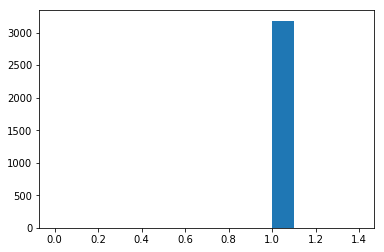